In [1]:
import numpy as np

import matplotlib.colors as mcolors

import matplotlib._color_data as mcd

import networkx as nx
import matplotlib.pyplot as plt
%matplotlib inline

import networkx.algorithms.clique as clq

from termcolor import colored

from itertools import combinations


mcolor = {"red":'\033[31m', "green":'\033[32m', "yellow":'\033[33m', 
          "blue":'\033[34m', "purple":'\033[35m', "cyan":'\033[36m', 
          "lightgrey":'\033[37m', "lightred":'\033[91m', "lightgreen":'\033[92m', 
          "lightblue":'\033[94m'}

dim = 100

thr1 = 0.5
thr2 = 0.5

thrf = 0.5

Smaj = np.empty((dim, dim), dtype=float)
Syear = np.empty((dim, dim), dtype=float)
ax = np.empty((dim, dim), dtype=float)
bx = np.empty((dim, dim), dtype=float)
c = np.empty((dim, dim), dtype=float)
d = np.empty((dim, dim), dtype=float)
e = np.empty((dim, dim), dtype=float)
u = np.empty((dim, dim), dtype=float)

#ax = np.random.rand(dim,dim)

ax = np.random.uniform(low=0.55,high=1,size=(dim,dim))

#bx = np.random.rand(dim,dim)

bx = np.random.uniform(low=0.5,high=1,size=(dim,dim))

i = 0
j = 0

for i in range(0,dim):
    for j in range(i,dim):
        ax[i,j] = "{:.2f}".format(ax[i,j])
        
        if i%15==0 and j%15==0:
            ax[i,j] = 0
        
        ax[j,i] = ax[i,j]
        
        if i==j: 
            ax[i,i] = 1
    
for i in range(0,dim):
    for j in range(i,dim): 
        bx[i,j] = "{:.2f}".format(bx[i,j])
        
        if i%10==0 and j%10==0:
            bx[i,j] = 0
        
        bx[j,i] = bx[i,j]
        
        if i==j: 
            bx[i,i] = 1

Smaj = ax
Syear = bx

Smaj = np.array([[1.  , 0.66, 0.6 , 0.69, 0.86, 0.92, 0.68, 0.78, 0.77, 0.92, 0.66,
       0.83, 0.7 , 0.97, 0.75, 0.  , 0.83, 0.75, 0.63, 0.89, 0.95, 0.86,
       0.98, 0.92, 0.97, 0.66, 0.98, 0.75, 0.6 , 0.68, 0.  , 0.69, 0.55,
       0.58, 0.8 , 0.84, 0.82, 0.71, 0.67, 0.76, 0.77, 0.69, 0.87, 0.66,
       0.75, 0.  , 0.59, 0.64, 0.87, 0.92, 0.82, 0.8 , 0.8 , 0.85, 0.56,
       0.67, 1.  , 0.72, 0.74, 0.91, 0.  , 0.78, 0.71, 0.72, 0.7 , 0.92,
       0.98, 0.59, 0.92, 0.85, 0.56, 0.68, 0.99, 0.64, 0.94, 0.  , 0.6 ,
       0.56, 0.79, 0.65, 1.  , 0.94, 0.87, 0.74, 0.87, 0.64, 0.69, 0.63,
       0.8 , 0.95, 0.  , 0.9 , 0.76, 0.62, 0.84, 0.78, 0.57, 0.62, 0.68,
       0.87], [0.66, 1.  , 0.84, 0.59, 0.75, 0.64, 0.67, 0.61, 0.66, 0.96, 0.58,
       0.82, 0.88, 0.81, 0.61, 0.56, 0.58, 0.81, 0.96, 0.82, 0.96, 0.97,
       0.93, 1.  , 0.65, 1.  , 0.7 , 0.95, 0.68, 0.89, 0.77, 0.89, 0.69,
       0.97, 0.78, 0.65, 0.9 , 0.56, 0.97, 0.86, 0.81, 0.72, 0.92, 0.92,
       0.56, 0.92, 0.94, 0.79, 0.95, 0.99, 0.8 , 0.76, 0.83, 0.73, 0.65,
       0.67, 0.96, 0.96, 0.92, 0.84, 0.69, 0.82, 0.66, 0.6 , 0.86, 0.59,
       0.88, 0.71, 0.59, 0.68, 0.75, 0.66, 0.59, 0.78, 0.7 , 0.88, 0.67,
       1.  , 0.86, 0.82, 0.84, 0.89, 0.87, 0.92, 0.75, 0.66, 0.85, 0.74,
       0.87, 1.  , 0.59, 0.96, 0.95, 0.73, 0.8 , 0.77, 0.94, 0.72, 0.76,
       0.77],[0.6 , 0.84, 1.  , 0.89, 0.74, 0.65, 0.79, 0.55, 0.81, 0.56, 0.55,
       0.77, 0.85, 0.7 , 0.82, 0.63, 0.95, 0.77, 0.87, 0.82, 0.9 , 0.95,
       0.77, 0.86, 0.81, 0.78, 0.75, 0.77, 0.68, 0.9 , 0.95, 0.81, 0.64,
       0.64, 0.92, 0.56, 0.94, 0.6 , 0.75, 0.97, 0.95, 0.61, 0.7 , 0.78,
       0.97, 0.92, 0.6 , 0.78, 0.66, 0.88, 0.74, 0.94, 0.87, 0.76, 0.57,
       0.6 , 0.62, 0.67, 0.79, 0.62, 0.65, 0.81, 0.93, 0.63, 0.78, 0.74,
       0.95, 0.71, 0.76, 0.77, 0.88, 0.61, 0.6 , 0.77, 0.63, 0.97, 0.56,
       0.61, 0.95, 0.87, 0.75, 0.78, 0.77, 0.96, 0.81, 0.89, 0.58, 0.98,
       0.92, 0.92, 0.93, 0.85, 0.85, 0.69, 0.73, 0.57, 0.76, 0.94, 0.99,
       0.73], [0.69, 0.59, 0.89, 1.  , 0.96, 0.95, 0.58, 0.61, 0.8 , 0.79, 0.97,
       0.81, 0.56, 0.86, 0.93, 0.61, 0.79, 0.8 , 0.82, 0.94, 0.94, 0.9 ,
       0.92, 0.56, 0.78, 0.62, 0.92, 0.82, 0.74, 0.98, 0.61, 0.72, 0.92,
       0.75, 0.58, 0.7 , 0.91, 0.57, 0.8 , 0.96, 0.69, 0.88, 0.84, 0.83,
       0.9 , 0.89, 0.99, 0.79, 0.95, 0.84, 0.83, 0.98, 0.73, 0.58, 0.93,
       0.61, 0.59, 0.69, 0.94, 0.7 , 0.99, 0.93, 0.86, 0.58, 0.78, 0.82,
       0.68, 0.79, 0.83, 0.94, 1.  , 0.85, 0.97, 0.7 , 0.6 , 0.87, 0.76,
       0.73, 0.63, 0.8 , 0.96, 0.85, 0.59, 0.98, 0.76, 0.79, 0.69, 0.76,
       0.85, 0.59, 0.69, 0.96, 0.64, 0.9 , 0.65, 0.91, 0.94, 0.7 , 0.97,
       0.97], [0.86, 0.75, 0.74, 0.96, 1.  , 0.64, 0.71, 0.84, 0.78, 0.59, 0.93,
       0.87, 0.6 , 0.63, 0.76, 0.81, 0.85, 0.61, 0.95, 0.97, 0.83, 0.68,
       0.75, 0.55, 0.57, 0.87, 0.64, 0.56, 0.6 , 0.67, 0.96, 0.9 , 0.64,
       0.62, 0.61, 0.59, 0.96, 0.66, 0.87, 0.79, 0.6 , 0.61, 0.67, 0.73,
       0.99, 0.89, 0.71, 0.92, 0.6 , 0.62, 0.73, 0.59, 0.78, 0.85, 0.92,
       0.93, 0.85, 0.56, 0.62, 0.97, 0.57, 0.62, 0.73, 0.66, 0.62, 0.75,
       0.71, 0.68, 0.94, 0.92, 0.69, 0.59, 0.92, 0.68, 0.7 , 0.99, 0.57,
       0.64, 0.76, 0.83, 0.98, 0.94, 0.74, 0.95, 0.93, 0.81, 0.84, 0.74,
       0.6 , 0.57, 0.94, 0.62, 0.56, 0.96, 0.67, 0.58, 0.65, 0.71, 0.97,
       0.65], [0.92, 0.64, 0.65, 0.95, 0.64, 1.  , 0.79, 0.89, 0.62, 0.62, 0.59,
       0.89, 0.74, 0.9 , 0.84, 0.88, 0.78, 0.77, 0.69, 0.64, 0.72, 0.99,
       0.83, 0.7 , 0.77, 0.66, 0.94, 0.63, 0.97, 0.68, 0.81, 0.71, 0.62,
       0.86, 0.66, 0.61, 0.84, 0.68, 0.6 , 0.95, 0.68, 0.63, 0.93, 0.74,
       0.68, 0.83, 0.85, 0.94, 0.86, 0.87, 0.77, 0.98, 0.96, 0.73, 0.95,
       0.77, 0.84, 0.88, 0.75, 0.99, 0.9 , 0.68, 0.64, 0.88, 0.77, 0.59,
       0.98, 0.77, 0.82, 0.69, 0.59, 0.85, 0.74, 0.82, 0.65, 0.58, 0.89,
       0.62, 0.61, 0.96, 0.8 , 0.94, 0.69, 0.56, 0.56, 0.66, 0.98, 0.65,
       0.87, 0.79, 0.72, 0.76, 0.85, 0.95, 0.6 , 0.78, 0.75, 0.92, 0.59,
       0.65], [0.68, 0.67, 0.79, 0.58, 0.71, 0.79, 1.  , 0.61, 0.92, 0.98, 0.59,
       0.63, 0.84, 0.77, 0.83, 1.  , 0.55, 0.86, 0.77, 0.79, 0.78, 0.59,
       0.84, 0.98, 0.76, 0.84, 0.87, 0.95, 0.8 , 0.94, 0.97, 0.56, 1.  ,
       0.61, 0.68, 0.87, 0.72, 0.97, 0.59, 0.7 , 0.84, 0.78, 0.85, 0.8 ,
       0.65, 0.57, 0.61, 0.69, 0.85, 0.73, 0.8 , 0.56, 0.97, 0.83, 0.65,
       0.84, 0.79, 0.98, 0.55, 0.89, 0.6 , 0.99, 0.63, 0.87, 0.56, 0.8 ,
       0.95, 0.95, 0.8 , 0.69, 0.7 , 0.99, 0.58, 0.91, 0.7 , 0.95, 0.8 ,
       0.98, 0.76, 0.7 , 0.74, 0.6 , 1.  , 0.77, 0.88, 0.61, 0.78, 0.88,
       0.94, 0.9 , 0.59, 0.62, 0.56, 0.99, 0.6 , 0.82, 0.74, 0.73, 0.98,
       0.89], [0.78, 0.61, 0.55, 0.61, 0.84, 0.89, 0.61, 1.  , 0.78, 0.77, 0.99,
       0.89, 0.62, 0.62, 0.87, 0.77, 0.93, 0.89, 0.98, 0.65, 0.66, 0.97,
       0.65, 0.96, 0.7 , 0.95, 0.78, 0.69, 0.83, 0.55, 0.64, 0.79, 0.85,
       0.71, 0.78, 0.96, 0.81, 0.75, 0.72, 0.82, 0.99, 0.89, 0.91, 0.84,
       0.65, 0.68, 0.69, 0.89, 0.76, 0.96, 0.9 , 0.9 , 0.84, 0.74, 0.59,
       0.99, 0.78, 0.97, 0.8 , 0.83, 0.88, 0.93, 0.83, 0.58, 0.67, 0.9 ,
       0.76, 0.81, 0.6 , 0.97, 0.72, 0.98, 0.94, 0.7 , 0.77, 0.91, 0.77,
       0.76, 1.  , 0.95, 0.87, 0.92, 0.82, 0.91, 0.97, 0.98, 0.93, 0.7 ,
       0.67, 0.75, 0.64, 0.56, 0.89, 0.91, 0.73, 0.88, 0.93, 0.71, 0.95,
       0.8 ], [0.77, 0.66, 0.81, 0.8 , 0.78, 0.62, 0.92, 0.78, 1.  , 0.92, 0.93,
       0.76, 0.79, 0.56, 0.75, 0.57, 0.63, 0.81, 0.56, 0.77, 0.89, 0.72,
       0.7 , 0.98, 0.63, 0.9 , 0.81, 0.92, 0.85, 0.69, 0.85, 0.6 , 0.68,
       0.95, 0.6 , 0.62, 0.86, 0.97, 0.86, 0.67, 0.99, 0.75, 0.93, 0.93,
       0.91, 0.6 , 1.  , 0.75, 0.9 , 0.88, 0.85, 0.71, 0.89, 0.83, 0.81,
       0.66, 0.74, 0.62, 0.69, 0.97, 0.86, 0.99, 1.  , 0.75, 0.97, 0.87,
       0.75, 0.86, 0.69, 0.7 , 0.88, 0.99, 0.7 , 0.89, 0.86, 0.72, 0.9 ,
       0.59, 0.66, 0.57, 0.76, 0.73, 0.9 , 0.58, 0.75, 0.72, 0.58, 0.84,
       0.8 , 0.81, 0.88, 0.59, 0.76, 0.87, 0.79, 0.73, 0.87, 0.93, 0.55,
       0.76], [0.92, 0.96, 0.56, 0.79, 0.59, 0.62, 0.98, 0.77, 0.92, 1.  , 0.93,
       0.86, 0.57, 0.86, 0.68, 0.61, 0.96, 0.56, 0.98, 0.92, 0.63, 0.66,
       0.7 , 0.73, 0.79, 0.93, 0.65, 0.8 , 0.97, 0.72, 0.94, 1.  , 0.66,
       0.93, 0.7 , 0.66, 0.96, 0.67, 0.99, 0.73, 0.91, 0.78, 0.64, 0.89,
       0.8 , 0.96, 0.88, 0.66, 0.98, 0.59, 0.92, 0.99, 0.86, 0.95, 0.82,
       0.96, 0.9 , 0.69, 0.6 , 0.8 , 0.85, 0.65, 0.88, 0.87, 0.74, 0.74,
       1.  , 0.75, 0.65, 0.59, 0.97, 0.55, 0.62, 0.55, 0.95, 0.76, 0.75,
       0.95, 0.9 , 0.62, 0.56, 0.82, 0.61, 0.89, 0.95, 0.83, 0.84, 0.68,
       0.98, 0.94, 0.87, 0.92, 0.78, 0.83, 0.85, 0.78, 0.83, 0.9 , 0.7 ,
       0.61], [0.66, 0.58, 0.55, 0.97, 0.93, 0.59, 0.59, 0.99, 0.93, 0.93, 1.  ,
       0.97, 0.83, 0.81, 0.95, 0.56, 0.78, 0.85, 0.95, 0.58, 0.8 , 0.8 ,
       0.82, 0.83, 0.57, 0.7 , 0.75, 0.74, 0.98, 0.91, 0.57, 0.82, 0.97,
       0.7 , 0.64, 0.84, 0.94, 0.76, 0.85, 0.76, 0.94, 0.9 , 0.86, 0.8 ,
       0.82, 0.94, 0.93, 0.65, 0.98, 0.96, 0.84, 0.59, 0.96, 0.87, 0.89,
       0.83, 0.62, 0.96, 0.65, 0.8 , 0.97, 0.89, 0.63, 0.94, 0.69, 0.79,
       0.88, 0.56, 0.87, 0.76, 0.93, 0.81, 0.65, 0.63, 0.76, 0.92, 0.75,
       0.9 , 0.95, 0.71, 0.63, 0.92, 0.58, 0.8 , 0.85, 0.9 , 0.72, 0.61,
       0.56, 0.76, 0.87, 0.76, 0.83, 0.92, 0.69, 0.57, 0.93, 0.83, 0.94,
       0.99], [0.83, 0.82, 0.77, 0.81, 0.87, 0.89, 0.63, 0.89, 0.76, 0.86, 0.97,
       1.  , 0.6 , 0.89, 0.98, 0.82, 0.66, 0.6 , 0.65, 0.95, 0.84, 0.96,
       0.86, 0.61, 0.94, 0.71, 0.88, 0.57, 0.83, 0.58, 0.68, 0.61, 0.7 ,
       0.94, 0.56, 0.8 , 0.89, 0.86, 0.56, 0.64, 0.84, 0.58, 0.84, 0.64,
       0.56, 0.9 , 0.97, 0.9 , 0.97, 0.91, 0.98, 0.56, 0.97, 0.79, 0.96,
       0.68, 0.9 , 0.99, 0.87, 0.8 , 0.8 , 0.58, 0.64, 0.71, 0.6 , 0.77,
       0.65, 0.88, 0.86, 0.87, 0.58, 0.66, 0.8 , 0.7 , 0.98, 0.65, 0.92,
       0.57, 0.64, 0.7 , 0.62, 0.76, 0.94, 0.79, 0.95, 0.63, 0.92, 0.77,
       0.71, 0.63, 0.97, 0.78, 0.74, 0.61, 0.97, 0.56, 0.74, 0.91, 0.81,
       0.65], [0.7 , 0.88, 0.85, 0.56, 0.6 , 0.74, 0.84, 0.62, 0.79, 0.57, 0.83,
       0.6 , 1.  , 0.97, 0.71, 0.72, 0.6 , 0.69, 0.86, 0.98, 0.71, 0.58,
       0.61, 0.94, 0.6 , 0.93, 0.58, 0.78, 0.58, 0.66, 0.94, 0.87, 0.92,
       0.65, 0.94, 0.73, 0.6 , 0.73, 0.79, 0.89, 0.7 , 0.9 , 0.66, 0.62,
       0.87, 0.7 , 0.94, 0.97, 0.99, 0.85, 0.92, 0.64, 0.9 , 0.85, 0.95,
       0.58, 0.85, 0.57, 0.87, 0.99, 1.  , 0.88, 0.73, 0.89, 0.91, 0.56,
       0.65, 0.84, 0.85, 0.57, 0.94, 0.56, 0.66, 0.68, 0.56, 0.83, 0.67,
       0.87, 0.84, 0.56, 0.78, 0.6 , 0.57, 0.55, 0.99, 0.96, 0.6 , 0.9 ,
       0.86, 0.97, 0.71, 0.93, 0.78, 0.91, 0.98, 0.61, 0.92, 0.61, 0.83,
       0.93], [0.97, 0.81, 0.7 , 0.86, 0.63, 0.9 , 0.77, 0.62, 0.56, 0.86, 0.81,
       0.89, 0.97, 1.  , 0.76, 0.68, 0.61, 0.7 , 0.84, 0.55, 0.99, 0.67,
       0.85, 0.78, 0.87, 0.95, 0.81, 0.79, 0.71, 0.97, 0.88, 0.98, 0.83,
       0.84, 0.87, 0.63, 0.6 , 0.84, 0.68, 0.71, 0.89, 0.94, 0.94, 0.83,
       0.91, 0.91, 0.61, 0.82, 0.71, 0.82, 0.99, 0.82, 0.78, 0.68, 0.76,
       0.82, 0.83, 0.69, 0.56, 0.68, 0.56, 0.57, 0.59, 0.63, 0.7 , 0.77,
       0.95, 0.86, 0.83, 0.64, 0.78, 0.69, 0.72, 0.7 , 0.67, 0.98, 0.93,
       0.81, 0.89, 0.93, 0.93, 0.57, 0.76, 0.78, 0.97, 0.83, 0.62, 0.95,
       0.99, 0.94, 0.56, 0.77, 0.66, 0.8 , 0.58, 0.97, 0.88, 0.95, 0.64,
       0.58], [0.75, 0.61, 0.82, 0.93, 0.76, 0.84, 0.83, 0.87, 0.75, 0.68, 0.95,
       0.98, 0.71, 0.76, 1.  , 0.56, 0.64, 0.81, 0.66, 0.97, 0.95, 0.74,
       0.68, 0.6 , 0.99, 0.64, 0.72, 0.85, 0.82, 0.81, 0.85, 0.92, 0.99,
       0.67, 0.61, 0.91, 0.57, 0.6 , 0.95, 0.83, 0.89, 0.71, 0.81, 0.93,
       0.93, 0.8 , 0.95, 0.55, 0.65, 0.91, 0.96, 0.69, 0.78, 0.59, 0.81,
       0.59, 0.83, 0.67, 0.85, 0.62, 0.94, 0.71, 0.58, 0.93, 0.56, 0.89,
       0.64, 0.75, 0.67, 0.85, 0.84, 0.75, 0.82, 0.66, 0.99, 1.  , 0.75,
       0.74, 0.57, 0.75, 0.94, 0.9 , 0.98, 0.65, 0.78, 0.55, 0.88, 0.72,
       0.7 , 0.92, 0.75, 0.6 , 0.86, 0.86, 0.6 , 0.78, 0.64, 0.9 , 0.9 ,
       0.56], [0.  , 0.56, 0.63, 0.61, 0.81, 0.88, 1.  , 0.77, 0.57, 0.61, 0.56,
       0.82, 0.72, 0.68, 0.56, 1.  , 0.98, 0.87, 0.8 , 0.78, 0.81, 0.99,
       0.96, 0.83, 0.59, 0.71, 0.92, 0.73, 0.79, 0.58, 0.  , 0.71, 0.83,
       0.8 , 0.83, 0.76, 0.81, 0.59, 0.78, 0.6 , 0.88, 0.98, 0.71, 0.96,
       0.71, 0.  , 0.85, 0.59, 0.57, 0.88, 0.7 , 0.86, 0.84, 0.86, 0.93,
       0.91, 0.73, 0.67, 0.74, 0.65, 0.  , 0.99, 0.81, 0.86, 0.83, 0.56,
       0.76, 0.87, 0.84, 0.7 , 0.58, 0.91, 0.93, 0.7 , 0.92, 0.  , 0.93,
       0.9 , 0.7 , 0.67, 0.71, 0.76, 0.98, 0.6 , 0.61, 0.75, 0.56, 0.71,
       1.  , 0.91, 0.  , 0.75, 0.81, 0.63, 0.85, 0.77, 0.85, 0.95, 0.84,
       0.83], [0.83, 0.58, 0.95, 0.79, 0.85, 0.78, 0.55, 0.93, 0.63, 0.96, 0.78,
       0.66, 0.6 , 0.61, 0.64, 0.98, 1.  , 0.84, 0.96, 0.79, 0.7 , 0.64,
       0.78, 0.59, 0.8 , 0.67, 0.8 , 0.6 , 0.96, 0.57, 0.88, 0.97, 0.96,
       0.97, 0.79, 0.63, 0.95, 0.66, 0.72, 0.68, 0.87, 0.85, 0.87, 0.91,
       0.85, 0.85, 0.84, 0.99, 0.68, 0.69, 0.58, 0.65, 0.59, 0.9 , 0.72,
       0.73, 0.8 , 0.68, 0.79, 0.79, 0.85, 0.84, 0.88, 0.75, 0.78, 0.6 ,
       0.71, 0.68, 0.85, 0.76, 0.71, 0.95, 0.65, 0.73, 0.86, 0.8 , 0.83,
       0.65, 0.85, 0.7 , 0.7 , 0.68, 0.97, 0.56, 0.99, 0.98, 0.84, 0.8 ,
       0.85, 0.6 , 0.61, 0.74, 0.78, 0.55, 0.79, 0.83, 0.75, 0.79, 0.84,
       0.93], [0.75, 0.81, 0.77, 0.8 , 0.61, 0.77, 0.86, 0.89, 0.81, 0.56, 0.85,
       0.6 , 0.69, 0.7 , 0.81, 0.87, 0.84, 1.  , 0.59, 0.75, 0.92, 0.92,
       0.86, 0.58, 0.99, 0.67, 0.91, 0.95, 0.83, 0.67, 0.81, 0.69, 0.72,
       0.7 , 0.65, 0.95, 0.7 , 0.79, 0.91, 0.64, 0.61, 0.74, 0.81, 0.85,
       0.78, 0.61, 0.91, 0.76, 0.61, 0.7 , 0.56, 0.74, 0.96, 0.57, 0.98,
       0.67, 0.82, 0.93, 0.64, 0.89, 0.95, 0.68, 0.79, 0.65, 0.6 , 0.64,
       0.61, 0.62, 0.8 , 0.7 , 0.95, 0.75, 0.55, 0.74, 0.93, 0.97, 0.99,
       0.71, 0.98, 0.6 , 0.87, 0.6 , 0.89, 0.78, 0.97, 0.81, 0.92, 0.63,
       0.75, 0.6 , 0.86, 0.92, 0.76, 0.79, 0.71, 0.64, 0.66, 0.7 , 0.7 ,
       0.87], [0.63, 0.96, 0.87, 0.82, 0.95, 0.69, 0.77, 0.98, 0.56, 0.98, 0.95,
       0.65, 0.86, 0.84, 0.66, 0.8 , 0.96, 0.59, 1.  , 0.86, 0.91, 0.91,
       0.75, 0.69, 0.57, 0.93, 0.89, 0.68, 0.93, 0.83, 0.99, 0.88, 0.78,
       0.65, 0.99, 0.72, 0.58, 0.68, 0.72, 0.77, 0.63, 0.96, 0.71, 0.81,
       0.59, 0.72, 0.81, 0.79, 0.62, 0.67, 0.64, 0.64, 0.89, 0.6 , 0.64,
       0.73, 0.83, 0.63, 0.58, 0.74, 0.66, 0.77, 0.92, 0.81, 0.7 , 0.78,
       0.94, 0.56, 0.82, 0.71, 0.71, 0.65, 0.98, 0.58, 0.57, 0.81, 0.95,
       0.81, 0.84, 0.91, 0.71, 0.99, 0.76, 0.95, 0.98, 0.62, 0.97, 0.76,
       0.94, 0.75, 0.75, 0.75, 0.93, 0.95, 0.59, 0.73, 0.99, 0.85, 0.93,
       0.74], [0.89, 0.82, 0.82, 0.94, 0.97, 0.64, 0.79, 0.65, 0.77, 0.92, 0.58,
       0.95, 0.98, 0.55, 0.97, 0.78, 0.79, 0.75, 0.86, 1.  , 0.89, 0.8 ,
       0.8 , 1.  , 0.65, 0.89, 0.78, 0.64, 0.87, 0.63, 0.58, 0.87, 0.72,
       0.9 , 0.7 , 0.95, 0.59, 0.77, 0.82, 0.96, 0.6 , 0.61, 0.58, 0.65,
       0.94, 0.56, 0.89, 0.66, 0.98, 0.85, 0.79, 0.76, 0.95, 0.95, 0.89,
       0.76, 0.72, 0.71, 0.72, 0.65, 0.83, 1.  , 0.59, 0.99, 0.8 , 0.97,
       0.72, 0.96, 0.99, 0.57, 0.62, 0.7 , 0.87, 0.64, 0.86, 0.89, 0.9 ,
       0.59, 0.65, 0.85, 0.64, 0.99, 0.76, 0.8 , 0.84, 0.84, 0.75, 0.57,
       0.69, 0.97, 0.88, 0.59, 0.57, 0.69, 0.67, 0.72, 0.72, 0.75, 0.62,
       0.75], [0.95, 0.96, 0.9 , 0.94, 0.83, 0.72, 0.78, 0.66, 0.89, 0.63, 0.8 ,
       0.84, 0.71, 0.99, 0.95, 0.81, 0.7 , 0.92, 0.91, 0.89, 1.  , 0.69,
       0.94, 0.78, 0.96, 0.88, 0.71, 0.99, 0.58, 0.86, 0.84, 0.65, 0.82,
       0.8 , 0.69, 0.71, 0.86, 0.85, 0.68, 0.59, 0.71, 0.6 , 0.94, 0.74,
       0.65, 0.91, 0.68, 0.61, 0.96, 0.8 , 0.85, 0.97, 0.79, 0.69, 0.91,
       0.75, 0.55, 0.98, 0.74, 0.56, 0.67, 0.93, 0.81, 0.74, 0.56, 0.77,
       0.78, 0.76, 0.66, 0.83, 0.94, 0.61, 0.65, 0.65, 0.97, 0.99, 0.76,
       0.64, 0.89, 0.69, 0.66, 0.77, 0.74, 0.75, 0.62, 0.85, 0.58, 0.75,
       0.65, 0.59, 0.63, 0.63, 0.78, 0.88, 0.8 , 0.63, 0.68, 0.57, 0.89,
       0.82], [0.86, 0.97, 0.95, 0.9 , 0.68, 0.99, 0.59, 0.97, 0.72, 0.66, 0.8 ,
       0.96, 0.58, 0.67, 0.74, 0.99, 0.64, 0.92, 0.91, 0.8 , 0.69, 1.  ,
       0.96, 0.96, 0.58, 0.7 , 0.9 , 0.61, 0.68, 0.94, 0.82, 0.64, 0.73,
       0.6 , 0.66, 0.87, 0.92, 0.73, 0.62, 0.55, 0.92, 0.84, 0.93, 0.75,
       0.57, 0.56, 0.72, 0.74, 0.63, 0.78, 0.94, 0.62, 0.56, 0.77, 0.82,
       0.99, 0.59, 0.67, 0.59, 0.74, 0.85, 0.77, 0.6 , 0.76, 0.88, 0.98,
       0.72, 0.63, 0.84, 0.95, 0.9 , 0.98, 0.61, 0.58, 0.83, 0.59, 0.78,
       0.85, 0.6 , 0.79, 0.8 , 0.63, 0.83, 0.57, 0.56, 0.58, 0.86, 0.8 ,
       0.7 , 0.61, 0.97, 0.94, 0.83, 0.84, 0.66, 0.58, 0.77, 0.67, 0.79,
       0.9 ], [0.98, 0.93, 0.77, 0.92, 0.75, 0.83, 0.84, 0.65, 0.7 , 0.7 , 0.82,
       0.86, 0.61, 0.85, 0.68, 0.96, 0.78, 0.86, 0.75, 0.8 , 0.94, 0.96,
       1.  , 0.62, 0.91, 0.76, 0.88, 0.97, 0.63, 1.  , 0.57, 0.88, 0.88,
       0.86, 0.92, 0.74, 0.84, 0.94, 0.97, 0.9 , 0.87, 0.65, 0.99, 0.81,
       0.86, 0.8 , 0.97, 0.65, 0.61, 0.79, 0.82, 0.91, 0.58, 0.76, 0.63,
       0.62, 0.77, 0.98, 0.94, 0.75, 0.95, 0.72, 0.94, 0.92, 0.9 , 0.68,
       0.85, 0.74, 0.8 , 0.79, 0.79, 0.78, 0.92, 0.86, 0.6 , 0.69, 0.68,
       0.9 , 0.74, 0.55, 0.78, 0.96, 0.94, 0.86, 0.56, 0.69, 0.79, 0.77,
       0.61, 0.57, 0.88, 0.96, 0.77, 0.75, 1.  , 0.87, 0.58, 0.63, 0.91,
       0.87], [0.92, 1.  , 0.86, 0.56, 0.55, 0.7 , 0.98, 0.96, 0.98, 0.73, 0.83,
       0.61, 0.94, 0.78, 0.6 , 0.83, 0.59, 0.58, 0.69, 1.  , 0.78, 0.96,
       0.62, 1.  , 0.91, 0.67, 0.69, 0.83, 0.61, 0.72, 0.95, 0.9 , 0.74,
       0.85, 0.86, 0.93, 0.99, 0.7 , 0.69, 0.77, 0.74, 0.83, 0.64, 0.75,
       0.89, 0.56, 0.66, 0.98, 0.98, 0.79, 0.87, 0.76, 0.63, 0.89, 0.72,
       0.64, 0.96, 0.96, 0.6 , 0.91, 0.81, 0.73, 0.77, 0.96, 0.81, 0.88,
       0.81, 0.56, 0.86, 0.86, 0.58, 0.92, 0.68, 0.66, 0.73, 0.61, 0.81,
       0.99, 0.89, 0.64, 0.8 , 0.81, 0.8 , 0.57, 0.65, 0.87, 0.64, 0.61,
       0.7 , 0.89, 0.58, 0.85, 0.92, 0.67, 0.68, 0.87, 0.56, 0.75, 0.82,
       0.57], [0.97, 0.65, 0.81, 0.78, 0.57, 0.77, 0.76, 0.7 , 0.63, 0.79, 0.57,
       0.94, 0.6 , 0.87, 0.99, 0.59, 0.8 , 0.99, 0.57, 0.65, 0.96, 0.58,
       0.91, 0.91, 1.  , 0.86, 0.7 , 0.94, 0.6 , 0.57, 0.94, 0.84, 0.82,
       0.99, 0.61, 0.96, 0.86, 0.68, 0.73, 0.72, 0.89, 0.64, 0.6 , 0.91,
       0.67, 0.87, 0.97, 0.86, 0.96, 0.68, 0.87, 0.66, 0.74, 0.97, 0.59,
       0.71, 1.  , 0.71, 0.75, 0.74, 0.94, 0.91, 0.78, 0.71, 0.67, 0.69,
       0.62, 0.74, 0.79, 0.68, 0.69, 0.83, 0.98, 0.81, 0.86, 0.61, 0.98,
       0.92, 0.85, 0.78, 0.8 , 0.59, 0.92, 0.88, 0.9 , 0.75, 0.84, 0.69,
       0.94, 0.95, 0.93, 0.83, 0.56, 0.73, 0.59, 0.6 , 0.91, 0.72, 0.68,
       0.88], [0.66, 1.  , 0.78, 0.62, 0.87, 0.66, 0.84, 0.95, 0.9 , 0.93, 0.7 ,
       0.71, 0.93, 0.95, 0.64, 0.71, 0.67, 0.67, 0.93, 0.89, 0.88, 0.7 ,
       0.76, 0.67, 0.86, 1.  , 0.95, 0.95, 0.91, 0.64, 0.67, 0.63, 0.9 ,
       0.77, 0.83, 0.94, 0.83, 0.64, 0.83, 0.58, 0.84, 0.87, 0.62, 0.96,
       0.57, 0.95, 0.98, 0.62, 0.58, 0.97, 0.93, 0.71, 0.89, 0.71, 0.87,
       0.56, 0.78, 0.76, 0.64, 0.68, 0.73, 0.59, 0.88, 0.97, 0.95, 0.74,
       0.94, 0.99, 0.77, 0.65, 0.66, 0.57, 0.67, 0.84, 0.98, 0.82, 0.72,
       0.65, 0.75, 0.62, 0.6 , 0.9 , 0.82, 0.6 , 0.66, 0.92, 0.64, 0.72,
       0.89, 0.62, 0.79, 0.85, 0.92, 0.92, 0.76, 0.98, 0.94, 0.76, 0.87,
       0.8 ], [0.98, 0.7 , 0.75, 0.92, 0.64, 0.94, 0.87, 0.78, 0.81, 0.65, 0.75,
       0.88, 0.58, 0.81, 0.72, 0.92, 0.8 , 0.91, 0.89, 0.78, 0.71, 0.9 ,
       0.88, 0.69, 0.7 , 0.95, 1.  , 0.68, 0.74, 0.86, 0.85, 0.89, 0.79,
       0.75, 0.78, 0.86, 0.73, 0.6 , 0.95, 0.65, 0.63, 0.85, 0.57, 0.57,
       0.9 , 0.89, 0.84, 0.66, 0.57, 0.86, 0.72, 0.64, 0.55, 0.82, 0.67,
       0.81, 0.76, 0.84, 0.6 , 0.91, 1.  , 0.66, 0.62, 0.74, 0.6 , 0.98,
       0.7 , 0.8 , 0.74, 0.76, 0.8 , 0.99, 0.91, 0.62, 0.98, 0.66, 0.88,
       0.96, 0.68, 0.85, 0.89, 0.87, 0.7 , 0.66, 0.83, 0.91, 0.68, 0.91,
       0.6 , 0.83, 0.94, 0.94, 0.83, 1.  , 0.95, 0.79, 0.96, 0.81, 0.57,
       0.59], [0.75, 0.95, 0.77, 0.82, 0.56, 0.63, 0.95, 0.69, 0.92, 0.8 , 0.74,
       0.57, 0.78, 0.79, 0.85, 0.73, 0.6 , 0.95, 0.68, 0.64, 0.99, 0.61,
       0.97, 0.83, 0.94, 0.95, 0.68, 1.  , 0.63, 0.67, 0.99, 0.57, 0.92,
       0.72, 0.82, 0.83, 1.  , 0.78, 0.68, 0.87, 0.67, 0.74, 0.97, 0.68,
       0.76, 0.85, 0.83, 0.83, 0.8 , 0.94, 0.67, 0.9 , 0.88, 0.73, 0.97,
       0.97, 0.75, 0.97, 0.77, 0.95, 0.75, 0.6 , 0.8 , 0.93, 0.92, 0.7 ,
       0.93, 0.88, 0.69, 0.59, 0.99, 0.59, 0.92, 0.89, 0.94, 0.61, 0.92,
       0.73, 0.94, 0.95, 0.97, 0.86, 0.7 , 0.95, 0.56, 0.95, 0.64, 0.73,
       0.86, 0.71, 0.87, 0.84, 0.87, 0.89, 0.69, 0.93, 0.99, 0.91, 0.81,
       1.  ], [0.6 , 0.68, 0.68, 0.74, 0.6 , 0.97, 0.8 , 0.83, 0.85, 0.97, 0.98,
       0.83, 0.58, 0.71, 0.82, 0.79, 0.96, 0.83, 0.93, 0.87, 0.58, 0.68,
       0.63, 0.61, 0.6 , 0.91, 0.74, 0.63, 1.  , 0.58, 0.58, 0.79, 0.97,
       0.74, 0.66, 0.93, 0.78, 0.65, 0.69, 0.71, 0.75, 0.92, 0.57, 0.75,
       0.85, 0.79, 0.84, 0.73, 0.87, 0.83, 0.73, 0.59, 0.66, 0.74, 0.83,
       0.61, 0.87, 0.56, 0.69, 0.88, 0.63, 0.7 , 0.57, 0.87, 0.63, 0.99,
       0.66, 0.95, 0.91, 0.95, 0.66, 0.74, 0.9 , 0.96, 0.93, 0.57, 0.99,
       0.99, 0.72, 0.62, 0.68, 0.55, 0.79, 0.72, 0.79, 0.69, 0.87, 0.62,
       0.58, 0.86, 0.93, 0.67, 0.56, 0.97, 0.61, 0.74, 0.89, 0.98, 0.6 ,
       0.69], [0.68, 0.89, 0.9 , 0.98, 0.67, 0.68, 0.94, 0.55, 0.69, 0.72, 0.91,
       0.58, 0.66, 0.97, 0.81, 0.58, 0.57, 0.67, 0.83, 0.63, 0.86, 0.94,
       1.  , 0.72, 0.57, 0.64, 0.86, 0.67, 0.58, 1.  , 0.91, 0.86, 0.86,
       0.77, 0.68, 0.81, 0.83, 0.57, 0.63, 0.66, 0.7 , 0.88, 0.94, 0.73,
       0.74, 0.71, 0.89, 0.74, 0.96, 0.83, 0.75, 0.61, 0.73, 0.68, 0.97,
       0.67, 0.56, 0.87, 0.88, 0.95, 0.6 , 0.76, 0.99, 0.7 , 0.66, 0.89,
       0.61, 0.61, 0.9 , 0.6 , 0.97, 0.69, 0.83, 0.62, 0.67, 0.89, 1.  ,
       0.8 , 0.64, 0.64, 0.97, 0.8 , 0.69, 0.67, 0.59, 0.68, 0.95, 0.99,
       0.56, 0.99, 0.66, 0.73, 0.82, 0.64, 0.85, 0.82, 0.58, 0.79, 0.63,
       0.85], [0.  , 0.77, 0.95, 0.61, 0.96, 0.81, 0.97, 0.64, 0.85, 0.94, 0.57,
       0.68, 0.94, 0.88, 0.85, 0.  , 0.88, 0.81, 0.99, 0.58, 0.84, 0.82,
       0.57, 0.95, 0.94, 0.67, 0.85, 0.99, 0.58, 0.91, 1.  , 0.8 , 0.93,
       0.97, 0.68, 0.89, 0.62, 0.82, 0.85, 0.92, 0.67, 0.91, 0.74, 0.8 ,
       1.  , 0.  , 0.86, 0.88, 0.97, 0.62, 0.79, 0.57, 0.87, 0.65, 0.89,
       0.67, 0.63, 0.86, 0.95, 0.83, 0.  , 0.99, 0.88, 0.94, 0.96, 0.85,
       0.95, 0.78, 0.64, 0.97, 0.76, 0.98, 0.99, 0.94, 0.78, 0.  , 0.97,
       0.91, 0.78, 0.94, 0.71, 0.89, 0.97, 0.83, 0.79, 0.83, 0.64, 0.73,
       0.64, 0.71, 0.  , 0.83, 0.96, 0.99, 0.84, 0.71, 0.83, 0.99, 0.94,
       0.65], [0.69, 0.89, 0.81, 0.72, 0.9 , 0.71, 0.56, 0.79, 0.6 , 1.  , 0.82,
       0.61, 0.87, 0.98, 0.92, 0.71, 0.97, 0.69, 0.88, 0.87, 0.65, 0.64,
       0.88, 0.9 , 0.84, 0.63, 0.89, 0.57, 0.79, 0.86, 0.8 , 1.  , 0.97,
       0.7 , 0.7 , 0.95, 0.76, 0.58, 0.78, 0.95, 0.96, 0.93, 0.56, 0.88,
       0.92, 0.58, 0.97, 0.61, 0.83, 0.69, 0.73, 0.77, 0.94, 0.84, 0.75,
       0.61, 0.92, 0.79, 0.64, 0.56, 0.83, 0.68, 0.65, 0.83, 0.65, 0.64,
       0.6 , 0.87, 0.78, 0.67, 0.57, 0.98, 0.81, 0.82, 0.81, 0.8 , 0.82,
       0.8 , 0.67, 0.82, 0.86, 0.61, 0.93, 0.68, 0.84, 0.82, 0.98, 0.91,
       0.58, 0.96, 0.59, 1.  , 0.61, 0.7 , 0.81, 0.61, 0.67, 0.88, 0.91,
       0.71], [0.55, 0.69, 0.64, 0.92, 0.64, 0.62, 1.  , 0.85, 0.68, 0.66, 0.97,
       0.7 , 0.92, 0.83, 0.99, 0.83, 0.96, 0.72, 0.78, 0.72, 0.82, 0.73,
       0.88, 0.74, 0.82, 0.9 , 0.79, 0.92, 0.97, 0.86, 0.93, 0.97, 1.  ,
       0.9 , 1.  , 0.55, 0.95, 0.98, 0.89, 0.86, 0.96, 0.63, 0.84, 0.64,
       0.58, 0.72, 0.69, 0.81, 0.81, 0.86, 0.75, 0.78, 0.69, 0.76, 0.88,
       0.65, 0.86, 0.61, 0.91, 0.77, 0.68, 0.81, 0.63, 0.75, 0.88, 0.71,
       0.76, 0.56, 0.96, 0.76, 0.6 , 0.64, 0.68, 0.73, 0.89, 0.58, 0.98,
       0.92, 0.9 , 0.95, 0.95, 0.85, 0.8 , 0.97, 0.74, 0.69, 0.67, 0.78,
       0.81, 0.99, 0.74, 0.69, 0.85, 0.56, 0.91, 0.75, 0.63, 0.57, 0.89,
       0.63], [0.58, 0.97, 0.64, 0.75, 0.62, 0.86, 0.61, 0.71, 0.95, 0.93, 0.7 ,
       0.94, 0.65, 0.84, 0.67, 0.8 , 0.97, 0.7 , 0.65, 0.9 , 0.8 , 0.6 ,
       0.86, 0.85, 0.99, 0.77, 0.75, 0.72, 0.74, 0.77, 0.97, 0.7 , 0.9 ,
       1.  , 0.81, 0.85, 0.73, 0.77, 0.78, 0.76, 0.62, 0.76, 0.71, 0.94,
       0.75, 0.87, 0.89, 0.7 , 0.7 , 0.94, 0.89, 0.97, 0.65, 0.63, 0.82,
       0.89, 0.98, 0.71, 0.65, 0.99, 0.56, 0.89, 0.98, 0.6 , 0.57, 0.61,
       0.7 , 0.99, 0.92, 0.82, 0.83, 0.86, 0.74, 0.85, 0.71, 0.73, 0.82,
       0.68, 0.89, 0.68, 0.68, 0.63, 0.88, 0.85, 0.81, 0.71, 0.6 , 0.83,
       0.95, 0.63, 0.72, 0.99, 0.58, 0.99, 0.62, 0.88, 0.92, 0.79, 0.62,
       0.6 ], [0.8 , 0.78, 0.92, 0.58, 0.61, 0.66, 0.68, 0.78, 0.6 , 0.7 , 0.64,
       0.56, 0.94, 0.87, 0.61, 0.83, 0.79, 0.65, 0.99, 0.7 , 0.69, 0.66,
       0.92, 0.86, 0.61, 0.83, 0.78, 0.82, 0.66, 0.68, 0.68, 0.7 , 1.  ,
       0.81, 1.  , 0.96, 0.78, 0.56, 0.74, 0.7 , 0.75, 0.72, 0.64, 0.99,
       0.96, 0.65, 0.87, 0.75, 0.84, 0.56, 0.94, 0.93, 0.81, 0.98, 0.77,
       0.98, 0.62, 0.98, 0.98, 0.74, 0.92, 0.93, 0.76, 0.7 , 0.89, 0.82,
       0.88, 0.91, 0.66, 0.91, 0.93, 0.74, 0.6 , 0.82, 0.66, 0.66, 0.91,
       0.88, 0.8 , 0.68, 0.74, 0.63, 0.95, 0.9 , 0.96, 0.7 , 0.79, 0.73,
       0.55, 0.98, 0.73, 0.94, 0.76, 0.82, 0.83, 0.95, 0.75, 0.62, 0.93,
       0.71], [0.84, 0.65, 0.56, 0.7 , 0.59, 0.61, 0.87, 0.96, 0.62, 0.66, 0.84,
       0.8 , 0.73, 0.63, 0.91, 0.76, 0.63, 0.95, 0.72, 0.95, 0.71, 0.87,
       0.74, 0.93, 0.96, 0.94, 0.86, 0.83, 0.93, 0.81, 0.89, 0.95, 0.55,
       0.85, 0.96, 1.  , 0.91, 0.64, 0.94, 0.57, 0.97, 0.65, 0.96, 0.66,
       0.68, 0.95, 0.89, 0.71, 0.59, 0.75, 0.65, 0.9 , 0.55, 0.64, 0.81,
       0.68, 0.76, 0.6 , 0.81, 0.83, 0.62, 0.71, 0.59, 0.63, 0.95, 0.87,
       0.68, 0.86, 0.88, 0.76, 0.81, 0.85, 0.86, 1.  , 0.61, 0.77, 0.71,
       0.73, 0.56, 0.59, 0.86, 0.99, 0.96, 0.55, 0.85, 0.73, 0.98, 0.81,
       0.79, 0.68, 0.83, 0.94, 0.84, 0.62, 0.83, 0.75, 0.74, 0.7 , 0.62,
       0.81], [0.82, 0.9 , 0.94, 0.91, 0.96, 0.84, 0.72, 0.81, 0.86, 0.96, 0.94,
       0.89, 0.6 , 0.6 , 0.57, 0.81, 0.95, 0.7 , 0.58, 0.59, 0.86, 0.92,
       0.84, 0.99, 0.86, 0.83, 0.73, 1.  , 0.78, 0.83, 0.62, 0.76, 0.95,
       0.73, 0.78, 0.91, 1.  , 0.56, 0.85, 0.69, 0.78, 0.58, 0.58, 0.62,
       0.69, 0.92, 0.67, 0.65, 0.73, 0.66, 0.86, 0.79, 0.58, 0.69, 0.66,
       0.93, 0.56, 0.63, 0.76, 0.79, 0.82, 0.73, 0.65, 0.95, 0.73, 0.72,
       0.91, 0.86, 0.71, 0.87, 0.65, 0.75, 0.58, 0.97, 0.91, 0.7 , 1.  ,
       0.92, 0.59, 0.71, 0.6 , 0.81, 0.72, 0.99, 0.99, 0.9 , 0.94, 0.96,
       0.95, 0.99, 0.88, 0.69, 0.69, 0.6 , 0.85, 0.57, 0.72, 0.84, 0.89,
       0.94], [0.71, 0.56, 0.6 , 0.57, 0.66, 0.68, 0.97, 0.75, 0.97, 0.67, 0.76,
       0.86, 0.73, 0.84, 0.6 , 0.59, 0.66, 0.79, 0.68, 0.77, 0.85, 0.73,
       0.94, 0.7 , 0.68, 0.64, 0.6 , 0.78, 0.65, 0.57, 0.82, 0.58, 0.98,
       0.77, 0.56, 0.64, 0.56, 1.  , 0.62, 0.77, 0.68, 0.6 , 0.83, 0.92,
       0.94, 0.74, 0.97, 0.87, 0.72, 0.72, 0.88, 0.62, 0.69, 0.92, 0.72,
       0.57, 0.83, 0.96, 0.61, 0.77, 0.79, 0.83, 0.68, 0.7 , 0.58, 0.99,
       0.66, 0.56, 0.65, 0.68, 0.92, 0.94, 0.85, 0.91, 0.72, 0.69, 0.61,
       0.95, 0.71, 0.57, 0.86, 0.88, 0.76, 0.96, 0.59, 0.58, 0.71, 0.82,
       0.82, 0.96, 0.74, 0.65, 0.75, 0.69, 0.63, 0.62, 0.88, 0.75, 0.79,
       0.89], [0.67, 0.97, 0.75, 0.8 , 0.87, 0.6 , 0.59, 0.72, 0.86, 0.99, 0.85,
       0.56, 0.79, 0.68, 0.95, 0.78, 0.72, 0.91, 0.72, 0.82, 0.68, 0.62,
       0.97, 0.69, 0.73, 0.83, 0.95, 0.68, 0.69, 0.63, 0.85, 0.78, 0.89,
       0.78, 0.74, 0.94, 0.85, 0.62, 1.  , 0.59, 0.81, 0.67, 0.99, 0.6 ,
       0.67, 0.61, 0.86, 0.71, 0.58, 0.7 , 0.85, 0.65, 0.65, 0.69, 0.75,
       0.72, 0.7 , 0.56, 0.71, 0.91, 0.58, 0.81, 0.74, 0.79, 0.59, 0.56,
       0.74, 0.67, 0.76, 0.84, 0.84, 0.62, 0.68, 0.93, 0.69, 0.85, 0.97,
       0.64, 0.75, 0.84, 0.56, 0.77, 0.64, 0.59, 0.64, 0.82, 0.72, 0.66,
       0.73, 0.77, 0.6 , 0.6 , 0.69, 0.98, 0.73, 0.91, 0.68, 0.89, 0.92,
       0.57], [0.76, 0.86, 0.97, 0.96, 0.79, 0.95, 0.7 , 0.82, 0.67, 0.73, 0.76,
       0.64, 0.89, 0.71, 0.83, 0.6 , 0.68, 0.64, 0.77, 0.96, 0.59, 0.55,
       0.9 , 0.77, 0.72, 0.58, 0.65, 0.87, 0.71, 0.66, 0.92, 0.95, 0.86,
       0.76, 0.7 , 0.57, 0.69, 0.77, 0.59, 1.  , 0.62, 0.86, 0.93, 0.69,
       0.63, 0.64, 0.89, 0.92, 0.61, 0.7 , 0.94, 0.87, 0.58, 0.93, 0.98,
       0.98, 0.7 , 0.87, 0.59, 0.74, 0.85, 0.6 , 0.92, 0.82, 0.69, 0.76,
       0.58, 0.76, 0.55, 0.74, 0.62, 0.71, 0.87, 0.59, 0.75, 0.67, 0.57,
       0.9 , 0.67, 0.89, 0.87, 0.63, 0.75, 0.99, 0.77, 0.74, 0.79, 0.94,
       0.84, 0.87, 0.59, 0.85, 0.66, 0.59, 0.6 , 0.67, 0.99, 0.56, 0.99,
       0.87], [0.77, 0.81, 0.95, 0.69, 0.6 , 0.68, 0.84, 0.99, 0.99, 0.91, 0.94,
       0.84, 0.7 , 0.89, 0.89, 0.88, 0.87, 0.61, 0.63, 0.6 , 0.71, 0.92,
       0.87, 0.74, 0.89, 0.84, 0.63, 0.67, 0.75, 0.7 , 0.67, 0.96, 0.96,
       0.62, 0.75, 0.97, 0.78, 0.68, 0.81, 0.62, 1.  , 0.56, 0.84, 0.74,
       0.7 , 0.97, 0.81, 0.77, 0.81, 0.76, 0.93, 0.83, 0.55, 0.74, 0.96,
       0.65, 0.68, 0.62, 0.8 , 0.79, 0.57, 1.  , 0.92, 0.97, 0.83, 0.8 ,
       0.97, 0.56, 0.89, 0.74, 0.95, 0.99, 0.68, 0.83, 0.66, 0.94, 0.57,
       0.56, 0.81, 0.77, 0.55, 0.86, 0.68, 0.58, 0.89, 0.81, 0.95, 0.85,
       0.67, 0.84, 0.91, 0.8 , 0.94, 0.67, 0.98, 0.87, 0.8 , 0.97, 0.77,
       0.89], [0.69, 0.72, 0.61, 0.88, 0.61, 0.63, 0.78, 0.89, 0.75, 0.78, 0.9 ,
       0.58, 0.9 , 0.94, 0.71, 0.98, 0.85, 0.74, 0.96, 0.61, 0.6 , 0.84,
       0.65, 0.83, 0.64, 0.87, 0.85, 0.74, 0.92, 0.88, 0.91, 0.93, 0.63,
       0.76, 0.72, 0.65, 0.58, 0.6 , 0.67, 0.86, 0.56, 1.  , 0.75, 0.74,
       0.98, 0.78, 0.8 , 0.88, 0.91, 0.96, 0.67, 0.63, 0.89, 0.71, 0.79,
       0.88, 0.81, 0.93, 0.83, 0.55, 0.73, 0.77, 0.98, 0.75, 0.99, 0.78,
       0.68, 0.88, 0.87, 0.71, 0.95, 0.59, 0.96, 0.92, 0.58, 0.57, 0.82,
       0.97, 0.68, 0.6 , 0.77, 0.81, 0.73, 0.95, 0.89, 0.73, 0.72, 0.61,
       0.93, 0.74, 0.7 , 0.72, 0.71, 0.68, 0.89, 0.55, 0.64, 0.56, 0.77,
       0.88], [0.87, 0.92, 0.7 , 0.84, 0.67, 0.93, 0.85, 0.91, 0.93, 0.64, 0.86,
       0.84, 0.66, 0.94, 0.81, 0.71, 0.87, 0.81, 0.71, 0.58, 0.94, 0.93,
       0.99, 0.64, 0.6 , 0.62, 0.57, 0.97, 0.57, 0.94, 0.74, 0.56, 0.84,
       0.71, 0.64, 0.96, 0.58, 0.83, 0.99, 0.93, 0.84, 0.75, 1.  , 0.65,
       0.98, 0.66, 0.77, 0.85, 0.98, 0.93, 0.7 , 0.73, 0.7 , 0.96, 0.8 ,
       0.75, 0.59, 0.68, 0.61, 0.97, 0.7 , 0.71, 0.82, 0.69, 0.99, 0.67,
       0.63, 0.61, 0.61, 0.6 , 0.92, 0.83, 0.8 , 0.98, 0.86, 0.82, 0.66,
       0.85, 0.93, 0.87, 0.84, 1.  , 0.82, 0.94, 0.89, 0.57, 0.86, 0.57,
       0.7 , 0.91, 0.77, 0.81, 0.98, 0.82, 0.85, 0.71, 0.66, 0.8 , 0.56,
       0.83], [0.66, 0.92, 0.78, 0.83, 0.73, 0.74, 0.8 , 0.84, 0.93, 0.89, 0.8 ,
       0.64, 0.62, 0.83, 0.93, 0.96, 0.91, 0.85, 0.81, 0.65, 0.74, 0.75,
       0.81, 0.75, 0.91, 0.96, 0.57, 0.68, 0.75, 0.73, 0.8 , 0.88, 0.64,
       0.94, 0.99, 0.66, 0.62, 0.92, 0.6 , 0.69, 0.74, 0.74, 0.65, 1.  ,
       0.6 , 0.72, 0.81, 0.66, 0.87, 0.9 , 0.65, 0.79, 0.98, 0.57, 0.61,
       0.85, 0.63, 0.78, 0.55, 0.6 , 0.76, 0.76, 0.67, 0.75, 0.57, 0.77,
       0.97, 0.7 , 0.98, 0.86, 0.96, 0.96, 0.56, 0.75, 0.91, 0.94, 0.81,
       0.56, 0.71, 0.61, 0.57, 0.64, 0.97, 0.83, 0.88, 0.72, 0.77, 0.71,
       0.8 , 0.92, 0.59, 0.6 , 0.83, 0.79, 1.  , 0.72, 0.91, 0.84, 0.66,
       0.83], [0.75, 0.56, 0.97, 0.9 , 0.99, 0.68, 0.65, 0.65, 0.91, 0.8 , 0.82,
       0.56, 0.87, 0.91, 0.93, 0.71, 0.85, 0.78, 0.59, 0.94, 0.65, 0.57,
       0.86, 0.89, 0.67, 0.57, 0.9 , 0.76, 0.85, 0.74, 1.  , 0.92, 0.58,
       0.75, 0.96, 0.68, 0.69, 0.94, 0.67, 0.63, 0.7 , 0.98, 0.98, 0.6 ,
       1.  , 0.75, 0.89, 0.88, 0.92, 0.65, 0.86, 0.93, 0.62, 0.95, 0.79,
       0.59, 0.73, 0.93, 0.57, 0.56, 0.83, 0.56, 0.88, 0.58, 0.77, 0.88,
       0.73, 0.85, 0.83, 0.91, 0.78, 0.71, 0.96, 0.6 , 0.74, 0.8 , 0.82,
       0.58, 0.59, 0.61, 0.9 , 0.56, 0.6 , 0.87, 0.65, 0.68, 0.95, 0.56,
       0.95, 0.68, 0.86, 0.92, 0.76, 0.92, 0.61, 0.61, 0.65, 0.55, 0.71,
       0.73], [0.  , 0.92, 0.92, 0.89, 0.89, 0.83, 0.57, 0.68, 0.6 , 0.96, 0.94,
       0.9 , 0.7 , 0.91, 0.8 , 0.  , 0.85, 0.61, 0.72, 0.56, 0.91, 0.56,
       0.8 , 0.56, 0.87, 0.95, 0.89, 0.85, 0.79, 0.71, 0.  , 0.58, 0.72,
       0.87, 0.65, 0.95, 0.92, 0.74, 0.61, 0.64, 0.97, 0.78, 0.66, 0.72,
       0.75, 1.  , 0.98, 0.85, 0.58, 0.62, 0.77, 0.59, 0.57, 0.89, 0.56,
       0.8 , 0.76, 1.  , 0.98, 0.69, 0.  , 0.67, 0.69, 0.91, 0.82, 0.57,
       0.85, 0.94, 0.81, 0.86, 0.84, 0.65, 0.93, 0.72, 0.81, 0.  , 0.86,
       0.59, 0.6 , 0.63, 0.73, 0.6 , 0.56, 0.61, 0.77, 0.57, 0.58, 0.8 ,
       0.97, 0.88, 0.  , 0.77, 0.69, 0.96, 0.65, 0.63, 0.82, 0.71, 0.88,
       0.95], [0.59, 0.94, 0.6 , 0.99, 0.71, 0.85, 0.61, 0.69, 1.  , 0.88, 0.93,
       0.97, 0.94, 0.61, 0.95, 0.85, 0.84, 0.91, 0.81, 0.89, 0.68, 0.72,
       0.97, 0.66, 0.97, 0.98, 0.84, 0.83, 0.84, 0.89, 0.86, 0.97, 0.69,
       0.89, 0.87, 0.89, 0.67, 0.97, 0.86, 0.89, 0.81, 0.8 , 0.77, 0.81,
       0.89, 0.98, 1.  , 0.73, 0.83, 0.8 , 0.86, 0.89, 0.77, 0.62, 0.85,
       0.83, 0.91, 0.73, 0.6 , 0.68, 0.75, 0.65, 0.85, 0.79, 0.96, 0.98,
       0.65, 0.71, 0.87, 0.64, 0.95, 0.77, 0.77, 0.82, 0.82, 0.92, 0.95,
       0.82, 0.79, 0.73, 0.73, 0.75, 0.91, 0.77, 0.8 , 0.99, 0.71, 0.79,
       0.75, 0.76, 0.61, 0.83, 0.67, 0.86, 0.65, 0.56, 0.77, 1.  , 0.75,
       0.56], [0.64, 0.79, 0.78, 0.79, 0.92, 0.94, 0.69, 0.89, 0.75, 0.66, 0.65,
       0.9 , 0.97, 0.82, 0.55, 0.59, 0.99, 0.76, 0.79, 0.66, 0.61, 0.74,
       0.65, 0.98, 0.86, 0.62, 0.66, 0.83, 0.73, 0.74, 0.88, 0.61, 0.81,
       0.7 , 0.75, 0.71, 0.65, 0.87, 0.71, 0.92, 0.77, 0.88, 0.85, 0.66,
       0.88, 0.85, 0.73, 1.  , 0.67, 0.57, 0.76, 0.94, 0.7 , 0.71, 0.73,
       0.69, 0.99, 0.93, 0.72, 0.85, 0.74, 0.7 , 0.78, 0.79, 0.75, 0.96,
       0.68, 0.66, 0.84, 0.97, 0.59, 0.61, 0.66, 0.84, 0.8 , 0.9 , 0.76,
       0.99, 0.98, 0.58, 0.58, 0.91, 0.58, 0.88, 0.85, 0.82, 0.56, 0.84,
       0.77, 0.91, 0.97, 0.9 , 0.71, 0.86, 0.82, 0.72, 0.99, 0.88, 0.78,
       0.77], [0.87, 0.95, 0.66, 0.95, 0.6 , 0.86, 0.85, 0.76, 0.9 , 0.98, 0.98,
       0.97, 0.99, 0.71, 0.65, 0.57, 0.68, 0.61, 0.62, 0.98, 0.96, 0.63,
       0.61, 0.98, 0.96, 0.58, 0.57, 0.8 , 0.87, 0.96, 0.97, 0.83, 0.81,
       0.7 , 0.84, 0.59, 0.73, 0.72, 0.58, 0.61, 0.81, 0.91, 0.98, 0.87,
       0.92, 0.58, 0.83, 0.67, 1.  , 0.56, 0.68, 0.64, 0.67, 0.67, 0.7 ,
       0.88, 0.8 , 0.63, 0.56, 0.7 , 0.67, 0.59, 0.89, 0.69, 0.99, 0.88,
       0.8 , 0.99, 0.68, 0.8 , 0.62, 0.9 , 0.6 , 0.84, 0.85, 0.91, 0.66,
       0.57, 0.84, 0.56, 0.97, 0.88, 0.8 , 0.79, 0.81, 0.59, 0.98, 0.81,
       0.67, 0.84, 0.67, 0.8 , 0.76, 0.6 , 0.59, 0.61, 0.75, 0.76, 0.57,
       0.91], [0.92, 0.99, 0.88, 0.84, 0.62, 0.87, 0.73, 0.96, 0.88, 0.59, 0.96,
       0.91, 0.85, 0.82, 0.91, 0.88, 0.69, 0.7 , 0.67, 0.85, 0.8 , 0.78,
       0.79, 0.79, 0.68, 0.97, 0.86, 0.94, 0.83, 0.83, 0.62, 0.69, 0.86,
       0.94, 0.56, 0.75, 0.66, 0.72, 0.7 , 0.7 , 0.76, 0.96, 0.93, 0.9 ,
       0.65, 0.62, 0.8 , 0.57, 0.56, 1.  , 0.93, 0.62, 1.  , 0.9 , 0.96,
       1.  , 0.81, 0.86, 0.94, 0.62, 0.55, 0.85, 0.79, 0.78, 0.58, 0.85,
       0.75, 0.9 , 0.59, 0.68, 0.81, 0.92, 0.6 , 0.72, 0.77, 0.87, 0.85,
       0.91, 0.87, 0.88, 0.87, 0.97, 0.73, 0.77, 0.57, 0.96, 0.6 , 0.61,
       0.72, 0.93, 0.95, 0.91, 0.75, 0.59, 0.62, 0.79, 0.62, 0.76, 0.97,
       0.75], [0.82, 0.8 , 0.74, 0.83, 0.73, 0.77, 0.8 , 0.9 , 0.85, 0.92, 0.84,
       0.98, 0.92, 0.99, 0.96, 0.7 , 0.58, 0.56, 0.64, 0.79, 0.85, 0.94,
       0.82, 0.87, 0.87, 0.93, 0.72, 0.67, 0.73, 0.75, 0.79, 0.73, 0.75,
       0.89, 0.94, 0.65, 0.86, 0.88, 0.85, 0.94, 0.93, 0.67, 0.7 , 0.65,
       0.86, 0.77, 0.86, 0.76, 0.68, 0.93, 1.  , 0.76, 0.9 , 0.76, 0.95,
       0.58, 0.7 , 0.57, 0.81, 0.59, 0.93, 0.86, 0.78, 0.57, 0.61, 0.62,
       0.61, 0.61, 0.64, 0.75, 0.64, 1.  , 0.96, 0.6 , 0.68, 0.85, 0.67,
       0.61, 0.84, 0.93, 0.89, 0.97, 0.98, 0.56, 0.79, 0.94, 0.96, 0.98,
       0.92, 0.75, 0.85, 0.74, 0.76, 0.78, 0.91, 0.86, 0.8 , 0.68, 0.79,
       0.82], [0.8 , 0.76, 0.94, 0.98, 0.59, 0.98, 0.56, 0.9 , 0.71, 0.99, 0.59,
       0.56, 0.64, 0.82, 0.69, 0.86, 0.65, 0.74, 0.64, 0.76, 0.97, 0.62,
       0.91, 0.76, 0.66, 0.71, 0.64, 0.9 , 0.59, 0.61, 0.57, 0.77, 0.78,
       0.97, 0.93, 0.9 , 0.79, 0.62, 0.65, 0.87, 0.83, 0.63, 0.73, 0.79,
       0.93, 0.59, 0.89, 0.94, 0.64, 0.62, 0.76, 1.  , 0.92, 0.65, 0.94,
       0.8 , 0.77, 0.81, 0.61, 0.62, 0.6 , 0.68, 0.97, 0.6 , 0.93, 0.86,
       0.73, 0.77, 0.94, 0.92, 0.89, 0.72, 0.78, 0.77, 0.81, 0.59, 0.84,
       0.9 , 0.86, 0.98, 0.89, 0.92, 0.94, 0.93, 0.62, 0.93, 0.57, 0.68,
       0.86, 0.72, 0.63, 0.97, 0.57, 0.76, 0.76, 0.58, 0.86, 0.74, 0.62,
       0.82], [0.8 , 0.83, 0.87, 0.73, 0.78, 0.96, 0.97, 0.84, 0.89, 0.86, 0.96,
       0.97, 0.9 , 0.78, 0.78, 0.84, 0.59, 0.96, 0.89, 0.95, 0.79, 0.56,
       0.58, 0.63, 0.74, 0.89, 0.55, 0.88, 0.66, 0.73, 0.87, 0.94, 0.69,
       0.65, 0.81, 0.55, 0.58, 0.69, 0.65, 0.58, 0.55, 0.89, 0.7 , 0.98,
       0.62, 0.57, 0.77, 0.7 , 0.67, 1.  , 0.9 , 0.92, 1.  , 0.72, 0.88,
       0.57, 0.92, 0.99, 0.56, 0.8 , 0.92, 0.63, 0.98, 0.94, 0.84, 0.93,
       0.93, 0.74, 0.59, 0.76, 0.72, 0.81, 0.58, 0.66, 0.57, 0.71, 0.71,
       0.71, 0.69, 0.92, 0.69, 0.7 , 0.78, 0.99, 0.76, 0.99, 0.99, 0.72,
       0.87, 1.  , 0.89, 0.79, 0.6 , 0.79, 0.96, 0.7 , 0.88, 0.88, 0.94,
       0.71], [0.85, 0.73, 0.76, 0.58, 0.85, 0.73, 0.83, 0.74, 0.83, 0.95, 0.87,
       0.79, 0.85, 0.68, 0.59, 0.86, 0.9 , 0.57, 0.6 , 0.95, 0.69, 0.77,
       0.76, 0.89, 0.97, 0.71, 0.82, 0.73, 0.74, 0.68, 0.65, 0.84, 0.76,
       0.63, 0.98, 0.64, 0.69, 0.92, 0.69, 0.93, 0.74, 0.71, 0.96, 0.57,
       0.95, 0.89, 0.62, 0.71, 0.67, 0.9 , 0.76, 0.65, 0.72, 1.  , 0.96,
       0.73, 0.85, 0.94, 0.79, 0.73, 0.57, 0.57, 0.64, 0.69, 0.84, 0.88,
       0.71, 0.89, 0.89, 0.87, 0.59, 0.9 , 0.68, 0.55, 0.83, 0.9 , 0.94,
       0.92, 0.58, 0.7 , 0.85, 0.86, 0.68, 0.68, 0.82, 0.69, 0.73, 0.92,
       0.75, 0.72, 0.75, 0.69, 0.85, 0.97, 0.89, 0.73, 0.66, 0.61, 0.9 ,
       0.79], [0.56, 0.65, 0.57, 0.93, 0.92, 0.95, 0.65, 0.59, 0.81, 0.82, 0.89,
       0.96, 0.95, 0.76, 0.81, 0.93, 0.72, 0.98, 0.64, 0.89, 0.91, 0.82,
       0.63, 0.72, 0.59, 0.87, 0.67, 0.97, 0.83, 0.97, 0.89, 0.75, 0.88,
       0.82, 0.77, 0.81, 0.66, 0.72, 0.75, 0.98, 0.96, 0.79, 0.8 , 0.61,
       0.79, 0.56, 0.85, 0.73, 0.7 , 0.96, 0.95, 0.94, 0.88, 0.96, 1.  ,
       0.63, 0.97, 0.97, 0.78, 0.86, 0.78, 0.9 , 0.91, 0.78, 0.88, 0.59,
       1.  , 0.82, 0.58, 0.61, 0.78, 0.72, 0.95, 0.97, 0.79, 0.84, 0.82,
       0.9 , 0.65, 0.66, 0.58, 0.61, 0.55, 0.93, 0.61, 0.71, 0.7 , 0.88,
       0.73, 0.95, 0.74, 0.66, 0.99, 0.7 , 0.66, 0.84, 0.65, 0.58, 0.96,
       0.87], [0.67, 0.67, 0.6 , 0.61, 0.93, 0.77, 0.84, 0.99, 0.66, 0.96, 0.83,
       0.68, 0.58, 0.82, 0.59, 0.91, 0.73, 0.67, 0.73, 0.76, 0.75, 0.99,
       0.62, 0.64, 0.71, 0.56, 0.81, 0.97, 0.61, 0.67, 0.67, 0.61, 0.65,
       0.89, 0.98, 0.68, 0.93, 0.57, 0.72, 0.98, 0.65, 0.88, 0.75, 0.85,
       0.59, 0.8 , 0.83, 0.69, 0.88, 1.  , 0.58, 0.8 , 0.57, 0.73, 0.63,
       1.  , 0.64, 0.62, 0.98, 0.98, 0.58, 0.76, 0.84, 0.81, 0.99, 0.57,
       0.65, 0.79, 0.75, 0.7 , 0.87, 0.81, 0.77, 0.69, 0.96, 0.71, 0.64,
       0.58, 0.69, 0.67, 0.71, 0.78, 0.84, 0.67, 0.71, 0.78, 0.92, 0.66,
       0.56, 0.91, 0.59, 0.91, 0.8 , 0.89, 0.69, 0.88, 0.7 , 0.67, 0.99,
       0.63], [1.  , 0.96, 0.62, 0.59, 0.85, 0.84, 0.79, 0.78, 0.74, 0.9 , 0.62,
       0.9 , 0.85, 0.83, 0.83, 0.73, 0.8 , 0.82, 0.83, 0.72, 0.55, 0.59,
       0.77, 0.96, 1.  , 0.78, 0.76, 0.75, 0.87, 0.56, 0.63, 0.92, 0.86,
       0.98, 0.62, 0.76, 0.56, 0.83, 0.7 , 0.7 , 0.68, 0.81, 0.59, 0.63,
       0.73, 0.76, 0.91, 0.99, 0.8 , 0.81, 0.7 , 0.77, 0.92, 0.85, 0.97,
       0.64, 1.  , 0.7 , 0.83, 0.59, 0.79, 0.81, 0.8 , 0.74, 0.71, 0.83,
       0.61, 0.75, 0.62, 0.74, 0.6 , 0.85, 0.58, 0.95, 0.56, 0.89, 0.65,
       0.94, 0.94, 0.58, 0.93, 0.91, 0.62, 0.7 , 0.81, 0.87, 0.56, 0.87,
       0.57, 0.77, 0.89, 0.99, 0.56, 0.91, 0.81, 0.74, 0.73, 0.94, 0.6 ,
       1.  ], [0.72, 0.96, 0.67, 0.69, 0.56, 0.88, 0.98, 0.97, 0.62, 0.69, 0.96,
       0.99, 0.57, 0.69, 0.67, 0.67, 0.68, 0.93, 0.63, 0.71, 0.98, 0.67,
       0.98, 0.96, 0.71, 0.76, 0.84, 0.97, 0.56, 0.87, 0.86, 0.79, 0.61,
       0.71, 0.98, 0.6 , 0.63, 0.96, 0.56, 0.87, 0.62, 0.93, 0.68, 0.78,
       0.93, 1.  , 0.73, 0.93, 0.63, 0.86, 0.57, 0.81, 0.99, 0.94, 0.97,
       0.62, 0.7 , 1.  , 0.91, 0.76, 0.98, 0.57, 0.81, 0.69, 0.98, 0.59,
       0.72, 0.57, 0.83, 0.7 , 0.72, 0.82, 0.6 , 0.6 , 0.66, 0.68, 0.58,
       0.7 , 0.56, 0.58, 0.64, 0.68, 0.65, 0.89, 0.64, 0.93, 0.75, 0.9 ,
       0.82, 0.55, 0.64, 0.83, 0.69, 0.68, 0.97, 0.57, 0.83, 0.62, 0.67,
       0.72], [0.74, 0.92, 0.79, 0.94, 0.62, 0.75, 0.55, 0.8 , 0.69, 0.6 , 0.65,
       0.87, 0.87, 0.56, 0.85, 0.74, 0.79, 0.64, 0.58, 0.72, 0.74, 0.59,
       0.94, 0.6 , 0.75, 0.64, 0.6 , 0.77, 0.69, 0.88, 0.95, 0.64, 0.91,
       0.65, 0.98, 0.81, 0.76, 0.61, 0.71, 0.59, 0.8 , 0.83, 0.61, 0.55,
       0.57, 0.98, 0.6 , 0.72, 0.56, 0.94, 0.81, 0.61, 0.56, 0.79, 0.78,
       0.98, 0.83, 0.91, 1.  , 0.89, 0.72, 0.84, 0.98, 0.68, 0.87, 0.93,
       0.6 , 0.71, 0.79, 0.6 , 0.81, 0.97, 0.73, 0.84, 0.72, 0.77, 0.82,
       0.63, 0.74, 0.68, 0.65, 0.63, 0.87, 0.91, 0.96, 0.81, 0.87, 0.97,
       0.82, 0.7 , 0.85, 0.67, 0.92, 0.72, 0.68, 0.71, 0.58, 0.98, 0.57,
       0.7 ], [0.91, 0.84, 0.62, 0.7 , 0.97, 0.99, 0.89, 0.83, 0.97, 0.8 , 0.8 ,
       0.8 , 0.99, 0.68, 0.62, 0.65, 0.79, 0.89, 0.74, 0.65, 0.56, 0.74,
       0.75, 0.91, 0.74, 0.68, 0.91, 0.95, 0.88, 0.95, 0.83, 0.56, 0.77,
       0.99, 0.74, 0.83, 0.79, 0.77, 0.91, 0.74, 0.79, 0.55, 0.97, 0.6 ,
       0.56, 0.69, 0.68, 0.85, 0.7 , 0.62, 0.59, 0.62, 0.8 , 0.73, 0.86,
       0.98, 0.59, 0.76, 0.89, 1.  , 0.77, 0.77, 0.67, 0.82, 0.98, 0.93,
       0.81, 0.93, 0.6 , 0.83, 0.64, 0.84, 0.74, 0.91, 0.9 , 0.63, 0.74,
       0.88, 0.58, 0.66, 0.72, 0.98, 0.89, 0.93, 0.65, 0.75, 0.64, 0.94,
       0.8 , 0.55, 0.64, 0.73, 0.8 , 0.98, 0.73, 0.56, 0.68, 0.72, 0.7 ,
       0.58], [0.  , 0.69, 0.65, 0.99, 0.57, 0.9 , 0.6 , 0.88, 0.86, 0.85, 0.97,
       0.8 , 1.  , 0.56, 0.94, 0.  , 0.85, 0.95, 0.66, 0.83, 0.67, 0.85,
       0.95, 0.81, 0.94, 0.73, 1.  , 0.75, 0.63, 0.6 , 0.  , 0.83, 0.68,
       0.56, 0.92, 0.62, 0.82, 0.79, 0.58, 0.85, 0.57, 0.73, 0.7 , 0.76,
       0.83, 0.  , 0.75, 0.74, 0.67, 0.55, 0.93, 0.6 , 0.92, 0.57, 0.78,
       0.58, 0.79, 0.98, 0.72, 0.77, 1.  , 0.59, 0.85, 0.93, 0.93, 0.65,
       0.6 , 0.99, 0.91, 0.64, 0.9 , 0.81, 0.59, 0.97, 0.73, 0.  , 0.8 ,
       0.66, 0.67, 0.67, 0.96, 0.83, 0.97, 0.75, 0.59, 0.73, 0.58, 0.65,
       0.78, 0.69, 0.  , 0.56, 0.85, 0.87, 0.67, 0.98, 0.86, 0.97, 0.67,
       0.95], [0.78, 0.82, 0.81, 0.93, 0.62, 0.68, 0.99, 0.93, 0.99, 0.65, 0.89,
       0.58, 0.88, 0.57, 0.71, 0.99, 0.84, 0.68, 0.77, 1.  , 0.93, 0.77,
       0.72, 0.73, 0.91, 0.59, 0.66, 0.6 , 0.7 , 0.76, 0.99, 0.68, 0.81,
       0.89, 0.93, 0.71, 0.73, 0.83, 0.81, 0.6 , 1.  , 0.77, 0.71, 0.76,
       0.56, 0.67, 0.65, 0.7 , 0.59, 0.85, 0.86, 0.68, 0.63, 0.57, 0.9 ,
       0.76, 0.81, 0.57, 0.84, 0.77, 0.59, 1.  , 0.93, 0.7 , 0.97, 0.71,
       0.66, 0.69, 0.73, 0.6 , 0.98, 0.81, 0.91, 0.68, 0.59, 0.9 , 0.95,
       0.75, 0.76, 0.83, 0.86, 0.81, 0.89, 0.6 , 0.92, 0.58, 0.82, 0.79,
       0.61, 0.76, 0.9 , 0.56, 0.63, 0.77, 0.93, 0.87, 0.74, 0.62, 0.77,
       0.59], [0.71, 0.66, 0.93, 0.86, 0.73, 0.64, 0.63, 0.83, 1.  , 0.88, 0.63,
       0.64, 0.73, 0.59, 0.58, 0.81, 0.88, 0.79, 0.92, 0.59, 0.81, 0.6 ,
       0.94, 0.77, 0.78, 0.88, 0.62, 0.8 , 0.57, 0.99, 0.88, 0.65, 0.63,
       0.98, 0.76, 0.59, 0.65, 0.68, 0.74, 0.92, 0.92, 0.98, 0.82, 0.67,
       0.88, 0.69, 0.85, 0.78, 0.89, 0.79, 0.78, 0.97, 0.98, 0.64, 0.91,
       0.84, 0.8 , 0.81, 0.98, 0.67, 0.85, 0.93, 1.  , 0.89, 0.66, 0.77,
       0.75, 0.87, 1.  , 0.81, 0.85, 0.65, 0.98, 0.99, 0.82, 0.95, 0.88,
       0.91, 0.7 , 0.79, 0.97, 0.95, 0.79, 0.85, 0.68, 0.96, 0.56, 0.57,
       0.81, 0.64, 0.89, 0.69, 0.71, 0.65, 0.97, 0.74, 0.92, 0.59, 0.9 ,
       0.57], [0.72, 0.6 , 0.63, 0.58, 0.66, 0.88, 0.87, 0.58, 0.75, 0.87, 0.94,
       0.71, 0.89, 0.63, 0.93, 0.86, 0.75, 0.65, 0.81, 0.99, 0.74, 0.76,
       0.92, 0.96, 0.71, 0.97, 0.74, 0.93, 0.87, 0.7 , 0.94, 0.83, 0.75,
       0.6 , 0.7 , 0.63, 0.95, 0.7 , 0.79, 0.82, 0.97, 0.75, 0.69, 0.75,
       0.58, 0.91, 0.79, 0.79, 0.69, 0.78, 0.57, 0.6 , 0.94, 0.69, 0.78,
       0.81, 0.74, 0.69, 0.68, 0.82, 0.93, 0.7 , 0.89, 1.  , 0.94, 0.56,
       0.7 , 0.72, 0.84, 0.63, 0.77, 0.85, 0.71, 0.89, 0.73, 0.58, 0.93,
       0.88, 0.83, 0.6 , 0.89, 0.59, 0.65, 0.97, 0.84, 0.6 , 0.79, 0.8 ,
       0.85, 0.59, 0.63, 0.64, 0.81, 0.58, 0.87, 0.85, 0.84, 1.  , 0.84,
       0.58], [0.7 , 0.86, 0.78, 0.78, 0.62, 0.77, 0.56, 0.67, 0.97, 0.74, 0.69,
       0.6 , 0.91, 0.7 , 0.56, 0.83, 0.78, 0.6 , 0.7 , 0.8 , 0.56, 0.88,
       0.9 , 0.81, 0.67, 0.95, 0.6 , 0.92, 0.63, 0.66, 0.96, 0.65, 0.88,
       0.57, 0.89, 0.95, 0.73, 0.58, 0.59, 0.69, 0.83, 0.99, 0.99, 0.57,
       0.77, 0.82, 0.96, 0.75, 0.99, 0.58, 0.61, 0.93, 0.84, 0.84, 0.88,
       0.99, 0.71, 0.98, 0.87, 0.98, 0.93, 0.97, 0.66, 0.94, 1.  , 0.85,
       0.82, 0.85, 0.6 , 0.84, 0.86, 0.64, 0.66, 0.78, 0.8 , 0.9 , 0.9 ,
       0.66, 0.91, 0.98, 0.88, 0.72, 0.74, 0.77, 0.73, 0.97, 0.92, 0.73,
       0.99, 0.59, 0.86, 0.79, 0.64, 0.99, 0.63, 0.7 , 0.76, 0.71, 0.57,
       0.63], [0.92, 0.59, 0.74, 0.82, 0.75, 0.59, 0.8 , 0.9 , 0.87, 0.74, 0.79,
       0.77, 0.56, 0.77, 0.89, 0.56, 0.6 , 0.64, 0.78, 0.97, 0.77, 0.98,
       0.68, 0.88, 0.69, 0.74, 0.98, 0.7 , 0.99, 0.89, 0.85, 0.64, 0.71,
       0.61, 0.82, 0.87, 0.72, 0.99, 0.56, 0.76, 0.8 , 0.78, 0.67, 0.77,
       0.88, 0.57, 0.98, 0.96, 0.88, 0.85, 0.62, 0.86, 0.93, 0.88, 0.59,
       0.57, 0.83, 0.59, 0.93, 0.93, 0.65, 0.71, 0.77, 0.56, 0.85, 1.  ,
       0.65, 0.96, 0.65, 0.57, 0.73, 0.69, 0.67, 0.56, 0.73, 0.77, 0.66,
       0.92, 1.  , 0.93, 0.56, 0.58, 0.71, 0.71, 0.78, 0.55, 0.94, 0.89,
       0.71, 0.93, 1.  , 0.56, 0.71, 0.84, 0.9 , 0.72, 0.74, 0.99, 0.78,
       0.74], [0.98, 0.88, 0.95, 0.68, 0.71, 0.98, 0.95, 0.76, 0.75, 1.  , 0.88,
       0.65, 0.65, 0.95, 0.64, 0.76, 0.71, 0.61, 0.94, 0.72, 0.78, 0.72,
       0.85, 0.81, 0.62, 0.94, 0.7 , 0.93, 0.66, 0.61, 0.95, 0.6 , 0.76,
       0.7 , 0.88, 0.68, 0.91, 0.66, 0.74, 0.58, 0.97, 0.68, 0.63, 0.97,
       0.73, 0.85, 0.65, 0.68, 0.8 , 0.75, 0.61, 0.73, 0.93, 0.71, 1.  ,
       0.65, 0.61, 0.72, 0.6 , 0.81, 0.6 , 0.66, 0.75, 0.7 , 0.82, 0.65,
       1.  , 0.77, 0.99, 0.63, 0.64, 0.75, 0.91, 0.71, 0.61, 0.62, 0.57,
       0.59, 0.96, 0.77, 0.65, 0.65, 0.83, 0.76, 0.65, 0.58, 0.96, 0.59,
       0.74, 0.63, 0.85, 0.56, 0.99, 0.91, 0.68, 0.58, 0.82, 0.7 , 0.67,
       0.81], [0.59, 0.71, 0.71, 0.79, 0.68, 0.77, 0.95, 0.81, 0.86, 0.75, 0.56,
       0.88, 0.84, 0.86, 0.75, 0.87, 0.68, 0.62, 0.56, 0.96, 0.76, 0.63,
       0.74, 0.56, 0.74, 0.99, 0.8 , 0.88, 0.95, 0.61, 0.78, 0.87, 0.56,
       0.99, 0.91, 0.86, 0.86, 0.56, 0.67, 0.76, 0.56, 0.88, 0.61, 0.7 ,
       0.85, 0.94, 0.71, 0.66, 0.99, 0.9 , 0.61, 0.77, 0.74, 0.89, 0.82,
       0.79, 0.75, 0.57, 0.71, 0.93, 0.99, 0.69, 0.87, 0.72, 0.85, 0.96,
       0.77, 1.  , 0.64, 0.94, 0.96, 0.87, 0.93, 0.98, 0.91, 0.84, 0.75,
       0.79, 0.73, 0.84, 0.74, 0.76, 0.74, 0.97, 0.82, 0.68, 0.87, 0.95,
       0.6 , 0.7 , 0.6 , 0.92, 0.85, 0.59, 0.76, 0.7 , 0.77, 0.7 , 0.95,
       0.57], [0.92, 0.59, 0.76, 0.83, 0.94, 0.82, 0.8 , 0.6 , 0.69, 0.65, 0.87,
       0.86, 0.85, 0.83, 0.67, 0.84, 0.85, 0.8 , 0.82, 0.99, 0.66, 0.84,
       0.8 , 0.86, 0.79, 0.77, 0.74, 0.69, 0.91, 0.9 , 0.64, 0.78, 0.96,
       0.92, 0.66, 0.88, 0.71, 0.65, 0.76, 0.55, 0.89, 0.87, 0.61, 0.98,
       0.83, 0.81, 0.87, 0.84, 0.68, 0.59, 0.64, 0.94, 0.59, 0.89, 0.58,
       0.75, 0.62, 0.83, 0.79, 0.6 , 0.91, 0.73, 1.  , 0.84, 0.6 , 0.65,
       0.99, 0.64, 1.  , 0.69, 0.79, 0.78, 0.71, 0.61, 0.84, 1.  , 0.6 ,
       0.64, 0.97, 0.74, 0.63, 0.65, 0.98, 0.85, 0.82, 0.76, 0.81, 0.55,
       0.82, 0.69, 0.71, 0.64, 0.72, 0.76, 0.57, 0.56, 0.83, 0.8 , 0.69,
       0.68], [0.85, 0.68, 0.77, 0.94, 0.92, 0.69, 0.69, 0.97, 0.7 , 0.59, 0.76,
       0.87, 0.57, 0.64, 0.85, 0.7 , 0.76, 0.7 , 0.71, 0.57, 0.83, 0.95,
       0.79, 0.86, 0.68, 0.65, 0.76, 0.59, 0.95, 0.6 , 0.97, 0.67, 0.76,
       0.82, 0.91, 0.76, 0.87, 0.68, 0.84, 0.74, 0.74, 0.71, 0.6 , 0.86,
       0.91, 0.86, 0.64, 0.97, 0.8 , 0.68, 0.75, 0.92, 0.76, 0.87, 0.61,
       0.7 , 0.74, 0.7 , 0.6 , 0.83, 0.64, 0.6 , 0.81, 0.63, 0.84, 0.57,
       0.63, 0.94, 0.69, 1.  , 0.78, 0.82, 0.64, 0.98, 0.71, 0.9 , 0.84,
       0.68, 0.93, 0.78, 0.93, 0.88, 0.77, 0.79, 0.63, 0.65, 0.55, 0.77,
       0.6 , 0.65, 0.58, 0.9 , 0.97, 0.85, 0.69, 0.65, 1.  , 0.9 , 0.73,
       0.85], [0.56, 0.75, 0.88, 1.  , 0.69, 0.59, 0.7 , 0.72, 0.88, 0.97, 0.93,
       0.58, 0.94, 0.78, 0.84, 0.58, 0.71, 0.95, 0.71, 0.62, 0.94, 0.9 ,
       0.79, 0.58, 0.69, 0.66, 0.8 , 0.99, 0.66, 0.97, 0.76, 0.57, 0.6 ,
       0.83, 0.93, 0.81, 0.65, 0.92, 0.84, 0.62, 0.95, 0.95, 0.92, 0.96,
       0.78, 0.84, 0.95, 0.59, 0.62, 0.81, 0.64, 0.89, 0.72, 0.59, 0.78,
       0.87, 0.6 , 0.72, 0.81, 0.64, 0.9 , 0.98, 0.85, 0.77, 0.86, 0.73,
       0.64, 0.96, 0.79, 0.78, 1.  , 0.83, 0.59, 0.96, 0.78, 0.86, 0.68,
       0.91, 0.61, 0.96, 0.72, 0.94, 0.57, 0.9 , 0.73, 0.61, 0.72, 0.92,
       0.82, 0.59, 0.75, 0.62, 0.57, 0.78, 0.85, 0.57, 0.92, 0.65, 0.88,
       0.94], [0.68, 0.66, 0.61, 0.85, 0.59, 0.85, 0.99, 0.98, 0.99, 0.55, 0.81,
       0.66, 0.56, 0.69, 0.75, 0.91, 0.95, 0.75, 0.65, 0.7 , 0.61, 0.98,
       0.78, 0.92, 0.83, 0.57, 0.99, 0.59, 0.74, 0.69, 0.98, 0.98, 0.64,
       0.86, 0.74, 0.85, 0.75, 0.94, 0.62, 0.71, 0.99, 0.59, 0.83, 0.96,
       0.71, 0.65, 0.77, 0.61, 0.9 , 0.92, 1.  , 0.72, 0.81, 0.9 , 0.72,
       0.81, 0.85, 0.82, 0.97, 0.84, 0.81, 0.81, 0.65, 0.85, 0.64, 0.69,
       0.75, 0.87, 0.78, 0.82, 0.83, 1.  , 0.56, 0.58, 0.91, 0.88, 0.56,
       0.73, 0.57, 0.63, 0.57, 0.72, 0.77, 0.72, 0.88, 0.91, 0.61, 0.75,
       0.86, 0.57, 0.84, 0.78, 0.85, 0.71, 0.69, 0.86, 0.95, 0.79, 0.64,
       0.68], [0.99, 0.59, 0.6 , 0.97, 0.92, 0.74, 0.58, 0.94, 0.7 , 0.62, 0.65,
       0.8 , 0.66, 0.72, 0.82, 0.93, 0.65, 0.55, 0.98, 0.87, 0.65, 0.61,
       0.92, 0.68, 0.98, 0.67, 0.91, 0.92, 0.9 , 0.83, 0.99, 0.81, 0.68,
       0.74, 0.6 , 0.86, 0.58, 0.85, 0.68, 0.87, 0.68, 0.96, 0.8 , 0.56,
       0.96, 0.93, 0.77, 0.66, 0.6 , 0.6 , 0.96, 0.78, 0.58, 0.68, 0.95,
       0.77, 0.58, 0.6 , 0.73, 0.74, 0.59, 0.91, 0.98, 0.71, 0.66, 0.67,
       0.91, 0.93, 0.71, 0.64, 0.59, 0.56, 1.  , 0.7 , 0.97, 0.9 , 0.84,
       0.75, 0.95, 0.97, 0.78, 0.75, 0.56, 0.85, 0.81, 0.93, 0.86, 0.92,
       0.9 , 0.86, 0.66, 0.73, 0.81, 0.67, 0.86, 0.67, 0.87, 0.95, 0.97,
       0.8 ], [0.64, 0.78, 0.77, 0.7 , 0.68, 0.82, 0.91, 0.7 , 0.89, 0.55, 0.63,
       0.7 , 0.68, 0.7 , 0.66, 0.7 , 0.73, 0.74, 0.58, 0.64, 0.65, 0.58,
       0.86, 0.66, 0.81, 0.84, 0.62, 0.89, 0.96, 0.62, 0.94, 0.82, 0.73,
       0.85, 0.82, 1.  , 0.97, 0.91, 0.93, 0.59, 0.83, 0.92, 0.98, 0.75,
       0.6 , 0.72, 0.82, 0.84, 0.84, 0.72, 0.6 , 0.77, 0.66, 0.55, 0.97,
       0.69, 0.95, 0.6 , 0.84, 0.91, 0.97, 0.68, 0.99, 0.89, 0.78, 0.56,
       0.71, 0.98, 0.61, 0.98, 0.96, 0.58, 0.7 , 1.  , 0.83, 0.75, 0.86,
       0.99, 0.88, 0.61, 0.86, 0.57, 0.98, 0.63, 0.72, 0.85, 0.74, 0.75,
       0.66, 0.82, 0.72, 0.62, 0.92, 0.55, 0.95, 0.71, 0.64, 0.99, 0.68,
       0.59], [0.94, 0.7 , 0.63, 0.6 , 0.7 , 0.65, 0.7 , 0.77, 0.86, 0.95, 0.76,
       0.98, 0.56, 0.67, 0.99, 0.92, 0.86, 0.93, 0.57, 0.86, 0.97, 0.83,
       0.6 , 0.73, 0.86, 0.98, 0.98, 0.94, 0.93, 0.67, 0.78, 0.81, 0.89,
       0.71, 0.66, 0.61, 0.91, 0.72, 0.69, 0.75, 0.66, 0.58, 0.86, 0.91,
       0.74, 0.81, 0.82, 0.8 , 0.85, 0.77, 0.68, 0.81, 0.57, 0.83, 0.79,
       0.96, 0.56, 0.66, 0.72, 0.9 , 0.73, 0.59, 0.82, 0.73, 0.8 , 0.73,
       0.61, 0.91, 0.84, 0.71, 0.78, 0.91, 0.97, 0.83, 1.  , 0.76, 0.99,
       0.9 , 0.62, 0.88, 0.59, 0.94, 0.92, 0.61, 0.69, 0.73, 0.87, 0.79,
       0.62, 0.67, 0.85, 0.78, 0.66, 0.98, 0.79, 0.57, 0.96, 0.98, 0.85,
       0.65], [0.  , 0.88, 0.97, 0.87, 0.99, 0.58, 0.95, 0.91, 0.72, 0.76, 0.92,
       0.65, 0.83, 0.98, 1.  , 0.  , 0.8 , 0.97, 0.81, 0.89, 0.99, 0.59,
       0.69, 0.61, 0.61, 0.82, 0.66, 0.61, 0.57, 0.89, 0.  , 0.8 , 0.58,
       0.73, 0.66, 0.77, 0.7 , 0.69, 0.85, 0.67, 0.94, 0.57, 0.82, 0.94,
       0.8 , 0.  , 0.92, 0.9 , 0.91, 0.87, 0.85, 0.59, 0.71, 0.9 , 0.84,
       0.71, 0.89, 0.68, 0.77, 0.63, 0.  , 0.9 , 0.95, 0.58, 0.9 , 0.77,
       0.62, 0.84, 1.  , 0.9 , 0.86, 0.88, 0.9 , 0.75, 0.76, 1.  , 0.78,
       0.95, 0.82, 0.72, 0.57, 0.69, 0.79, 0.98, 0.56, 0.79, 0.88, 0.96,
       0.58, 0.56, 0.  , 0.88, 0.83, 0.88, 0.99, 0.9 , 0.89, 0.85, 0.99,
       0.79], [0.6 , 0.67, 0.56, 0.76, 0.57, 0.89, 0.8 , 0.77, 0.9 , 0.75, 0.75,
       0.92, 0.67, 0.93, 0.75, 0.93, 0.83, 0.99, 0.95, 0.9 , 0.76, 0.78,
       0.68, 0.81, 0.98, 0.72, 0.88, 0.92, 0.99, 1.  , 0.97, 0.82, 0.98,
       0.82, 0.91, 0.71, 1.  , 0.61, 0.97, 0.57, 0.57, 0.82, 0.66, 0.81,
       0.82, 0.86, 0.95, 0.76, 0.66, 0.85, 0.67, 0.84, 0.71, 0.94, 0.82,
       0.64, 0.65, 0.58, 0.82, 0.74, 0.8 , 0.95, 0.88, 0.93, 0.9 , 0.66,
       0.57, 0.75, 0.6 , 0.84, 0.68, 0.56, 0.84, 0.86, 0.99, 0.78, 1.  ,
       0.74, 0.94, 0.85, 0.76, 0.91, 0.97, 0.56, 0.56, 0.82, 0.82, 0.89,
       0.95, 0.86, 0.85, 0.62, 0.8 , 0.85, 0.87, 0.75, 0.73, 0.75, 0.99,
       0.94], [0.56, 1.  , 0.61, 0.73, 0.64, 0.62, 0.98, 0.76, 0.59, 0.95, 0.9 ,
       0.57, 0.87, 0.81, 0.74, 0.9 , 0.65, 0.71, 0.81, 0.59, 0.64, 0.85,
       0.9 , 0.99, 0.92, 0.65, 0.96, 0.73, 0.99, 0.8 , 0.91, 0.8 , 0.92,
       0.68, 0.88, 0.73, 0.92, 0.95, 0.64, 0.9 , 0.56, 0.97, 0.85, 0.56,
       0.58, 0.59, 0.82, 0.99, 0.57, 0.91, 0.61, 0.9 , 0.71, 0.92, 0.9 ,
       0.58, 0.94, 0.7 , 0.63, 0.88, 0.66, 0.75, 0.91, 0.88, 0.66, 0.92,
       0.59, 0.79, 0.64, 0.68, 0.91, 0.73, 0.75, 0.99, 0.9 , 0.95, 0.74,
       1.  , 0.6 , 0.61, 0.83, 0.75, 0.83, 0.82, 0.9 , 0.86, 0.83, 0.63,
       0.8 , 0.57, 0.77, 0.89, 0.74, 0.56, 0.71, 0.91, 0.82, 0.74, 0.83,
       0.67], [0.79, 0.86, 0.95, 0.63, 0.76, 0.61, 0.76, 1.  , 0.66, 0.9 , 0.95,
       0.64, 0.84, 0.89, 0.57, 0.7 , 0.85, 0.98, 0.84, 0.65, 0.89, 0.6 ,
       0.74, 0.89, 0.85, 0.75, 0.68, 0.94, 0.72, 0.64, 0.78, 0.67, 0.9 ,
       0.89, 0.8 , 0.56, 0.59, 0.71, 0.75, 0.67, 0.81, 0.68, 0.93, 0.71,
       0.59, 0.6 , 0.79, 0.98, 0.84, 0.87, 0.84, 0.86, 0.69, 0.58, 0.65,
       0.69, 0.94, 0.56, 0.74, 0.58, 0.67, 0.76, 0.7 , 0.83, 0.91, 1.  ,
       0.96, 0.73, 0.97, 0.93, 0.61, 0.57, 0.95, 0.88, 0.62, 0.82, 0.94,
       0.6 , 1.  , 0.76, 0.6 , 0.69, 0.94, 0.99, 0.86, 1.  , 0.81, 0.77,
       0.57, 0.99, 0.78, 0.77, 0.66, 0.65, 0.84, 0.9 , 0.62, 0.83, 0.58,
       0.68], [0.65, 0.82, 0.87, 0.8 , 0.83, 0.96, 0.7 , 0.95, 0.57, 0.62, 0.71,
       0.7 , 0.56, 0.93, 0.75, 0.67, 0.7 , 0.6 , 0.91, 0.85, 0.69, 0.79,
       0.55, 0.64, 0.78, 0.62, 0.85, 0.95, 0.62, 0.64, 0.94, 0.82, 0.95,
       0.68, 0.68, 0.59, 0.71, 0.57, 0.84, 0.89, 0.77, 0.6 , 0.87, 0.61,
       0.61, 0.63, 0.73, 0.58, 0.56, 0.88, 0.93, 0.98, 0.92, 0.7 , 0.66,
       0.67, 0.58, 0.58, 0.68, 0.66, 0.67, 0.83, 0.79, 0.6 , 0.98, 0.93,
       0.77, 0.84, 0.74, 0.78, 0.96, 0.63, 0.97, 0.61, 0.88, 0.72, 0.85,
       0.61, 0.76, 1.  , 0.81, 0.55, 0.71, 0.64, 0.84, 0.68, 0.77, 0.93,
       0.78, 0.81, 0.67, 0.66, 0.8 , 0.79, 0.85, 0.88, 0.61, 0.72, 0.95,
       0.63], [1.  , 0.84, 0.75, 0.96, 0.98, 0.8 , 0.74, 0.87, 0.76, 0.56, 0.63,
       0.62, 0.78, 0.93, 0.94, 0.71, 0.7 , 0.87, 0.71, 0.64, 0.66, 0.8 ,
       0.78, 0.8 , 0.8 , 0.6 , 0.89, 0.97, 0.68, 0.97, 0.71, 0.86, 0.95,
       0.68, 0.74, 0.86, 0.6 , 0.86, 0.56, 0.87, 0.55, 0.77, 0.84, 0.57,
       0.9 , 0.73, 0.73, 0.58, 0.97, 0.87, 0.89, 0.89, 0.69, 0.85, 0.58,
       0.71, 0.93, 0.64, 0.65, 0.72, 0.96, 0.86, 0.97, 0.89, 0.88, 0.56,
       0.65, 0.74, 0.63, 0.93, 0.72, 0.57, 0.78, 0.86, 0.59, 0.57, 0.76,
       0.83, 0.6 , 0.81, 1.  , 0.77, 0.77, 0.93, 0.79, 0.97, 0.93, 0.99,
       0.55, 0.59, 0.67, 0.59, 0.74, 0.98, 0.74, 0.9 , 0.66, 0.63, 0.64,
       0.96], [0.94, 0.89, 0.78, 0.85, 0.94, 0.94, 0.6 , 0.92, 0.73, 0.82, 0.92,
       0.76, 0.6 , 0.57, 0.9 , 0.76, 0.68, 0.6 , 0.99, 0.99, 0.77, 0.63,
       0.96, 0.81, 0.59, 0.9 , 0.87, 0.86, 0.55, 0.8 , 0.89, 0.61, 0.85,
       0.63, 0.63, 0.99, 0.81, 0.88, 0.77, 0.63, 0.86, 0.81, 1.  , 0.64,
       0.56, 0.6 , 0.75, 0.91, 0.88, 0.97, 0.97, 0.92, 0.7 , 0.86, 0.61,
       0.78, 0.91, 0.68, 0.63, 0.98, 0.83, 0.81, 0.95, 0.59, 0.72, 0.58,
       0.65, 0.76, 0.65, 0.88, 0.94, 0.72, 0.75, 0.57, 0.94, 0.69, 0.91,
       0.75, 0.69, 0.55, 0.77, 1.  , 0.71, 0.85, 0.9 , 0.84, 0.95, 0.86,
       0.71, 0.91, 0.8 , 0.65, 0.82, 0.94, 0.68, 0.59, 0.81, 0.59, 0.99,
       0.73], [0.87, 0.87, 0.77, 0.59, 0.74, 0.69, 1.  , 0.82, 0.9 , 0.61, 0.58,
       0.94, 0.57, 0.76, 0.98, 0.98, 0.97, 0.89, 0.76, 0.76, 0.74, 0.83,
       0.94, 0.8 , 0.92, 0.82, 0.7 , 0.7 , 0.79, 0.69, 0.97, 0.93, 0.8 ,
       0.88, 0.95, 0.96, 0.72, 0.76, 0.64, 0.75, 0.68, 0.73, 0.82, 0.97,
       0.6 , 0.56, 0.91, 0.58, 0.8 , 0.73, 0.98, 0.94, 0.78, 0.68, 0.55,
       0.84, 0.62, 0.65, 0.87, 0.89, 0.97, 0.89, 0.79, 0.65, 0.74, 0.71,
       0.83, 0.74, 0.98, 0.77, 0.57, 0.77, 0.56, 0.98, 0.92, 0.79, 0.97,
       0.83, 0.94, 0.71, 0.77, 0.71, 1.  , 0.89, 0.63, 0.64, 0.74, 0.8 ,
       0.88, 0.57, 0.99, 0.88, 0.77, 0.64, 0.95, 0.79, 0.91, 0.55, 0.64,
       0.59], [0.74, 0.92, 0.96, 0.98, 0.95, 0.56, 0.77, 0.91, 0.58, 0.89, 0.8 ,
       0.79, 0.55, 0.78, 0.65, 0.6 , 0.56, 0.78, 0.95, 0.8 , 0.75, 0.57,
       0.86, 0.57, 0.88, 0.6 , 0.66, 0.95, 0.72, 0.67, 0.83, 0.68, 0.97,
       0.85, 0.9 , 0.55, 0.99, 0.96, 0.59, 0.99, 0.58, 0.95, 0.94, 0.83,
       0.87, 0.61, 0.77, 0.88, 0.79, 0.77, 0.56, 0.93, 0.99, 0.68, 0.93,
       0.67, 0.7 , 0.89, 0.91, 0.93, 0.75, 0.6 , 0.85, 0.97, 0.77, 0.71,
       0.76, 0.97, 0.85, 0.79, 0.9 , 0.72, 0.85, 0.63, 0.61, 0.98, 0.56,
       0.82, 0.99, 0.64, 0.93, 0.85, 0.89, 1.  , 0.55, 0.96, 0.73, 0.65,
       0.99, 0.94, 0.57, 0.95, 0.7 , 0.6 , 0.72, 0.88, 0.72, 0.72, 0.6 ,
       0.82], [0.87, 0.75, 0.81, 0.76, 0.93, 0.56, 0.88, 0.97, 0.75, 0.95, 0.85,
       0.95, 0.99, 0.97, 0.78, 0.61, 0.99, 0.97, 0.98, 0.84, 0.62, 0.56,
       0.56, 0.65, 0.9 , 0.66, 0.83, 0.56, 0.79, 0.59, 0.79, 0.84, 0.74,
       0.81, 0.96, 0.85, 0.99, 0.59, 0.64, 0.77, 0.89, 0.89, 0.89, 0.88,
       0.65, 0.77, 0.8 , 0.85, 0.81, 0.57, 0.79, 0.62, 0.76, 0.82, 0.61,
       0.71, 0.81, 0.64, 0.96, 0.65, 0.59, 0.92, 0.68, 0.84, 0.73, 0.78,
       0.65, 0.82, 0.82, 0.63, 0.73, 0.88, 0.81, 0.72, 0.69, 0.56, 0.56,
       0.9 , 0.86, 0.84, 0.79, 0.9 , 0.63, 0.55, 1.  , 0.74, 0.75, 0.97,
       0.57, 0.96, 0.9 , 0.78, 0.58, 0.91, 0.7 , 0.55, 0.83, 0.68, 0.58,
       0.75], [0.64, 0.66, 0.89, 0.79, 0.81, 0.66, 0.61, 0.98, 0.72, 0.83, 0.9 ,
       0.63, 0.96, 0.83, 0.55, 0.75, 0.98, 0.81, 0.62, 0.84, 0.85, 0.58,
       0.69, 0.87, 0.75, 0.92, 0.91, 0.95, 0.69, 0.68, 0.83, 0.82, 0.69,
       0.71, 0.7 , 0.73, 0.9 , 0.58, 0.82, 0.74, 0.81, 0.73, 0.57, 0.72,
       0.68, 0.57, 0.99, 0.82, 0.59, 0.96, 0.94, 0.93, 0.99, 0.69, 0.71,
       0.78, 0.87, 0.93, 0.81, 0.75, 0.73, 0.58, 0.96, 0.6 , 0.97, 0.55,
       0.58, 0.68, 0.76, 0.65, 0.61, 0.91, 0.93, 0.85, 0.73, 0.79, 0.82,
       0.86, 1.  , 0.68, 0.97, 0.84, 0.64, 0.96, 0.74, 1.  , 0.65, 0.77,
       0.63, 0.74, 0.67, 0.67, 0.57, 0.61, 0.84, 0.58, 0.75, 0.82, 0.57,
       0.57], [0.69, 0.85, 0.58, 0.69, 0.84, 0.98, 0.78, 0.93, 0.58, 0.84, 0.72,
       0.92, 0.6 , 0.62, 0.88, 0.56, 0.84, 0.92, 0.97, 0.75, 0.58, 0.86,
       0.79, 0.64, 0.84, 0.64, 0.68, 0.64, 0.87, 0.95, 0.64, 0.98, 0.67,
       0.6 , 0.79, 0.98, 0.94, 0.71, 0.72, 0.79, 0.95, 0.72, 0.86, 0.77,
       0.95, 0.58, 0.71, 0.56, 0.98, 0.6 , 0.96, 0.57, 0.99, 0.73, 0.7 ,
       0.92, 0.56, 0.75, 0.87, 0.64, 0.58, 0.82, 0.56, 0.79, 0.92, 0.94,
       0.96, 0.87, 0.81, 0.55, 0.72, 0.61, 0.86, 0.74, 0.87, 0.88, 0.82,
       0.83, 0.81, 0.77, 0.93, 0.95, 0.74, 0.73, 0.75, 0.65, 1.  , 0.65,
       0.78, 0.56, 0.68, 0.85, 0.74, 0.59, 0.74, 0.67, 0.61, 0.98, 0.92,
       0.71], [0.63, 0.74, 0.98, 0.76, 0.74, 0.65, 0.88, 0.7 , 0.84, 0.68, 0.61,
       0.77, 0.9 , 0.95, 0.72, 0.71, 0.8 , 0.63, 0.76, 0.57, 0.75, 0.8 ,
       0.77, 0.61, 0.69, 0.72, 0.91, 0.73, 0.62, 0.99, 0.73, 0.91, 0.78,
       0.83, 0.73, 0.81, 0.96, 0.82, 0.66, 0.94, 0.85, 0.61, 0.57, 0.71,
       0.56, 0.8 , 0.79, 0.84, 0.81, 0.61, 0.98, 0.68, 0.72, 0.92, 0.88,
       0.66, 0.87, 0.9 , 0.97, 0.94, 0.65, 0.79, 0.57, 0.8 , 0.73, 0.89,
       0.59, 0.95, 0.55, 0.77, 0.92, 0.75, 0.92, 0.75, 0.79, 0.96, 0.89,
       0.63, 0.77, 0.93, 0.99, 0.86, 0.8 , 0.65, 0.97, 0.77, 0.65, 1.  ,
       0.79, 0.95, 0.66, 0.72, 0.94, 0.74, 0.62, 0.67, 0.99, 0.79, 0.7 ,
       0.85], [0.8 , 0.87, 0.92, 0.85, 0.6 , 0.87, 0.94, 0.67, 0.8 , 0.98, 0.56,
       0.71, 0.86, 0.99, 0.7 , 1.  , 0.85, 0.75, 0.94, 0.69, 0.65, 0.7 ,
       0.61, 0.7 , 0.94, 0.89, 0.6 , 0.86, 0.58, 0.56, 0.64, 0.58, 0.81,
       0.95, 0.55, 0.79, 0.95, 0.82, 0.73, 0.84, 0.67, 0.93, 0.7 , 0.8 ,
       0.95, 0.97, 0.75, 0.77, 0.67, 0.72, 0.92, 0.86, 0.87, 0.75, 0.73,
       0.56, 0.57, 0.82, 0.82, 0.8 , 0.78, 0.61, 0.81, 0.85, 0.99, 0.71,
       0.74, 0.6 , 0.82, 0.6 , 0.82, 0.86, 0.9 , 0.66, 0.62, 0.58, 0.95,
       0.8 , 0.57, 0.78, 0.55, 0.71, 0.88, 0.99, 0.57, 0.63, 0.78, 0.79,
       1.  , 0.95, 0.84, 0.76, 0.71, 0.72, 0.98, 0.95, 0.63, 0.57, 0.7 ,
       0.81], [0.95, 1.  , 0.92, 0.59, 0.57, 0.79, 0.9 , 0.75, 0.81, 0.94, 0.76,
       0.63, 0.97, 0.94, 0.92, 0.91, 0.6 , 0.6 , 0.75, 0.97, 0.59, 0.61,
       0.57, 0.89, 0.95, 0.62, 0.83, 0.71, 0.86, 0.99, 0.71, 0.96, 0.99,
       0.63, 0.98, 0.68, 0.99, 0.96, 0.77, 0.87, 0.84, 0.74, 0.91, 0.92,
       0.68, 0.88, 0.76, 0.91, 0.84, 0.93, 0.75, 0.72, 1.  , 0.72, 0.95,
       0.91, 0.77, 0.55, 0.7 , 0.55, 0.69, 0.76, 0.64, 0.59, 0.59, 0.93,
       0.63, 0.7 , 0.69, 0.65, 0.59, 0.57, 0.86, 0.82, 0.67, 0.56, 0.86,
       0.57, 0.99, 0.81, 0.59, 0.91, 0.57, 0.94, 0.96, 0.74, 0.56, 0.95,
       0.95, 1.  , 0.7 , 0.91, 0.72, 0.93, 0.74, 0.9 , 0.79, 0.65, 0.69,
       0.75], [0.  , 0.59, 0.93, 0.69, 0.94, 0.72, 0.59, 0.64, 0.88, 0.87, 0.87,
       0.97, 0.71, 0.56, 0.75, 0.  , 0.61, 0.86, 0.75, 0.88, 0.63, 0.97,
       0.88, 0.58, 0.93, 0.79, 0.94, 0.87, 0.93, 0.66, 0.  , 0.59, 0.74,
       0.72, 0.73, 0.83, 0.88, 0.74, 0.6 , 0.59, 0.91, 0.7 , 0.77, 0.59,
       0.86, 0.  , 0.61, 0.97, 0.67, 0.95, 0.85, 0.63, 0.89, 0.75, 0.74,
       0.59, 0.89, 0.64, 0.85, 0.64, 0.  , 0.9 , 0.89, 0.63, 0.86, 1.  ,
       0.85, 0.6 , 0.71, 0.58, 0.75, 0.84, 0.66, 0.72, 0.85, 0.  , 0.85,
       0.77, 0.78, 0.67, 0.67, 0.8 , 0.99, 0.57, 0.9 , 0.67, 0.68, 0.66,
       0.84, 0.7 , 1.  , 0.77, 0.77, 0.69, 1.  , 0.65, 0.6 , 0.91, 0.73,
       0.93], [0.9 , 0.96, 0.85, 0.96, 0.62, 0.76, 0.62, 0.56, 0.59, 0.92, 0.76,
       0.78, 0.93, 0.77, 0.6 , 0.75, 0.74, 0.92, 0.75, 0.59, 0.63, 0.94,
       0.96, 0.85, 0.83, 0.85, 0.94, 0.84, 0.67, 0.73, 0.83, 1.  , 0.69,
       0.99, 0.94, 0.94, 0.69, 0.65, 0.6 , 0.85, 0.8 , 0.72, 0.81, 0.6 ,
       0.92, 0.77, 0.83, 0.9 , 0.8 , 0.91, 0.74, 0.97, 0.79, 0.69, 0.66,
       0.91, 0.99, 0.83, 0.67, 0.73, 0.56, 0.56, 0.69, 0.64, 0.79, 0.56,
       0.56, 0.92, 0.64, 0.9 , 0.62, 0.78, 0.73, 0.62, 0.78, 0.88, 0.62,
       0.89, 0.77, 0.66, 0.59, 0.65, 0.88, 0.95, 0.78, 0.67, 0.85, 0.72,
       0.76, 0.91, 0.77, 1.  , 0.86, 0.9 , 0.89, 0.93, 0.58, 0.91, 0.6 ,
       0.93], [0.76, 0.95, 0.85, 0.64, 0.56, 0.85, 0.56, 0.89, 0.76, 0.78, 0.83,
       0.74, 0.78, 0.66, 0.86, 0.81, 0.78, 0.76, 0.93, 0.57, 0.78, 0.83,
       0.77, 0.92, 0.56, 0.92, 0.83, 0.87, 0.56, 0.82, 0.96, 0.61, 0.85,
       0.58, 0.76, 0.84, 0.69, 0.75, 0.69, 0.66, 0.94, 0.71, 0.98, 0.83,
       0.76, 0.69, 0.67, 0.71, 0.76, 0.75, 0.76, 0.57, 0.6 , 0.85, 0.99,
       0.8 , 0.56, 0.69, 0.92, 0.8 , 0.85, 0.63, 0.71, 0.81, 0.64, 0.71,
       0.99, 0.85, 0.72, 0.97, 0.57, 0.85, 0.81, 0.92, 0.66, 0.83, 0.8 ,
       0.74, 0.66, 0.8 , 0.74, 0.82, 0.77, 0.7 , 0.58, 0.57, 0.74, 0.94,
       0.71, 0.72, 0.77, 0.86, 1.  , 0.85, 0.92, 0.87, 0.96, 0.83, 0.99,
       0.97], [0.62, 0.73, 0.69, 0.9 , 0.96, 0.95, 0.99, 0.91, 0.87, 0.83, 0.92,
       0.61, 0.91, 0.8 , 0.86, 0.63, 0.55, 0.79, 0.95, 0.69, 0.88, 0.84,
       0.75, 0.67, 0.73, 0.92, 1.  , 0.89, 0.97, 0.64, 0.99, 0.7 , 0.56,
       0.99, 0.82, 0.62, 0.6 , 0.69, 0.98, 0.59, 0.67, 0.68, 0.82, 0.79,
       0.92, 0.96, 0.86, 0.86, 0.6 , 0.59, 0.78, 0.76, 0.79, 0.97, 0.7 ,
       0.89, 0.91, 0.68, 0.72, 0.98, 0.87, 0.77, 0.65, 0.58, 0.99, 0.84,
       0.91, 0.59, 0.76, 0.85, 0.78, 0.71, 0.67, 0.55, 0.98, 0.88, 0.85,
       0.56, 0.65, 0.79, 0.98, 0.94, 0.64, 0.6 , 0.91, 0.61, 0.59, 0.74,
       0.72, 0.93, 0.69, 0.9 , 0.85, 1.  , 0.61, 0.61, 0.89, 0.65, 0.81,
       0.65], [0.84, 0.8 , 0.73, 0.65, 0.67, 0.6 , 0.6 , 0.73, 0.79, 0.85, 0.69,
       0.97, 0.98, 0.58, 0.6 , 0.85, 0.79, 0.71, 0.59, 0.67, 0.8 , 0.66,
       1.  , 0.68, 0.59, 0.76, 0.95, 0.69, 0.61, 0.85, 0.84, 0.81, 0.91,
       0.62, 0.83, 0.83, 0.85, 0.63, 0.73, 0.6 , 0.98, 0.89, 0.85, 1.  ,
       0.61, 0.65, 0.65, 0.82, 0.59, 0.62, 0.91, 0.76, 0.96, 0.89, 0.66,
       0.69, 0.81, 0.97, 0.68, 0.73, 0.67, 0.93, 0.97, 0.87, 0.63, 0.9 ,
       0.68, 0.76, 0.57, 0.69, 0.85, 0.69, 0.86, 0.95, 0.79, 0.99, 0.87,
       0.71, 0.84, 0.85, 0.74, 0.68, 0.95, 0.72, 0.7 , 0.84, 0.74, 0.62,
       0.98, 0.74, 1.  , 0.89, 0.92, 0.61, 1.  , 0.72, 0.89, 0.7 , 0.97,
       0.84], [0.78, 0.77, 0.57, 0.91, 0.58, 0.78, 0.82, 0.88, 0.73, 0.78, 0.57,
       0.56, 0.61, 0.97, 0.78, 0.77, 0.83, 0.64, 0.73, 0.72, 0.63, 0.58,
       0.87, 0.87, 0.6 , 0.98, 0.79, 0.93, 0.74, 0.82, 0.71, 0.61, 0.75,
       0.88, 0.95, 0.75, 0.57, 0.62, 0.91, 0.67, 0.87, 0.55, 0.71, 0.72,
       0.61, 0.63, 0.56, 0.72, 0.61, 0.79, 0.86, 0.58, 0.7 , 0.73, 0.84,
       0.88, 0.74, 0.57, 0.71, 0.56, 0.98, 0.87, 0.74, 0.85, 0.7 , 0.72,
       0.58, 0.7 , 0.56, 0.65, 0.57, 0.86, 0.67, 0.71, 0.57, 0.9 , 0.75,
       0.91, 0.9 , 0.88, 0.9 , 0.59, 0.79, 0.88, 0.55, 0.58, 0.67, 0.67,
       0.95, 0.9 , 0.65, 0.93, 0.87, 0.61, 0.72, 1.  , 0.94, 0.73, 0.7 ,
       0.72], [0.57, 0.94, 0.76, 0.94, 0.65, 0.75, 0.74, 0.93, 0.87, 0.83, 0.93,
       0.74, 0.92, 0.88, 0.64, 0.85, 0.75, 0.66, 0.99, 0.72, 0.68, 0.77,
       0.58, 0.56, 0.91, 0.94, 0.96, 0.99, 0.89, 0.58, 0.83, 0.67, 0.63,
       0.92, 0.75, 0.74, 0.72, 0.88, 0.68, 0.99, 0.8 , 0.64, 0.66, 0.91,
       0.65, 0.82, 0.77, 0.99, 0.75, 0.62, 0.8 , 0.86, 0.88, 0.66, 0.65,
       0.7 , 0.73, 0.83, 0.58, 0.68, 0.86, 0.74, 0.92, 0.84, 0.76, 0.74,
       0.82, 0.77, 0.83, 1.  , 0.92, 0.95, 0.87, 0.64, 0.96, 0.89, 0.73,
       0.82, 0.62, 0.61, 0.66, 0.81, 0.91, 0.72, 0.83, 0.75, 0.61, 0.99,
       0.63, 0.79, 0.6 , 0.58, 0.96, 0.89, 0.89, 0.94, 1.  , 0.78, 0.77,
       0.61], [0.62, 0.72, 0.94, 0.7 , 0.71, 0.92, 0.73, 0.71, 0.93, 0.9 , 0.83,
       0.91, 0.61, 0.95, 0.9 , 0.95, 0.79, 0.7 , 0.85, 0.75, 0.57, 0.67,
       0.63, 0.75, 0.72, 0.76, 0.81, 0.91, 0.98, 0.79, 0.99, 0.88, 0.57,
       0.79, 0.62, 0.7 , 0.84, 0.75, 0.89, 0.56, 0.97, 0.56, 0.8 , 0.84,
       0.55, 0.71, 1.  , 0.88, 0.76, 0.76, 0.68, 0.74, 0.88, 0.61, 0.58,
       0.67, 0.94, 0.62, 0.98, 0.72, 0.97, 0.62, 0.59, 1.  , 0.71, 0.99,
       0.7 , 0.7 , 0.8 , 0.9 , 0.65, 0.79, 0.95, 0.99, 0.98, 0.85, 0.75,
       0.74, 0.83, 0.72, 0.63, 0.59, 0.55, 0.72, 0.68, 0.82, 0.98, 0.79,
       0.57, 0.65, 0.91, 0.91, 0.83, 0.65, 0.7 , 0.73, 0.78, 1.  , 0.78,
       0.77], [0.68, 0.76, 0.99, 0.97, 0.97, 0.59, 0.98, 0.95, 0.55, 0.7 , 0.94,
       0.81, 0.83, 0.64, 0.9 , 0.84, 0.84, 0.7 , 0.93, 0.62, 0.89, 0.79,
       0.91, 0.82, 0.68, 0.87, 0.57, 0.81, 0.6 , 0.63, 0.94, 0.91, 0.89,
       0.62, 0.93, 0.62, 0.89, 0.79, 0.92, 0.99, 0.77, 0.77, 0.56, 0.66,
       0.71, 0.88, 0.75, 0.78, 0.57, 0.97, 0.79, 0.62, 0.94, 0.9 , 0.96,
       0.99, 0.6 , 0.67, 0.57, 0.7 , 0.67, 0.77, 0.9 , 0.84, 0.57, 0.78,
       0.67, 0.95, 0.69, 0.73, 0.88, 0.64, 0.97, 0.68, 0.85, 0.99, 0.99,
       0.83, 0.58, 0.95, 0.64, 0.99, 0.64, 0.6 , 0.58, 0.57, 0.92, 0.7 ,
       0.7 , 0.69, 0.73, 0.6 , 0.99, 0.81, 0.97, 0.7 , 0.77, 0.78, 1.  ,
       0.97], [0.87, 0.77, 0.73, 0.97, 0.65, 0.65, 0.89, 0.8 , 0.76, 0.61, 0.99,
       0.65, 0.93, 0.58, 0.56, 0.83, 0.93, 0.87, 0.74, 0.75, 0.82, 0.9 ,
       0.87, 0.57, 0.88, 0.8 , 0.59, 1.  , 0.69, 0.85, 0.65, 0.71, 0.63,
       0.6 , 0.71, 0.81, 0.94, 0.89, 0.57, 0.87, 0.89, 0.88, 0.83, 0.83,
       0.73, 0.95, 0.56, 0.77, 0.91, 0.75, 0.82, 0.82, 0.71, 0.79, 0.87,
       0.63, 1.  , 0.72, 0.7 , 0.58, 0.95, 0.59, 0.57, 0.58, 0.63, 0.74,
       0.81, 0.57, 0.68, 0.85, 0.94, 0.68, 0.8 , 0.59, 0.65, 0.79, 0.94,
       0.67, 0.68, 0.63, 0.96, 0.73, 0.59, 0.82, 0.75, 0.57, 0.71, 0.85,
       0.81, 0.75, 0.93, 0.93, 0.97, 0.65, 0.84, 0.72, 0.61, 0.77, 0.97,
       1.  ]]
)

Syear = np.array([[1.  , 0.91, 0.85, 0.91, 0.55, 0.53, 0.75, 0.9 , 0.97, 0.56, 0.  ,
       0.73, 0.53, 0.92, 0.93, 0.57, 0.94, 0.65, 0.52, 0.86, 0.  , 0.55,
       0.91, 0.94, 0.87, 0.92, 0.5 , 0.56, 0.76, 0.5 , 0.  , 0.55, 0.59,
       0.52, 0.92, 0.71, 0.9 , 0.81, 0.76, 0.54, 0.  , 0.81, 0.83, 0.82,
       0.94, 0.61, 0.94, 0.67, 0.94, 0.88, 0.  , 0.94, 0.63, 0.68, 0.97,
       0.92, 0.95, 0.85, 0.97, 0.74, 0.  , 0.63, 0.63, 0.55, 0.92, 0.87,
       0.64, 0.58, 0.66, 0.87, 0.  , 0.68, 0.94, 0.87, 0.8 , 0.86, 0.88,
       0.74, 0.54, 0.89, 0.  , 0.58, 0.85, 0.9 , 0.56, 0.53, 0.67, 0.84,
       0.59, 0.73, 0.  , 0.91, 0.72, 0.81, 0.73, 0.99, 0.78, 0.93, 0.59,
       0.88], [0.91, 1.  , 0.76, 0.92, 0.85, 0.64, 0.75, 0.54, 0.92, 0.85, 0.82,
       0.69, 0.65, 0.52, 0.95, 0.98, 0.81, 0.96, 0.93, 0.72, 0.77, 0.74,
       0.7 , 0.78, 0.67, 0.64, 0.76, 0.97, 0.55, 0.55, 0.71, 0.97, 0.58,
       0.51, 0.92, 0.91, 0.52, 0.65, 0.66, 0.82, 0.75, 0.56, 0.74, 0.94,
       0.85, 0.94, 1.  , 0.68, 0.63, 0.87, 0.72, 0.64, 0.52, 0.52, 0.77,
       0.55, 0.78, 0.94, 0.87, 0.85, 0.52, 0.91, 0.85, 0.78, 0.51, 0.91,
       0.88, 0.54, 0.74, 0.61, 0.92, 0.51, 0.75, 0.85, 0.72, 0.92, 0.82,
       0.78, 0.99, 0.65, 0.68, 0.94, 0.74, 0.66, 0.78, 0.86, 0.85, 0.61,
       0.5 , 0.67, 0.82, 0.85, 0.82, 0.92, 0.93, 0.64, 0.68, 0.56, 0.69,
       0.9 ], [0.85, 0.76, 1.  , 0.97, 0.83, 0.99, 0.73, 0.53, 0.71, 0.83, 0.75,
       0.74, 0.57, 0.93, 0.96, 0.57, 0.67, 0.71, 0.91, 0.5 , 0.77, 0.86,
       0.56, 0.89, 0.93, 0.8 , 0.59, 0.8 , 0.69, 0.7 , 0.89, 0.78, 0.63,
       0.65, 0.73, 0.81, 0.63, 0.68, 0.9 , 0.88, 0.76, 0.55, 0.53, 0.69,
       0.6 , 0.63, 0.54, 0.72, 0.63, 0.97, 0.82, 0.66, 0.54, 0.84, 0.53,
       0.75, 0.72, 0.78, 0.92, 0.67, 0.64, 0.88, 0.87, 0.88, 0.76, 0.91,
       0.86, 0.69, 0.62, 0.81, 0.87, 0.54, 0.84, 0.99, 0.8 , 0.53, 0.9 ,
       0.89, 0.61, 0.89, 0.65, 0.64, 0.66, 0.73, 0.88, 0.57, 0.91, 0.84,
       0.76, 0.91, 0.6 , 0.96, 0.89, 0.67, 0.83, 0.53, 0.52, 0.66, 0.66,
       0.61], [0.91, 0.92, 0.97, 1.  , 0.64, 0.77, 0.69, 0.59, 0.93, 0.68, 0.97,
       0.78, 0.91, 0.97, 0.65, 0.92, 0.64, 0.61, 0.87, 0.61, 0.9 , 0.53,
       0.98, 0.81, 0.88, 0.81, 0.88, 0.52, 0.87, 0.75, 0.92, 0.66, 0.71,
       0.94, 0.65, 0.56, 0.67, 0.53, 0.77, 0.58, 0.65, 0.69, 0.84, 0.7 ,
       0.77, 0.69, 0.6 , 0.98, 0.52, 0.88, 0.92, 0.77, 0.6 , 0.66, 0.51,
       0.59, 0.55, 0.74, 0.53, 0.68, 0.65, 0.84, 0.54, 0.5 , 0.89, 0.7 ,
       0.55, 0.5 , 0.73, 0.57, 0.68, 0.61, 0.85, 0.54, 0.85, 0.67, 0.67,
       0.88, 0.7 , 0.73, 0.8 , 0.8 , 0.66, 0.56, 0.84, 0.79, 0.6 , 0.64,
       0.88, 0.61, 0.55, 0.77, 0.88, 0.53, 0.65, 0.92, 0.8 , 0.93, 0.75,
       0.86], [0.55, 0.85, 0.83, 0.64, 1.  , 0.96, 0.9 , 0.66, 0.93, 0.51, 0.55,
       1.  , 0.87, 0.85, 0.96, 0.77, 0.54, 0.82, 0.94, 0.78, 0.85, 0.72,
       0.68, 0.63, 0.54, 0.6 , 0.86, 0.57, 0.88, 0.77, 0.61, 0.55, 0.91,
       0.59, 0.99, 0.75, 0.82, 0.56, 0.94, 0.56, 0.82, 0.94, 0.91, 0.94,
       0.58, 0.59, 0.98, 0.86, 0.55, 0.67, 0.94, 0.52, 0.94, 0.54, 0.75,
       0.95, 0.57, 0.59, 0.86, 0.93, 0.71, 0.9 , 0.53, 0.74, 0.71, 0.97,
       0.72, 0.93, 0.73, 0.65, 0.98, 0.8 , 0.98, 0.96, 0.78, 0.93, 0.91,
       0.76, 0.62, 0.97, 0.66, 0.92, 0.71, 0.67, 0.53, 0.83, 0.53, 0.87,
       0.89, 0.99, 0.87, 0.74, 0.52, 0.93, 0.6 , 0.85, 0.97, 0.58, 0.81,
       0.91], [0.53, 0.64, 0.99, 0.77, 0.96, 1.  , 0.51, 0.91, 0.62, 0.7 , 1.  ,
       0.64, 0.95, 0.8 , 0.58, 0.74, 0.66, 0.89, 0.85, 0.65, 0.91, 0.74,
       0.87, 0.8 , 0.64, 0.66, 0.91, 0.94, 1.  , 0.54, 0.98, 0.52, 0.84,
       0.75, 0.98, 0.5 , 0.5 , 0.58, 0.7 , 0.89, 0.68, 0.57, 0.75, 0.67,
       0.67, 0.65, 0.79, 0.9 , 0.63, 0.85, 0.71, 0.56, 0.8 , 1.  , 0.94,
       0.86, 0.94, 0.68, 0.61, 0.61, 0.59, 0.55, 0.95, 0.78, 0.59, 0.91,
       0.94, 0.79, 0.8 , 0.61, 0.88, 0.7 , 0.87, 0.61, 0.99, 0.7 , 0.85,
       0.93, 0.82, 0.69, 0.66, 0.64, 0.68, 0.81, 0.59, 0.53, 0.66, 0.57,
       0.55, 0.58, 0.73, 0.91, 0.92, 0.55, 0.69, 0.78, 0.62, 0.6 , 0.82,
       0.6 ], [0.75, 0.75, 0.73, 0.69, 0.9 , 0.51, 1.  , 0.75, 0.66, 0.78, 0.64,
       0.97, 0.83, 0.92, 1.  , 0.94, 0.65, 0.8 , 0.73, 0.65, 0.63, 0.56,
       0.9 , 0.56, 0.91, 0.55, 0.6 , 0.54, 0.78, 0.85, 0.81, 0.82, 0.93,
       0.69, 0.8 , 0.5 , 0.67, 0.71, 0.91, 0.58, 0.98, 0.73, 0.61, 0.59,
       0.98, 0.68, 0.5 , 0.79, 0.66, 0.85, 0.58, 0.93, 0.51, 0.71, 0.84,
       0.91, 0.58, 0.79, 0.93, 0.81, 0.53, 0.77, 0.83, 0.69, 0.73, 1.  ,
       0.64, 0.87, 0.98, 0.72, 0.78, 0.83, 0.91, 0.51, 0.75, 0.91, 0.87,
       0.74, 0.53, 0.87, 0.58, 0.64, 0.53, 0.76, 0.57, 0.7 , 0.72, 0.71,
       0.89, 0.87, 0.66, 0.86, 0.73, 0.81, 0.56, 0.72, 0.88, 0.57, 0.62,
       0.55], [0.9 , 0.54, 0.53, 0.59, 0.66, 0.91, 0.75, 1.  , 0.98, 0.64, 0.94,
       0.95, 0.67, 0.66, 0.68, 0.84, 0.71, 0.83, 0.75, 0.62, 0.51, 0.53,
       0.64, 0.88, 0.7 , 0.91, 0.88, 0.64, 0.6 , 0.72, 0.77, 0.59, 0.75,
       0.51, 0.77, 0.96, 0.64, 0.71, 0.86, 0.7 , 0.78, 0.81, 0.95, 0.58,
       0.99, 0.54, 0.7 , 0.55, 0.71, 0.5 , 0.52, 0.75, 0.52, 0.84, 0.7 ,
       0.54, 0.51, 0.92, 0.92, 0.88, 0.97, 0.69, 0.98, 0.84, 0.54, 0.7 ,
       0.74, 0.75, 0.58, 0.96, 0.61, 0.77, 0.56, 0.84, 0.82, 0.8 , 0.91,
       0.55, 0.73, 0.98, 0.65, 0.82, 0.8 , 0.55, 0.56, 0.93, 0.71, 0.8 ,
       0.63, 0.6 , 0.62, 0.5 , 0.69, 0.68, 0.69, 0.91, 0.69, 0.56, 0.91,
       0.98], [0.97, 0.92, 0.71, 0.93, 0.93, 0.62, 0.66, 0.98, 1.  , 0.73, 0.67,
       0.72, 0.65, 0.9 , 0.73, 0.51, 0.56, 0.72, 0.68, 0.9 , 0.84, 0.76,
       0.65, 0.55, 0.55, 0.53, 0.84, 0.94, 0.87, 0.87, 0.55, 0.69, 0.64,
       0.77, 0.77, 0.76, 0.87, 0.72, 0.79, 0.62, 0.74, 0.6 , 0.91, 0.82,
       0.81, 0.57, 0.61, 0.92, 0.71, 0.69, 0.86, 0.73, 0.99, 0.7 , 0.66,
       0.89, 0.71, 0.92, 0.81, 0.58, 0.82, 0.81, 0.64, 0.94, 0.85, 0.58,
       0.87, 0.94, 0.62, 0.91, 0.62, 0.68, 0.63, 0.52, 0.97, 0.89, 0.73,
       0.6 , 0.51, 0.74, 0.94, 0.62, 0.99, 0.71, 0.65, 0.85, 0.57, 0.78,
       0.81, 0.87, 0.9 , 0.85, 0.74, 0.75, 0.62, 0.82, 0.6 , 0.92, 0.55,
       0.71], [0.56, 0.85, 0.83, 0.68, 0.51, 0.7 , 0.78, 0.64, 0.73, 1.  , 0.54,
       0.68, 0.83, 0.65, 0.8 , 0.5 , 0.85, 0.54, 0.81, 0.6 , 0.55, 0.81,
       0.59, 0.9 , 0.82, 0.95, 0.72, 0.97, 0.9 , 0.93, 0.84, 0.57, 0.98,
       0.67, 0.57, 0.56, 0.97, 0.54, 0.53, 0.89, 0.98, 0.72, 0.88, 0.62,
       0.84, 0.82, 0.58, 0.87, 0.75, 0.58, 0.98, 0.71, 0.93, 0.54, 0.84,
       0.58, 0.77, 0.86, 0.91, 0.93, 0.99, 0.76, 0.7 , 0.88, 0.79, 0.88,
       0.98, 0.52, 0.88, 0.82, 0.52, 0.57, 0.82, 0.67, 1.  , 1.  , 0.66,
       0.95, 0.95, 0.7 , 0.78, 0.6 , 0.89, 0.98, 1.  , 0.74, 0.64, 0.79,
       0.74, 0.54, 0.85, 0.95, 0.74, 0.96, 0.93, 0.59, 0.63, 0.68, 0.6 ,
       0.83], [0.  , 0.82, 0.75, 0.97, 0.55, 1.  , 0.64, 0.94, 0.67, 0.54, 1.  ,
       0.75, 0.69, 0.73, 0.65, 0.84, 0.65, 0.87, 0.52, 0.96, 0.  , 0.71,
       0.63, 0.52, 0.89, 0.57, 0.95, 0.96, 0.98, 0.57, 0.  , 0.62, 0.74,
       0.66, 0.95, 0.74, 0.51, 0.59, 0.65, 0.57, 0.  , 0.63, 0.58, 0.91,
       0.56, 0.92, 0.79, 0.7 , 0.89, 0.85, 0.  , 0.82, 0.75, 0.62, 0.99,
       0.6 , 0.67, 0.68, 0.71, 0.7 , 0.  , 0.73, 0.85, 0.68, 0.6 , 0.91,
       0.63, 0.67, 0.99, 0.56, 0.  , 0.95, 0.77, 0.93, 0.85, 0.53, 0.75,
       0.91, 0.89, 0.71, 0.  , 0.75, 0.56, 0.8 , 0.9 , 0.68, 0.58, 0.65,
       0.63, 0.63, 0.  , 0.97, 0.78, 0.86, 0.62, 0.99, 0.53, 0.78, 0.61,
       0.97], [0.73, 0.69, 0.74, 0.78, 1.  , 0.64, 0.97, 0.95, 0.72, 0.68, 0.75,
       1.  , 0.68, 0.55, 0.9 , 0.94, 0.7 , 0.6 , 0.88, 0.75, 0.84, 0.98,
       0.79, 0.76, 0.56, 0.66, 0.73, 0.87, 0.98, 0.74, 0.65, 0.55, 0.67,
       0.91, 0.55, 0.66, 0.51, 0.89, 0.59, 0.71, 0.55, 0.82, 0.93, 0.86,
       0.78, 0.95, 0.77, 0.89, 0.72, 0.78, 0.54, 0.92, 0.56, 0.66, 0.82,
       0.58, 0.94, 0.73, 0.58, 0.56, 0.81, 0.87, 0.93, 0.66, 0.96, 0.98,
       0.75, 0.54, 0.51, 0.58, 0.79, 0.66, 0.54, 0.76, 0.59, 0.89, 0.69,
       0.6 , 0.71, 0.71, 0.56, 0.58, 0.95, 0.82, 0.76, 0.84, 1.  , 0.72,
       0.52, 0.78, 0.73, 0.96, 0.59, 0.93, 0.64, 0.68, 0.87, 0.56, 0.8 ,
       0.66], [0.53, 0.65, 0.57, 0.91, 0.87, 0.95, 0.83, 0.67, 0.65, 0.83, 0.69,
       0.68, 1.  , 0.84, 0.6 , 0.71, 0.96, 0.7 , 0.67, 0.94, 0.89, 0.83,
       0.82, 0.75, 0.91, 0.61, 0.57, 0.92, 0.66, 0.95, 0.69, 0.96, 0.55,
       0.8 , 0.58, 0.9 , 0.92, 0.92, 0.61, 0.9 , 0.73, 0.91, 0.86, 0.61,
       0.88, 0.65, 0.72, 0.75, 0.54, 0.68, 0.53, 0.69, 0.9 , 0.81, 0.68,
       0.71, 0.95, 0.68, 0.84, 0.51, 0.91, 0.73, 0.78, 0.51, 0.93, 0.81,
       0.6 , 0.97, 0.87, 0.73, 0.72, 0.91, 0.63, 0.76, 0.76, 0.52, 0.72,
       0.73, 0.77, 0.96, 0.51, 0.94, 0.88, 0.88, 0.71, 0.61, 0.99, 0.8 ,
       0.8 , 0.58, 0.7 , 0.93, 0.95, 0.74, 0.97, 0.58, 0.81, 0.93, 0.69,
       0.94], [0.92, 0.52, 0.93, 0.97, 0.85, 0.8 , 0.92, 0.66, 0.9 , 0.65, 0.73,
       0.55, 0.84, 1.  , 0.6 , 0.97, 0.84, 0.57, 0.99, 0.95, 0.82, 0.65,
       0.62, 0.7 , 0.77, 0.67, 0.68, 0.64, 0.78, 0.87, 0.78, 0.55, 0.91,
       0.84, 0.89, 0.6 , 0.84, 0.83, 0.99, 0.59, 0.86, 0.83, 0.78, 0.55,
       0.82, 0.93, 0.91, 0.66, 0.95, 0.75, 0.92, 0.75, 0.7 , 0.52, 0.7 ,
       0.71, 0.92, 0.86, 0.95, 0.56, 0.95, 0.91, 0.76, 0.77, 0.58, 0.75,
       0.85, 0.69, 0.99, 0.99, 0.96, 0.99, 0.58, 0.97, 0.92, 0.52, 0.97,
       0.91, 0.54, 0.98, 0.84, 0.52, 0.52, 0.53, 0.73, 0.97, 0.94, 0.87,
       0.78, 0.97, 0.71, 0.87, 0.73, 0.82, 0.97, 0.65, 0.51, 0.68, 0.92,
       0.63], [0.93, 0.95, 0.96, 0.65, 0.96, 0.58, 1.  , 0.68, 0.73, 0.8 , 0.65,
       0.9 , 0.6 , 0.6 , 1.  , 0.72, 0.99, 0.82, 0.81, 0.82, 0.52, 0.83,
       0.59, 0.97, 0.55, 0.96, 0.68, 0.95, 0.59, 0.82, 0.53, 0.69, 0.94,
       0.87, 0.76, 0.55, 0.89, 0.83, 0.57, 0.74, 0.57, 0.57, 0.98, 0.64,
       0.66, 0.59, 0.64, 0.77, 0.52, 0.95, 0.9 , 0.79, 0.86, 0.88, 0.95,
       0.86, 0.53, 0.79, 0.93, 0.76, 0.67, 0.76, 0.97, 0.94, 0.82, 0.55,
       0.89, 0.52, 0.65, 0.9 , 0.88, 0.91, 0.71, 0.7 , 0.99, 0.96, 0.7 ,
       0.97, 0.59, 0.52, 0.78, 0.7 , 0.78, 0.81, 0.86, 0.99, 0.83, 0.66,
       0.99, 0.52, 0.57, 0.97, 0.7 , 0.87, 0.67, 0.64, 0.96, 0.8 , 0.71,
       0.76], [0.57, 0.98, 0.57, 0.92, 0.77, 0.74, 0.94, 0.84, 0.51, 0.5 , 0.84,
       0.94, 0.71, 0.97, 0.72, 1.  , 0.69, 0.6 , 0.77, 0.86, 0.72, 0.93,
       0.64, 0.87, 0.88, 0.61, 0.52, 0.82, 0.79, 0.83, 0.88, 0.85, 0.88,
       0.63, 1.  , 0.63, 0.52, 0.64, 0.7 , 0.79, 0.83, 0.97, 0.88, 0.9 ,
       0.88, 0.75, 0.67, 0.5 , 0.92, 0.7 , 0.84, 0.97, 0.82, 0.96, 0.56,
       0.74, 0.77, 0.71, 0.65, 0.67, 0.82, 0.69, 0.73, 0.98, 0.7 , 0.54,
       0.55, 0.78, 0.77, 0.53, 0.51, 0.73, 0.86, 0.55, 0.63, 0.99, 0.53,
       0.75, 0.58, 0.98, 0.88, 0.8 , 0.87, 0.51, 0.91, 0.61, 0.63, 0.56,
       0.75, 0.56, 0.85, 0.58, 0.54, 0.93, 0.59, 0.74, 0.52, 0.79, 0.64,
       0.96], [0.94, 0.81, 0.67, 0.64, 0.54, 0.66, 0.65, 0.71, 0.56, 0.85, 0.65,
       0.7 , 0.96, 0.84, 0.99, 0.69, 1.  , 0.68, 0.92, 0.83, 0.78, 0.89,
       0.98, 0.75, 0.92, 0.55, 0.87, 0.76, 0.78, 0.73, 0.74, 0.79, 0.66,
       0.5 , 0.61, 0.59, 0.7 , 0.9 , 0.56, 0.78, 0.67, 0.61, 0.71, 0.87,
       0.76, 0.9 , 0.55, 0.7 , 0.62, 0.93, 0.8 , 0.82, 0.63, 0.68, 0.9 ,
       0.96, 0.5 , 0.75, 0.86, 0.57, 0.54, 0.81, 0.86, 0.86, 0.58, 0.81,
       0.86, 0.89, 0.68, 0.89, 0.61, 1.  , 0.74, 0.76, 0.57, 0.64, 0.92,
       0.86, 0.87, 0.99, 0.52, 0.8 , 0.82, 0.65, 0.78, 0.93, 0.81, 0.54,
       0.54, 0.71, 0.99, 0.5 , 0.71, 0.96, 0.97, 0.84, 0.64, 0.83, 0.97,
       0.7 ], [0.65, 0.96, 0.71, 0.61, 0.82, 0.89, 0.8 , 0.83, 0.72, 0.54, 0.87,
       0.6 , 0.7 , 0.57, 0.82, 0.6 , 0.68, 1.  , 0.73, 0.58, 0.99, 0.81,
       0.55, 0.9 , 0.96, 0.79, 0.67, 0.88, 0.9 , 0.96, 0.93, 0.88, 0.9 ,
       0.54, 0.71, 0.65, 1.  , 0.78, 0.95, 0.91, 0.81, 0.81, 0.54, 0.54,
       0.81, 0.55, 0.72, 0.97, 0.93, 0.68, 0.58, 1.  , 0.71, 0.67, 0.88,
       0.5 , 0.74, 0.56, 0.53, 0.59, 0.59, 0.94, 0.78, 0.72, 0.78, 0.86,
       0.66, 0.58, 0.63, 0.98, 0.8 , 0.9 , 0.84, 0.93, 0.87, 0.57, 0.7 ,
       0.91, 0.84, 0.91, 0.84, 0.64, 0.98, 0.64, 0.93, 0.64, 0.71, 0.78,
       0.63, 0.59, 0.73, 0.81, 0.51, 0.61, 0.55, 0.64, 0.57, 0.62, 0.55,
       0.94], [0.52, 0.93, 0.91, 0.87, 0.94, 0.85, 0.73, 0.75, 0.68, 0.81, 0.52,
       0.88, 0.67, 0.99, 0.81, 0.77, 0.92, 0.73, 1.  , 0.71, 0.66, 0.77,
       0.66, 0.53, 0.94, 0.75, 0.81, 0.76, 0.81, 0.54, 0.74, 0.54, 0.91,
       0.54, 0.75, 0.75, 0.94, 0.84, 0.89, 0.65, 0.53, 0.88, 0.9 , 0.87,
       0.86, 0.77, 0.58, 0.82, 0.99, 0.77, 0.92, 0.64, 0.95, 0.57, 0.57,
       0.6 , 0.77, 0.52, 0.87, 0.51, 0.73, 0.92, 0.59, 0.61, 0.74, 0.78,
       0.71, 0.71, 0.94, 0.58, 0.62, 0.56, 0.76, 0.61, 0.62, 0.59, 0.94,
       0.86, 0.85, 0.66, 0.79, 0.52, 0.67, 0.88, 0.66, 0.8 , 0.95, 0.7 ,
       0.91, 0.5 , 0.84, 0.56, 0.58, 0.75, 0.82, 0.85, 0.83, 0.65, 0.72,
       0.94], [0.86, 0.72, 0.5 , 0.61, 0.78, 0.65, 0.65, 0.62, 0.9 , 0.6 , 0.96,
       0.75, 0.94, 0.95, 0.82, 0.86, 0.83, 0.58, 0.71, 1.  , 0.59, 0.64,
       0.87, 1.  , 0.9 , 0.86, 0.67, 0.67, 0.86, 0.92, 0.58, 0.87, 0.73,
       0.86, 0.75, 0.53, 0.99, 0.72, 0.86, 0.53, 0.52, 0.87, 0.99, 0.88,
       0.63, 0.74, 0.72, 0.85, 0.61, 0.77, 0.75, 0.75, 0.59, 0.78, 0.51,
       0.96, 0.83, 0.55, 0.95, 0.96, 0.55, 0.62, 0.92, 0.7 , 0.97, 0.97,
       0.67, 0.76, 0.6 , 0.83, 0.56, 0.65, 0.85, 0.96, 0.89, 0.59, 0.93,
       0.53, 0.58, 0.86, 0.84, 0.99, 0.79, 0.84, 0.81, 0.66, 0.62, 0.96,
       0.93, 0.83, 0.58, 0.7 , 0.53, 0.8 , 0.67, 0.72, 0.99, 0.59, 0.66,
       0.62], [0.  , 0.77, 0.77, 0.9 , 0.85, 0.91, 0.63, 0.51, 0.84, 0.55, 0.  ,
       0.84, 0.89, 0.82, 0.52, 0.72, 0.78, 0.99, 0.66, 0.59, 1.  , 0.98,
       0.64, 0.73, 0.51, 0.86, 0.82, 0.66, 0.76, 0.89, 0.  , 0.71, 0.97,
       0.78, 0.87, 0.83, 0.51, 0.56, 0.78, 0.7 , 0.  , 0.52, 0.84, 0.73,
       0.65, 0.92, 0.8 , 0.9 , 0.53, 0.76, 0.  , 0.52, 0.5 , 0.73, 0.56,
       0.72, 0.78, 0.97, 0.56, 0.75, 0.  , 0.93, 0.5 , 0.86, 0.92, 0.75,
       0.87, 0.91, 0.9 , 0.69, 0.  , 0.95, 0.93, 0.77, 0.73, 0.65, 0.59,
       0.93, 0.8 , 0.93, 0.  , 0.51, 0.71, 0.73, 0.88, 0.64, 0.65, 0.97,
       0.58, 0.8 , 0.  , 0.59, 0.9 , 0.55, 0.74, 0.81, 0.7 , 0.92, 0.82,
       0.63], [0.55, 0.74, 0.86, 0.53, 0.72, 0.74, 0.56, 0.53, 0.76, 0.81, 0.71,
       0.98, 0.83, 0.65, 0.83, 0.93, 0.89, 0.81, 0.77, 0.64, 0.98, 1.  ,
       0.77, 0.51, 0.75, 0.84, 0.55, 0.86, 0.94, 0.62, 0.87, 0.61, 0.9 ,
       0.61, 0.63, 0.98, 0.64, 0.74, 0.7 , 0.84, 0.82, 0.87, 0.98, 0.92,
       0.87, 0.64, 0.77, 0.82, 0.82, 0.52, 0.78, 0.57, 0.75, 0.68, 0.71,
       0.67, 0.85, 0.58, 0.85, 0.55, 0.7 , 0.9 , 0.96, 0.67, 0.61, 0.57,
       0.8 , 0.98, 0.72, 0.61, 0.97, 0.73, 0.74, 0.94, 0.5 , 0.87, 0.75,
       0.58, 0.8 , 0.84, 0.87, 0.79, 0.84, 0.64, 0.94, 0.74, 0.89, 0.95,
       0.79, 0.65, 0.9 , 0.68, 0.8 , 0.75, 0.78, 0.87, 0.99, 0.75, 0.59,
       0.52], [0.91, 0.7 , 0.56, 0.98, 0.68, 0.87, 0.9 , 0.64, 0.65, 0.59, 0.63,
       0.79, 0.82, 0.62, 0.59, 0.64, 0.98, 0.55, 0.66, 0.87, 0.64, 0.77,
       1.  , 0.77, 0.7 , 0.79, 0.82, 0.61, 0.73, 0.6 , 0.5 , 0.55, 0.75,
       0.9 , 0.65, 0.75, 0.58, 0.67, 0.63, 0.57, 0.53, 0.59, 0.8 , 0.75,
       0.68, 0.63, 0.9 , 0.82, 0.9 , 0.57, 0.82, 0.62, 0.96, 0.75, 0.92,
       0.85, 0.93, 0.89, 0.85, 0.94, 0.64, 0.64, 0.71, 0.7 , 0.79, 0.82,
       0.75, 0.57, 0.62, 0.88, 0.77, 1.  , 0.97, 0.61, 0.91, 0.78, 0.88,
       0.81, 0.88, 0.93, 1.  , 0.63, 0.52, 0.58, 0.79, 0.67, 0.84, 0.71,
       0.67, 0.81, 0.85, 0.95, 0.89, 0.88, 0.86, 0.84, 0.63, 0.88, 0.65,
       0.94], [0.94, 0.78, 0.89, 0.81, 0.63, 0.8 , 0.56, 0.88, 0.55, 0.9 , 0.52,
       0.76, 0.75, 0.7 , 0.97, 0.87, 0.75, 0.9 , 0.53, 1.  , 0.73, 0.51,
       0.77, 1.  , 0.63, 0.71, 0.82, 0.73, 0.7 , 0.71, 0.62, 0.92, 1.  ,
       0.55, 0.57, 0.64, 0.9 , 0.52, 0.97, 0.9 , 0.95, 0.61, 0.87, 0.62,
       0.97, 0.92, 0.8 , 0.62, 0.68, 0.82, 0.65, 0.55, 0.59, 0.66, 0.84,
       0.79, 1.  , 0.56, 0.77, 0.53, 0.87, 0.54, 0.96, 0.59, 0.53, 0.69,
       0.79, 0.51, 0.68, 0.69, 0.64, 0.7 , 0.85, 0.76, 0.62, 0.72, 0.88,
       0.58, 0.57, 0.85, 0.58, 0.6 , 0.74, 0.9 , 0.76, 0.6 , 0.68, 0.79,
       0.67, 0.79, 0.62, 0.5 , 0.76, 0.89, 0.51, 0.93, 0.76, 0.8 , 0.85,
       0.55], [0.87, 0.67, 0.93, 0.88, 0.54, 0.64, 0.91, 0.7 , 0.55, 0.82, 0.89,
       0.56, 0.91, 0.77, 0.55, 0.88, 0.92, 0.96, 0.94, 0.9 , 0.51, 0.75,
       0.7 , 0.63, 1.  , 0.78, 0.56, 0.99, 0.51, 0.91, 0.75, 0.74, 0.97,
       0.76, 0.57, 0.66, 0.8 , 0.89, 0.86, 0.84, 0.86, 0.98, 0.88, 0.83,
       0.69, 0.54, 0.64, 0.57, 0.57, 0.63, 0.91, 0.56, 0.8 , 0.67, 0.99,
       0.78, 0.64, 0.66, 0.73, 0.79, 0.63, 0.97, 0.66, 0.84, 0.97, 0.97,
       0.55, 0.79, 0.57, 0.5 , 0.56, 0.63, 1.  , 0.81, 0.91, 0.78, 0.51,
       0.72, 0.86, 0.92, 0.53, 0.63, 0.56, 0.62, 0.87, 0.97, 0.95, 0.7 ,
       0.85, 0.63, 0.91, 0.71, 0.61, 0.98, 0.65, 0.58, 0.93, 0.61, 0.88,
       0.93], [0.92, 0.64, 0.8 , 0.81, 0.6 , 0.66, 0.55, 0.91, 0.53, 0.95, 0.57,
       0.66, 0.61, 0.67, 0.96, 0.61, 0.55, 0.79, 0.75, 0.86, 0.86, 0.84,
       0.79, 0.71, 0.78, 1.  , 0.78, 0.76, 0.52, 0.76, 0.57, 0.81, 0.72,
       0.76, 0.82, 0.81, 0.89, 0.64, 0.8 , 0.66, 0.97, 0.6 , 0.96, 0.7 ,
       0.66, 0.58, 0.93, 0.92, 0.64, 0.51, 0.7 , 0.53, 0.59, 0.64, 0.98,
       0.73, 0.51, 0.94, 0.64, 0.93, 0.84, 0.58, 0.76, 0.79, 0.8 , 0.93,
       0.93, 0.52, 0.9 , 0.68, 0.8 , 0.65, 0.95, 0.59, 0.7 , 0.58, 0.62,
       0.78, 0.65, 0.96, 0.96, 0.86, 0.71, 0.87, 0.75, 0.99, 0.82, 0.68,
       0.8 , 0.97, 0.65, 0.74, 0.57, 0.68, 0.8 , 0.96, 0.93, 0.86, 0.83,
       0.85], [0.5 , 0.76, 0.59, 0.88, 0.86, 0.91, 0.6 , 0.88, 0.84, 0.72, 0.95,
       0.73, 0.57, 0.68, 0.68, 0.52, 0.87, 0.67, 0.81, 0.67, 0.82, 0.55,
       0.82, 0.82, 0.56, 0.78, 1.  , 0.56, 0.59, 0.69, 0.56, 0.54, 0.96,
       0.92, 0.7 , 0.73, 0.88, 0.76, 0.52, 0.8 , 0.69, 0.97, 0.66, 0.65,
       0.84, 0.68, 0.67, 0.83, 0.77, 0.65, 0.5 , 0.73, 0.99, 0.73, 0.69,
       0.57, 0.9 , 0.87, 0.85, 0.56, 0.74, 0.78, 0.71, 0.79, 0.59, 0.92,
       0.62, 0.58, 0.54, 0.92, 0.81, 0.6 , 0.64, 0.95, 0.51, 0.97, 0.51,
       0.81, 0.74, 0.97, 0.51, 0.73, 0.63, 0.86, 0.68, 0.66, 0.84, 0.94,
       0.58, 0.59, 0.86, 0.8 , 0.83, 0.96, 0.52, 0.89, 0.69, 0.79, 0.58,
       0.63], [0.56, 0.97, 0.8 , 0.52, 0.57, 0.94, 0.54, 0.64, 0.94, 0.97, 0.96,
       0.87, 0.92, 0.64, 0.95, 0.82, 0.76, 0.88, 0.76, 0.67, 0.66, 0.86,
       0.61, 0.73, 0.99, 0.76, 0.56, 1.  , 0.94, 0.93, 0.58, 0.6 , 0.8 ,
       0.76, 0.72, 0.6 , 0.68, 0.57, 0.82, 0.9 , 0.55, 0.6 , 0.82, 0.92,
       0.55, 0.56, 0.8 , 0.73, 0.73, 0.71, 0.76, 0.62, 0.78, 0.72, 0.58,
       0.8 , 0.94, 0.63, 0.6 , 0.6 , 0.58, 0.99, 0.79, 0.79, 0.92, 0.59,
       0.75, 0.93, 0.61, 0.99, 0.81, 0.69, 0.76, 0.66, 0.95, 0.55, 0.83,
       0.63, 0.62, 0.62, 0.95, 0.85, 0.92, 0.55, 0.75, 0.57, 0.82, 0.78,
       0.88, 0.69, 0.74, 0.82, 0.64, 0.82, 0.7 , 0.9 , 0.79, 0.62, 0.79,
       0.52], [0.76, 0.55, 0.69, 0.87, 0.88, 1.  , 0.78, 0.6 , 0.87, 0.9 , 0.98,
       0.98, 0.66, 0.78, 0.59, 0.79, 0.78, 0.9 , 0.81, 0.86, 0.76, 0.94,
       0.73, 0.7 , 0.51, 0.52, 0.59, 0.94, 1.  , 0.73, 0.88, 0.82, 0.99,
       0.8 , 0.97, 0.94, 0.79, 0.92, 0.88, 0.87, 0.98, 0.81, 0.56, 1.  ,
       0.53, 0.74, 0.74, 0.5 , 0.77, 0.99, 0.83, 0.76, 0.55, 0.78, 0.91,
       0.87, 0.6 , 0.9 , 0.66, 0.89, 0.79, 0.74, 0.78, 0.75, 0.94, 0.63,
       0.93, 0.73, 0.68, 0.9 , 0.68, 0.68, 0.66, 0.6 , 0.63, 0.69, 0.98,
       0.63, 0.75, 0.69, 0.88, 0.89, 0.67, 0.67, 0.99, 0.81, 0.73, 0.93,
       0.72, 0.87, 0.72, 0.85, 0.75, 0.97, 0.87, 0.6 , 0.63, 0.59, 0.54,
       0.56], [0.5 , 0.55, 0.7 , 0.75, 0.77, 0.54, 0.85, 0.72, 0.87, 0.93, 0.57,
       0.74, 0.95, 0.87, 0.82, 0.83, 0.73, 0.96, 0.54, 0.92, 0.89, 0.62,
       0.6 , 0.71, 0.91, 0.76, 0.69, 0.93, 0.73, 1.  , 0.76, 0.76, 0.51,
       0.77, 0.8 , 0.82, 0.77, 0.55, 0.89, 0.55, 0.83, 0.97, 0.57, 0.78,
       0.58, 0.86, 0.97, 0.92, 0.74, 0.94, 0.85, 0.69, 0.79, 0.67, 0.99,
       0.99, 0.73, 0.81, 0.94, 0.59, 0.64, 0.97, 0.6 , 0.51, 0.99, 0.82,
       0.81, 0.85, 0.66, 0.57, 0.86, 0.56, 0.96, 0.88, 0.56, 0.5 , 0.73,
       0.73, 0.65, 0.93, 0.52, 0.98, 0.99, 0.63, 0.51, 0.97, 0.51, 0.83,
       0.92, 0.75, 0.58, 0.51, 0.89, 0.87, 0.51, 0.52, 0.64, 0.95, 0.83,
       0.73], [0.  , 0.71, 0.89, 0.92, 0.61, 0.98, 0.81, 0.77, 0.55, 0.84, 0.  ,
       0.65, 0.69, 0.78, 0.53, 0.88, 0.74, 0.93, 0.74, 0.58, 0.  , 0.87,
       0.5 , 0.62, 0.75, 0.57, 0.56, 0.58, 0.88, 0.76, 1.  , 0.91, 0.85,
       0.85, 0.56, 0.82, 0.77, 0.57, 0.53, 0.85, 0.  , 0.62, 0.53, 0.85,
       0.71, 0.71, 0.83, 0.86, 0.62, 0.82, 0.  , 0.77, 0.57, 0.78, 0.95,
       0.74, 0.51, 0.81, 0.97, 0.65, 0.  , 0.98, 0.69, 0.87, 0.93, 0.78,
       0.9 , 0.69, 0.63, 0.52, 0.  , 0.54, 0.75, 0.86, 0.83, 0.67, 0.96,
       0.82, 0.78, 0.74, 0.  , 0.76, 0.65, 0.58, 0.52, 0.95, 0.66, 0.84,
       0.55, 0.59, 0.  , 0.85, 0.74, 0.83, 0.62, 0.8 , 0.74, 0.99, 0.84,
       0.59], [0.55, 0.97, 0.78, 0.66, 0.55, 0.52, 0.82, 0.59, 0.69, 0.57, 0.62,
       0.55, 0.96, 0.55, 0.69, 0.85, 0.79, 0.88, 0.54, 0.87, 0.71, 0.61,
       0.55, 0.92, 0.74, 0.81, 0.54, 0.6 , 0.82, 0.76, 0.91, 1.  , 0.79,
       0.72, 0.85, 0.7 , 0.69, 0.73, 0.56, 0.84, 0.8 , 0.53, 0.82, 0.67,
       0.83, 0.72, 0.55, 0.87, 0.63, 0.56, 0.93, 0.62, 0.7 , 0.67, 0.8 ,
       0.81, 0.94, 0.64, 0.58, 0.64, 0.79, 0.6 , 0.68, 0.68, 0.72, 0.59,
       0.81, 0.77, 0.98, 0.85, 0.75, 0.82, 0.76, 0.98, 0.72, 0.9 , 0.76,
       0.85, 0.69, 0.78, 0.84, 0.97, 0.91, 0.96, 0.92, 0.61, 0.56, 0.81,
       0.6 , 0.68, 0.94, 0.66, 0.52, 0.92, 0.93, 0.85, 0.68, 0.67, 0.61,
       0.55], [0.59, 0.58, 0.63, 0.71, 0.91, 0.84, 0.93, 0.75, 0.64, 0.98, 0.74,
       0.67, 0.55, 0.91, 0.94, 0.88, 0.66, 0.9 , 0.91, 0.73, 0.97, 0.9 ,
       0.75, 1.  , 0.97, 0.72, 0.96, 0.8 , 0.99, 0.51, 0.85, 0.79, 1.  ,
       0.84, 0.53, 0.53, 0.99, 0.76, 0.81, 0.73, 0.75, 0.55, 0.66, 0.99,
       0.98, 0.73, 0.69, 0.74, 0.93, 0.56, 0.67, 0.96, 0.81, 0.79, 0.94,
       0.53, 0.73, 0.71, 0.81, 0.83, 0.95, 0.91, 0.55, 0.99, 0.95, 0.57,
       0.57, 0.77, 0.78, 0.55, 0.59, 0.91, 0.6 , 0.74, 0.91, 0.96, 0.9 ,
       0.93, 0.84, 1.  , 0.52, 0.74, 0.89, 0.73, 1.  , 0.59, 0.74, 0.6 ,
       0.71, 0.89, 0.74, 0.71, 0.7 , 0.77, 0.98, 0.72, 0.83, 0.56, 0.86,
       0.87], [0.52, 0.51, 0.65, 0.94, 0.59, 0.75, 0.69, 0.51, 0.77, 0.67, 0.66,
       0.91, 0.8 , 0.84, 0.87, 0.63, 0.5 , 0.54, 0.54, 0.86, 0.78, 0.61,
       0.9 , 0.55, 0.76, 0.76, 0.92, 0.76, 0.8 , 0.77, 0.85, 0.72, 0.84,
       1.  , 0.98, 0.8 , 0.59, 0.69, 0.66, 0.92, 0.67, 1.  , 0.95, 0.89,
       0.61, 0.71, 0.99, 0.69, 0.85, 0.82, 0.78, 0.71, 0.56, 0.55, 0.77,
       0.59, 0.6 , 0.56, 0.81, 1.  , 0.61, 0.79, 0.78, 0.6 , 0.69, 0.71,
       0.6 , 0.69, 0.86, 0.71, 0.92, 0.7 , 0.69, 0.61, 0.7 , 0.9 , 0.59,
       0.96, 0.75, 0.93, 0.75, 0.84, 0.51, 0.52, 0.57, 0.88, 0.82, 0.66,
       0.76, 0.84, 0.86, 0.62, 0.6 , 0.84, 0.51, 0.78, 0.84, 0.76, 0.92,
       0.71], [0.92, 0.92, 0.73, 0.65, 0.99, 0.98, 0.8 , 0.77, 0.77, 0.57, 0.95,
       0.55, 0.58, 0.89, 0.76, 1.  , 0.61, 0.71, 0.75, 0.75, 0.87, 0.63,
       0.65, 0.57, 0.57, 0.82, 0.7 , 0.72, 0.97, 0.8 , 0.56, 0.85, 0.53,
       0.98, 1.  , 0.79, 0.96, 0.84, 0.87, 0.82, 0.73, 0.64, 0.66, 0.78,
       0.96, 0.5 , 0.68, 0.57, 0.6 , 0.94, 0.57, 0.68, 0.87, 0.9 , 0.89,
       0.69, 0.89, 0.6 , 0.64, 0.95, 0.79, 0.95, 0.82, 0.54, 1.  , 0.54,
       0.64, 0.66, 0.81, 0.72, 0.65, 0.73, 0.61, 0.52, 0.68, 0.98, 0.68,
       0.51, 0.86, 0.76, 0.74, 0.61, 0.93, 0.73, 0.91, 0.61, 0.52, 0.62,
       0.83, 0.55, 0.54, 0.96, 0.56, 0.99, 0.98, 0.82, 0.63, 0.67, 0.53,
       0.8 ], [0.71, 0.91, 0.81, 0.56, 0.75, 0.5 , 0.5 , 0.96, 0.76, 0.56, 0.74,
       0.66, 0.9 , 0.6 , 0.55, 0.63, 0.59, 0.65, 0.75, 0.53, 0.83, 0.98,
       0.75, 0.64, 0.66, 0.81, 0.73, 0.6 , 0.94, 0.82, 0.82, 0.7 , 0.53,
       0.8 , 0.79, 1.  , 0.66, 0.52, 0.58, 0.64, 0.99, 0.95, 0.94, 0.81,
       0.86, 0.61, 0.67, 0.98, 0.53, 0.58, 0.83, 0.76, 0.87, 0.82, 0.92,
       0.56, 0.53, 0.85, 0.72, 0.76, 0.51, 0.77, 0.73, 0.87, 0.97, 0.69,
       0.83, 0.66, 0.76, 0.82, 0.76, 0.62, 0.95, 0.65, 0.57, 0.78, 0.51,
       0.85, 0.84, 0.76, 0.98, 0.53, 0.53, 0.57, 0.58, 0.95, 0.77, 0.75,
       0.68, 0.71, 0.88, 0.78, 0.68, 0.9 , 0.72, 0.99, 0.66, 0.54, 0.82,
       0.82], [0.9 , 0.52, 0.63, 0.67, 0.82, 0.5 , 0.67, 0.64, 0.87, 0.97, 0.51,
       0.51, 0.92, 0.84, 0.89, 0.52, 0.7 , 1.  , 0.94, 0.99, 0.51, 0.64,
       0.58, 0.9 , 0.8 , 0.89, 0.88, 0.68, 0.79, 0.77, 0.77, 0.69, 0.99,
       0.59, 0.96, 0.66, 1.  , 0.67, 0.73, 0.87, 0.85, 0.95, 0.97, 0.88,
       0.69, 0.91, 0.69, 0.95, 0.91, 0.52, 0.95, 0.59, 0.68, 0.65, 0.66,
       0.99, 0.98, 0.78, 0.85, 0.61, 0.75, 1.  , 0.75, 0.92, 0.52, 0.79,
       0.82, 0.56, 0.78, 0.5 , 0.63, 0.51, 0.7 , 0.78, 0.91, 0.73, 0.61,
       0.61, 0.6 , 0.56, 0.59, 0.9 , 0.56, 0.92, 0.54, 0.6 , 0.75, 0.88,
       0.53, 0.84, 0.63, 0.62, 0.82, 0.79, 0.54, 0.92, 0.68, 0.89, 1.  ,
       0.71], [0.81, 0.65, 0.68, 0.53, 0.56, 0.58, 0.71, 0.71, 0.72, 0.54, 0.59,
       0.89, 0.92, 0.83, 0.83, 0.64, 0.9 , 0.78, 0.84, 0.72, 0.56, 0.74,
       0.67, 0.52, 0.89, 0.64, 0.76, 0.57, 0.92, 0.55, 0.57, 0.73, 0.76,
       0.69, 0.84, 0.52, 0.67, 1.  , 0.86, 0.64, 0.85, 0.91, 0.57, 0.84,
       0.88, 0.61, 0.81, 0.98, 0.54, 0.6 , 0.65, 0.76, 0.53, 0.8 , 0.99,
       0.84, 0.82, 0.81, 0.93, 0.72, 0.79, 0.76, 0.67, 0.74, 0.83, 0.51,
       0.96, 0.79, 0.94, 0.95, 0.83, 0.93, 0.75, 0.64, 0.77, 0.54, 0.77,
       0.99, 0.69, 0.72, 0.73, 0.6 , 0.76, 0.5 , 0.84, 0.79, 0.77, 0.93,
       0.97, 0.8 , 0.87, 0.76, 0.51, 0.81, 0.58, 0.87, 0.6 , 0.71, 0.64,
       0.9 ], [0.76, 0.66, 0.9 , 0.77, 0.94, 0.7 , 0.91, 0.86, 0.79, 0.53, 0.65,
       0.59, 0.61, 0.99, 0.57, 0.7 , 0.56, 0.95, 0.89, 0.86, 0.78, 0.7 ,
       0.63, 0.97, 0.86, 0.8 , 0.52, 0.82, 0.88, 0.89, 0.53, 0.56, 0.81,
       0.66, 0.87, 0.58, 0.73, 0.86, 1.  , 0.69, 0.77, 0.52, 0.91, 0.86,
       0.97, 0.66, 0.91, 0.79, 0.72, 0.88, 0.88, 0.88, 0.91, 0.88, 0.63,
       0.81, 0.59, 0.69, 0.85, 0.92, 0.75, 0.78, 0.72, 0.6 , 0.91, 0.91,
       0.77, 0.59, 0.92, 0.86, 0.92, 0.77, 0.67, 0.94, 0.86, 0.72, 0.93,
       0.56, 0.88, 0.52, 0.72, 0.72, 0.94, 0.63, 0.86, 0.51, 0.77, 0.58,
       0.63, 0.86, 0.58, 0.76, 0.85, 0.81, 0.55, 0.75, 0.81, 0.76, 0.94,
       0.79], [0.54, 0.82, 0.88, 0.58, 0.56, 0.89, 0.58, 0.7 , 0.62, 0.89, 0.57,
       0.71, 0.9 , 0.59, 0.74, 0.79, 0.78, 0.91, 0.65, 0.53, 0.7 , 0.84,
       0.57, 0.9 , 0.84, 0.66, 0.8 , 0.9 , 0.87, 0.55, 0.85, 0.84, 0.73,
       0.92, 0.82, 0.64, 0.87, 0.64, 0.69, 1.  , 0.89, 0.8 , 0.76, 0.93,
       0.81, 0.78, 0.78, 0.54, 0.94, 0.58, 0.75, 0.97, 0.61, 0.66, 0.97,
       0.75, 0.56, 0.96, 0.56, 0.93, 0.91, 0.89, 1.  , 0.75, 0.72, 0.56,
       0.65, 0.53, 0.77, 0.89, 0.62, 0.73, 0.61, 0.99, 0.8 , 0.85, 0.51,
       0.96, 0.67, 0.61, 0.79, 0.65, 0.53, 0.61, 0.75, 0.54, 0.65, 0.8 ,
       0.95, 0.83, 0.96, 0.9 , 0.68, 0.66, 0.7 , 0.73, 0.87, 0.83, 0.89,
       0.82], [0.  , 0.75, 0.76, 0.65, 0.82, 0.68, 0.98, 0.78, 0.74, 0.98, 0.  ,
       0.55, 0.73, 0.86, 0.57, 0.83, 0.67, 0.81, 0.53, 0.52, 0.  , 0.82,
       0.53, 0.95, 0.86, 0.97, 0.69, 0.55, 0.98, 0.83, 0.  , 0.8 , 0.75,
       0.67, 0.73, 0.99, 0.85, 0.85, 0.77, 0.89, 1.  , 0.83, 0.97, 0.96,
       0.71, 0.77, 0.57, 0.92, 0.76, 0.85, 0.  , 0.83, 0.91, 0.77, 0.78,
       0.72, 0.94, 0.57, 0.87, 0.86, 0.  , 0.95, 0.59, 0.66, 0.72, 0.8 ,
       0.56, 0.5 , 0.63, 0.62, 0.  , 0.97, 0.79, 0.57, 0.84, 0.6 , 0.77,
       0.91, 0.81, 0.56, 0.  , 0.96, 0.59, 0.92, 0.89, 0.96, 0.96, 0.83,
       0.59, 0.83, 0.  , 0.89, 0.56, 0.65, 0.65, 0.78, 0.67, 0.92, 0.96,
       0.76], [0.81, 0.56, 0.55, 0.69, 0.94, 0.57, 0.73, 0.81, 0.6 , 0.72, 0.63,
       0.82, 0.91, 0.83, 0.57, 0.97, 0.61, 0.81, 0.88, 0.87, 0.52, 0.87,
       0.59, 0.61, 0.98, 0.6 , 0.97, 0.6 , 0.81, 0.97, 0.62, 0.53, 0.55,
       1.  , 0.64, 0.95, 0.95, 0.91, 0.52, 0.8 , 0.83, 1.  , 0.6 , 0.66,
       0.85, 0.99, 0.92, 0.8 , 0.91, 0.67, 0.68, 0.7 , 0.92, 0.92, 0.91,
       0.66, 0.53, 0.96, 0.55, 0.86, 0.55, 0.63, 0.77, 0.58, 1.  , 0.65,
       0.97, 0.92, 0.8 , 0.67, 0.87, 0.74, 0.81, 0.98, 0.75, 0.9 , 0.79,
       0.85, 0.71, 0.87, 0.66, 0.66, 0.58, 0.58, 0.69, 0.57, 0.52, 0.76,
       0.73, 0.53, 0.64, 0.51, 0.99, 0.79, 0.62, 0.68, 0.54, 0.9 , 0.98,
       0.73], [0.83, 0.74, 0.53, 0.84, 0.91, 0.75, 0.61, 0.95, 0.91, 0.88, 0.58,
       0.93, 0.86, 0.78, 0.98, 0.88, 0.71, 0.54, 0.9 , 0.99, 0.84, 0.98,
       0.8 , 0.87, 0.88, 0.96, 0.66, 0.82, 0.56, 0.57, 0.53, 0.82, 0.66,
       0.95, 0.66, 0.94, 0.97, 0.57, 0.91, 0.76, 0.97, 0.6 , 1.  , 0.52,
       0.82, 0.53, 0.51, 0.88, 0.73, 0.65, 0.99, 0.64, 0.53, 0.6 , 0.62,
       0.67, 0.72, 0.72, 0.8 , 0.73, 0.93, 0.77, 0.92, 0.9 , 0.82, 0.95,
       0.9 , 0.71, 0.62, 0.56, 0.83, 0.77, 0.97, 0.91, 0.8 , 0.86, 0.67,
       0.65, 0.65, 0.96, 0.63, 0.93, 0.63, 0.84, 0.51, 0.59, 0.96, 0.87,
       0.66, 0.76, 0.96, 0.65, 0.96, 0.94, 0.77, 0.77, 0.73, 0.71, 0.78,
       0.95], [0.82, 0.94, 0.69, 0.7 , 0.94, 0.67, 0.59, 0.58, 0.82, 0.62, 0.91,
       0.86, 0.61, 0.55, 0.64, 0.9 , 0.87, 0.54, 0.87, 0.88, 0.73, 0.92,
       0.75, 0.62, 0.83, 0.7 , 0.65, 0.92, 1.  , 0.78, 0.85, 0.67, 0.99,
       0.89, 0.78, 0.81, 0.88, 0.84, 0.86, 0.93, 0.96, 0.66, 0.52, 1.  ,
       0.94, 0.85, 0.78, 0.88, 0.63, 0.7 , 0.89, 0.72, 0.79, 0.56, 0.7 ,
       0.52, 0.54, 0.89, 0.63, 0.92, 0.89, 0.59, 0.54, 0.55, 0.93, 0.57,
       0.55, 0.71, 0.78, 0.81, 0.64, 0.82, 0.64, 0.77, 0.54, 0.77, 0.75,
       0.74, 0.75, 0.61, 0.84, 0.6 , 0.95, 0.88, 0.66, 0.63, 0.85, 1.  ,
       0.53, 0.95, 0.76, 0.55, 0.56, 0.89, 0.71, 0.64, 0.6 , 0.88, 0.9 ,
       0.89], [0.94, 0.85, 0.6 , 0.77, 0.58, 0.67, 0.98, 0.99, 0.81, 0.84, 0.56,
       0.78, 0.88, 0.82, 0.66, 0.88, 0.76, 0.81, 0.86, 0.63, 0.65, 0.87,
       0.68, 0.97, 0.69, 0.66, 0.84, 0.55, 0.53, 0.58, 0.71, 0.83, 0.98,
       0.61, 0.96, 0.86, 0.69, 0.88, 0.97, 0.81, 0.71, 0.85, 0.82, 0.94,
       1.  , 0.61, 0.55, 0.88, 0.98, 0.98, 0.77, 0.6 , 0.69, 0.87, 0.97,
       0.67, 0.93, 0.55, 0.74, 0.62, 0.76, 0.8 , 0.54, 0.86, 0.74, 0.94,
       0.68, 0.84, 0.89, 0.83, 0.62, 0.51, 0.75, 0.64, 0.52, 0.7 , 0.55,
       0.64, 0.86, 0.82, 0.94, 0.9 , 0.52, 0.9 , 0.65, 0.62, 0.72, 0.7 ,
       0.6 , 0.7 , 0.8 , 0.9 , 0.83, 0.58, 0.74, 0.54, 0.57, 0.9 , 0.93,
       0.67], [0.61, 0.94, 0.63, 0.69, 0.59, 0.65, 0.68, 0.54, 0.57, 0.82, 0.92,
       0.95, 0.65, 0.93, 0.59, 0.75, 0.9 , 0.55, 0.77, 0.74, 0.92, 0.64,
       0.63, 0.92, 0.54, 0.58, 0.68, 0.56, 0.74, 0.86, 0.71, 0.72, 0.73,
       0.71, 0.5 , 0.61, 0.91, 0.61, 0.66, 0.78, 0.77, 0.99, 0.53, 0.85,
       0.61, 1.  , 0.66, 0.85, 0.55, 0.82, 0.56, 0.9 , 0.7 , 0.74, 0.78,
       0.67, 0.79, 0.93, 0.82, 0.73, 0.75, 0.82, 0.99, 0.83, 0.7 , 0.82,
       0.91, 0.95, 0.96, 0.61, 0.63, 0.86, 0.89, 0.84, 0.75, 0.61, 0.62,
       0.91, 0.95, 0.99, 0.66, 0.87, 0.93, 0.78, 0.78, 0.76, 0.59, 0.95,
       0.58, 0.74, 0.88, 0.85, 0.82, 0.58, 0.87, 0.81, 0.87, 0.97, 0.62,
       0.61], [0.94, 1.  , 0.54, 0.6 , 0.98, 0.79, 0.5 , 0.7 , 0.61, 0.58, 0.79,
       0.77, 0.72, 0.91, 0.64, 0.67, 0.55, 0.72, 0.58, 0.72, 0.8 , 0.77,
       0.9 , 0.8 , 0.64, 0.93, 0.67, 0.8 , 0.74, 0.97, 0.83, 0.55, 0.69,
       0.99, 0.68, 0.67, 0.69, 0.81, 0.91, 0.78, 0.57, 0.92, 0.51, 0.78,
       0.55, 0.66, 1.  , 0.56, 0.97, 0.59, 0.97, 0.53, 0.66, 0.74, 0.58,
       0.56, 0.93, 0.76, 0.58, 0.94, 0.6 , 0.99, 0.52, 0.99, 0.72, 0.75,
       0.79, 0.75, 0.73, 0.79, 0.95, 0.55, 0.77, 0.9 , 0.56, 0.51, 0.9 ,
       0.65, 0.91, 0.5 , 0.89, 0.86, 0.81, 0.62, 0.82, 0.96, 0.73, 0.72,
       0.9 , 0.67, 0.74, 0.55, 0.6 , 0.88, 0.84, 0.8 , 0.55, 0.84, 0.78,
       0.7 ], [0.67, 0.68, 0.72, 0.98, 0.86, 0.9 , 0.79, 0.55, 0.92, 0.87, 0.7 ,
       0.89, 0.75, 0.66, 0.77, 0.5 , 0.7 , 0.97, 0.82, 0.85, 0.9 , 0.82,
       0.82, 0.62, 0.57, 0.92, 0.83, 0.73, 0.5 , 0.92, 0.86, 0.87, 0.74,
       0.69, 0.57, 0.98, 0.95, 0.98, 0.79, 0.54, 0.92, 0.8 , 0.88, 0.88,
       0.88, 0.85, 0.56, 1.  , 0.86, 0.75, 0.97, 0.93, 0.67, 0.75, 0.96,
       0.76, 0.78, 0.65, 0.83, 0.78, 0.64, 0.7 , 0.62, 0.78, 0.56, 0.62,
       0.95, 0.64, 0.95, 0.89, 0.91, 0.85, 0.98, 0.79, 0.52, 0.61, 0.55,
       0.8 , 0.83, 0.96, 0.64, 0.63, 0.58, 0.73, 0.55, 0.59, 0.57, 0.79,
       0.83, 0.54, 0.57, 0.86, 0.53, 0.81, 0.67, 0.82, 1.  , 0.99, 0.65,
       0.98], [0.94, 0.63, 0.63, 0.52, 0.55, 0.63, 0.66, 0.71, 0.71, 0.75, 0.89,
       0.72, 0.54, 0.95, 0.52, 0.92, 0.62, 0.93, 0.99, 0.61, 0.53, 0.82,
       0.9 , 0.68, 0.57, 0.64, 0.77, 0.73, 0.77, 0.74, 0.62, 0.63, 0.93,
       0.85, 0.6 , 0.53, 0.91, 0.54, 0.72, 0.94, 0.76, 0.91, 0.73, 0.63,
       0.98, 0.55, 0.97, 0.86, 1.  , 0.64, 0.73, 0.77, 0.6 , 0.89, 0.59,
       0.97, 0.86, 0.94, 0.87, 0.78, 0.93, 1.  , 0.98, 0.67, 0.63, 0.6 ,
       0.83, 0.9 , 0.77, 0.79, 0.61, 0.51, 0.95, 0.93, 0.68, 0.72, 0.61,
       0.81, 0.81, 0.75, 0.55, 0.84, 0.73, 0.67, 0.79, 0.87, 0.96, 0.58,
       0.75, 0.78, 0.8 , 0.59, 0.5 , 0.71, 0.53, 0.98, 0.72, 0.84, 0.92,
       0.63], [0.88, 0.87, 0.97, 0.88, 0.67, 0.85, 0.85, 0.5 , 0.69, 0.58, 0.85,
       0.78, 0.68, 0.75, 0.95, 0.7 , 0.93, 0.68, 0.77, 0.77, 0.76, 0.52,
       0.57, 0.82, 0.63, 0.51, 0.65, 0.71, 0.99, 0.94, 0.82, 0.56, 0.56,
       0.82, 0.94, 0.58, 0.52, 0.6 , 0.88, 0.58, 0.85, 0.67, 0.65, 0.7 ,
       0.98, 0.82, 0.59, 0.75, 0.64, 1.  , 0.65, 0.96, 0.75, 0.8 , 0.69,
       0.64, 0.62, 0.63, 0.71, 0.73, 0.95, 0.63, 0.92, 0.59, 0.6 , 0.85,
       0.67, 0.68, 0.55, 0.8 , 0.95, 0.63, 0.99, 0.99, 0.67, 0.88, 0.61,
       0.83, 0.67, 0.76, 0.94, 0.8 , 0.97, 0.51, 0.59, 0.66, 0.53, 0.77,
       0.6 , 0.82, 0.97, 0.91, 0.56, 0.73, 0.9 , 0.77, 0.86, 0.73, 0.51,
       0.86], [0.  , 0.72, 0.82, 0.92, 0.94, 0.71, 0.58, 0.52, 0.86, 0.98, 0.  ,
       0.54, 0.53, 0.92, 0.9 , 0.84, 0.8 , 0.58, 0.92, 0.75, 0.  , 0.78,
       0.82, 0.65, 0.91, 0.7 , 0.5 , 0.76, 0.83, 0.85, 0.  , 0.93, 0.67,
       0.78, 0.57, 0.83, 0.95, 0.65, 0.88, 0.75, 0.  , 0.68, 0.99, 0.89,
       0.77, 0.56, 0.97, 0.97, 0.73, 0.65, 1.  , 0.67, 0.69, 0.87, 0.95,
       0.65, 0.62, 0.78, 0.78, 0.83, 0.  , 0.8 , 0.99, 0.8 , 0.74, 0.93,
       0.62, 0.63, 0.78, 0.79, 0.  , 0.6 , 0.51, 0.92, 0.51, 0.56, 0.73,
       0.67, 0.91, 0.63, 0.  , 0.53, 0.9 , 0.56, 0.97, 0.99, 0.94, 0.5 ,
       0.6 , 0.74, 0.  , 0.57, 0.71, 0.66, 0.56, 0.55, 0.96, 0.51, 0.71,
       0.72], [0.94, 0.64, 0.66, 0.77, 0.52, 0.56, 0.93, 0.75, 0.73, 0.71, 0.82,
       0.92, 0.69, 0.75, 0.79, 0.97, 0.82, 1.  , 0.64, 0.75, 0.52, 0.57,
       0.62, 0.55, 0.56, 0.53, 0.73, 0.62, 0.76, 0.69, 0.77, 0.62, 0.96,
       0.71, 0.68, 0.76, 0.59, 0.76, 0.88, 0.97, 0.83, 0.7 , 0.64, 0.72,
       0.6 , 0.9 , 0.53, 0.93, 0.77, 0.96, 0.67, 1.  , 0.65, 0.77, 0.76,
       0.77, 1.  , 0.91, 0.83, 0.93, 0.64, 0.57, 0.97, 0.87, 0.59, 0.82,
       0.62, 0.73, 0.89, 0.62, 0.62, 0.84, 0.86, 0.68, 0.62, 0.62, 0.72,
       0.54, 0.94, 0.81, 0.69, 0.61, 0.96, 0.66, 0.85, 0.53, 0.99, 0.51,
       0.96, 0.75, 0.54, 0.74, 0.83, 0.71, 0.53, 0.56, 0.77, 0.56, 0.68,
       0.97], [0.63, 0.52, 0.54, 0.6 , 0.94, 0.8 , 0.51, 0.52, 0.99, 0.93, 0.75,
       0.56, 0.9 , 0.7 , 0.86, 0.82, 0.63, 0.71, 0.95, 0.59, 0.5 , 0.75,
       0.96, 0.59, 0.8 , 0.59, 0.99, 0.78, 0.55, 0.79, 0.57, 0.7 , 0.81,
       0.56, 0.87, 0.87, 0.68, 0.53, 0.91, 0.61, 0.91, 0.92, 0.53, 0.79,
       0.69, 0.7 , 0.66, 0.67, 0.6 , 0.75, 0.69, 0.65, 1.  , 0.66, 0.94,
       0.73, 0.6 , 0.82, 0.9 , 0.76, 0.96, 0.57, 0.75, 0.54, 0.53, 0.65,
       0.96, 0.56, 0.68, 0.89, 0.73, 0.78, 0.83, 0.67, 0.67, 0.51, 0.59,
       0.68, 0.59, 0.75, 0.96, 0.97, 0.63, 0.77, 0.6 , 0.97, 0.67, 0.71,
       0.95, 0.67, 0.62, 0.87, 0.74, 0.89, 0.52, 0.66, 0.59, 0.67, 0.56,
       0.65], [0.68, 0.52, 0.84, 0.66, 0.54, 1.  , 0.71, 0.84, 0.7 , 0.54, 0.62,
       0.66, 0.81, 0.52, 0.88, 0.96, 0.68, 0.67, 0.57, 0.78, 0.73, 0.68,
       0.75, 0.66, 0.67, 0.64, 0.73, 0.72, 0.78, 0.67, 0.78, 0.67, 0.79,
       0.55, 0.9 , 0.82, 0.65, 0.8 , 0.88, 0.66, 0.77, 0.92, 0.6 , 0.56,
       0.87, 0.74, 0.74, 0.75, 0.89, 0.8 , 0.87, 0.77, 0.66, 1.  , 0.69,
       0.72, 0.79, 0.64, 0.67, 0.93, 0.81, 0.59, 0.78, 0.92, 0.95, 0.66,
       0.82, 0.8 , 0.91, 0.79, 0.94, 0.91, 0.88, 0.91, 0.6 , 0.97, 0.77,
       0.61, 0.64, 0.74, 0.86, 0.86, 0.89, 0.53, 0.99, 0.98, 0.58, 0.78,
       0.52, 0.71, 0.5 , 0.67, 0.91, 0.74, 0.61, 0.98, 0.88, 0.63, 0.95,
       0.81], [0.97, 0.77, 0.53, 0.51, 0.75, 0.94, 0.84, 0.7 , 0.66, 0.84, 0.99,
       0.82, 0.68, 0.7 , 0.95, 0.56, 0.9 , 0.88, 0.57, 0.51, 0.56, 0.71,
       0.92, 0.84, 0.99, 0.98, 0.69, 0.58, 0.91, 0.99, 0.95, 0.8 , 0.94,
       0.77, 0.89, 0.92, 0.66, 0.99, 0.63, 0.97, 0.78, 0.91, 0.62, 0.7 ,
       0.97, 0.78, 0.58, 0.96, 0.59, 0.69, 0.95, 0.76, 0.94, 0.69, 1.  ,
       0.99, 0.89, 0.64, 0.82, 0.79, 0.82, 0.68, 0.79, 0.87, 0.59, 0.73,
       0.71, 0.7 , 0.83, 0.57, 0.84, 0.92, 0.81, 0.92, 0.67, 0.71, 0.83,
       0.96, 0.64, 0.64, 0.67, 0.65, 0.65, 1.  , 0.53, 0.68, 0.59, 0.59,
       0.88, 0.64, 0.9 , 0.85, 0.59, 0.95, 0.87, 0.94, 0.93, 0.65, 0.83,
       0.74], [0.92, 0.55, 0.75, 0.59, 0.95, 0.86, 0.91, 0.54, 0.89, 0.58, 0.6 ,
       0.58, 0.71, 0.71, 0.86, 0.74, 0.96, 0.5 , 0.6 , 0.96, 0.72, 0.67,
       0.85, 0.79, 0.78, 0.73, 0.57, 0.8 , 0.87, 0.99, 0.74, 0.81, 0.53,
       0.59, 0.69, 0.56, 0.99, 0.84, 0.81, 0.75, 0.72, 0.66, 0.67, 0.52,
       0.67, 0.67, 0.56, 0.76, 0.97, 0.64, 0.65, 0.77, 0.73, 0.72, 0.99,
       1.  , 0.76, 0.81, 0.88, 0.96, 0.63, 0.95, 0.89, 0.72, 0.81, 0.53,
       0.88, 0.85, 0.57, 0.81, 0.86, 0.77, 0.65, 0.52, 0.96, 0.96, 0.99,
       0.73, 0.58, 0.6 , 0.97, 0.73, 0.94, 0.58, 0.76, 0.61, 0.72, 0.61,
       0.69, 0.62, 0.87, 0.51, 0.78, 0.88, 0.57, 0.55, 0.52, 0.75, 0.77,
       0.96], [0.95, 0.78, 0.72, 0.55, 0.57, 0.94, 0.58, 0.51, 0.71, 0.77, 0.67,
       0.94, 0.95, 0.92, 0.53, 0.77, 0.5 , 0.74, 0.77, 0.83, 0.78, 0.85,
       0.93, 1.  , 0.64, 0.51, 0.9 , 0.94, 0.6 , 0.73, 0.51, 0.94, 0.73,
       0.6 , 0.89, 0.53, 0.98, 0.82, 0.59, 0.56, 0.94, 0.53, 0.72, 0.54,
       0.93, 0.79, 0.93, 0.78, 0.86, 0.62, 0.62, 1.  , 0.6 , 0.79, 0.89,
       0.76, 1.  , 0.74, 0.86, 0.96, 0.52, 0.54, 0.84, 0.88, 0.55, 0.52,
       0.75, 0.79, 0.78, 0.54, 0.97, 0.8 , 0.82, 0.86, 0.77, 0.62, 0.59,
       0.54, 0.64, 0.79, 0.56, 0.65, 0.7 , 0.88, 0.87, 0.53, 0.71, 0.53,
       0.73, 0.58, 0.86, 0.86, 0.75, 0.95, 0.84, 0.68, 0.72, 0.99, 0.76,
       0.83], [0.85, 0.94, 0.78, 0.74, 0.59, 0.68, 0.79, 0.92, 0.92, 0.86, 0.68,
       0.73, 0.68, 0.86, 0.79, 0.71, 0.75, 0.56, 0.52, 0.55, 0.97, 0.58,
       0.89, 0.56, 0.66, 0.94, 0.87, 0.63, 0.9 , 0.81, 0.81, 0.64, 0.71,
       0.56, 0.6 , 0.85, 0.78, 0.81, 0.69, 0.96, 0.57, 0.96, 0.72, 0.89,
       0.55, 0.93, 0.76, 0.65, 0.94, 0.63, 0.78, 0.91, 0.82, 0.64, 0.64,
       0.81, 0.74, 1.  , 0.63, 0.76, 0.74, 0.66, 0.85, 0.74, 0.51, 0.78,
       0.51, 0.82, 0.63, 0.52, 0.55, 0.75, 0.9 , 0.82, 0.8 , 0.9 , 0.76,
       0.83, 0.56, 0.85, 0.79, 0.81, 0.7 , 0.61, 0.66, 0.67, 0.83, 0.84,
       0.97, 0.71, 0.86, 0.88, 0.81, 0.78, 0.88, 0.84, 0.95, 0.64, 0.72,
       0.97], [0.97, 0.87, 0.92, 0.53, 0.86, 0.61, 0.93, 0.92, 0.81, 0.91, 0.71,
       0.58, 0.84, 0.95, 0.93, 0.65, 0.86, 0.53, 0.87, 0.95, 0.56, 0.85,
       0.85, 0.77, 0.73, 0.64, 0.85, 0.6 , 0.66, 0.94, 0.97, 0.58, 0.81,
       0.81, 0.64, 0.72, 0.85, 0.93, 0.85, 0.56, 0.87, 0.55, 0.8 , 0.63,
       0.74, 0.82, 0.58, 0.83, 0.87, 0.71, 0.78, 0.83, 0.9 , 0.67, 0.82,
       0.88, 0.86, 0.63, 1.  , 0.86, 0.72, 0.68, 0.5 , 0.91, 0.98, 0.92,
       0.69, 0.85, 0.51, 0.54, 0.85, 0.72, 0.67, 0.91, 0.53, 0.73, 0.99,
       0.69, 1.  , 0.6 , 0.51, 0.81, 0.74, 0.73, 0.55, 0.81, 0.71, 0.61,
       0.81, 0.52, 0.79, 0.91, 0.92, 0.51, 0.65, 0.76, 0.98, 0.97, 0.65,
       0.82], [0.74, 0.85, 0.67, 0.68, 0.93, 0.61, 0.81, 0.88, 0.58, 0.93, 0.7 ,
       0.56, 0.51, 0.56, 0.76, 0.67, 0.57, 0.59, 0.51, 0.96, 0.75, 0.55,
       0.94, 0.53, 0.79, 0.93, 0.56, 0.6 , 0.89, 0.59, 0.65, 0.64, 0.83,
       1.  , 0.95, 0.76, 0.61, 0.72, 0.92, 0.93, 0.86, 0.86, 0.73, 0.92,
       0.62, 0.73, 0.94, 0.78, 0.78, 0.73, 0.83, 0.93, 0.76, 0.93, 0.79,
       0.96, 0.96, 0.76, 0.86, 1.  , 0.85, 0.62, 0.52, 0.78, 0.61, 0.64,
       0.55, 0.51, 0.9 , 0.75, 0.67, 0.89, 0.84, 0.81, 0.79, 0.81, 0.72,
       0.93, 0.57, 0.78, 0.66, 0.78, 0.72, 0.58, 0.87, 0.72, 0.71, 0.52,
       0.5 , 0.9 , 0.93, 0.62, 0.7 , 0.88, 0.61, 0.86, 0.84, 0.75, 0.62,
       0.55], [0.  , 0.52, 0.64, 0.65, 0.71, 0.59, 0.53, 0.97, 0.82, 0.99, 0.  ,
       0.81, 0.91, 0.95, 0.67, 0.82, 0.54, 0.59, 0.73, 0.55, 0.  , 0.7 ,
       0.64, 0.87, 0.63, 0.84, 0.74, 0.58, 0.79, 0.64, 0.  , 0.79, 0.95,
       0.61, 0.79, 0.51, 0.75, 0.79, 0.75, 0.91, 0.  , 0.55, 0.93, 0.89,
       0.76, 0.75, 0.6 , 0.64, 0.93, 0.95, 0.  , 0.64, 0.96, 0.81, 0.82,
       0.63, 0.52, 0.74, 0.72, 0.85, 1.  , 0.5 , 0.79, 0.95, 0.52, 0.77,
       0.98, 0.7 , 0.82, 0.97, 0.  , 1.  , 0.53, 0.92, 0.92, 0.94, 0.55,
       0.79, 0.62, 0.83, 0.  , 0.56, 0.86, 0.65, 0.53, 0.6 , 0.54, 0.72,
       0.55, 0.68, 0.  , 0.6 , 0.82, 0.8 , 0.53, 0.81, 0.9 , 0.7 , 0.78,
       0.82], [0.63, 0.91, 0.88, 0.84, 0.9 , 0.55, 0.77, 0.69, 0.81, 0.76, 0.73,
       0.87, 0.73, 0.91, 0.76, 0.69, 0.81, 0.94, 0.92, 0.62, 0.93, 0.9 ,
       0.64, 0.54, 0.97, 0.58, 0.78, 0.99, 0.74, 0.97, 0.98, 0.6 , 0.91,
       0.79, 0.95, 0.77, 1.  , 0.76, 0.78, 0.89, 0.95, 0.63, 0.77, 0.59,
       0.8 , 0.82, 0.99, 0.7 , 1.  , 0.63, 0.8 , 0.57, 0.57, 0.59, 0.68,
       0.95, 0.54, 0.66, 0.68, 0.62, 0.5 , 1.  , 0.9 , 0.76, 0.59, 0.74,
       0.68, 0.72, 0.76, 0.96, 0.77, 0.82, 0.83, 0.53, 0.65, 0.55, 0.68,
       0.62, 0.67, 0.89, 0.72, 0.86, 0.59, 0.56, 0.94, 0.8 , 0.52, 0.66,
       0.5 , 0.55, 0.68, 0.98, 0.66, 0.96, 0.84, 0.71, 0.63, 0.86, 0.53,
       0.69], [0.63, 0.85, 0.87, 0.54, 0.53, 0.95, 0.83, 0.98, 0.64, 0.7 , 0.85,
       0.93, 0.78, 0.76, 0.97, 0.73, 0.86, 0.78, 0.59, 0.92, 0.5 , 0.96,
       0.71, 0.96, 0.66, 0.76, 0.71, 0.79, 0.78, 0.6 , 0.69, 0.68, 0.55,
       0.78, 0.82, 0.73, 0.75, 0.67, 0.72, 1.  , 0.59, 0.77, 0.92, 0.54,
       0.54, 0.99, 0.52, 0.62, 0.98, 0.92, 0.99, 0.97, 0.75, 0.78, 0.79,
       0.89, 0.84, 0.85, 0.5 , 0.52, 0.79, 0.9 , 1.  , 0.72, 0.75, 0.74,
       0.9 , 0.85, 0.85, 0.72, 0.82, 0.81, 0.92, 0.71, 0.93, 0.61, 0.8 ,
       0.6 , 0.7 , 0.65, 0.92, 0.58, 0.76, 0.51, 0.79, 0.95, 0.67, 0.61,
       0.99, 0.94, 0.96, 0.9 , 0.56, 0.63, 0.65, 0.84, 0.8 , 0.79, 0.78,
       0.63], [0.55, 0.78, 0.88, 0.5 , 0.74, 0.78, 0.69, 0.84, 0.94, 0.88, 0.68,
       0.66, 0.51, 0.77, 0.94, 0.98, 0.86, 0.72, 0.61, 0.7 , 0.86, 0.67,
       0.7 , 0.59, 0.84, 0.79, 0.79, 0.79, 0.75, 0.51, 0.87, 0.68, 0.99,
       0.6 , 0.54, 0.87, 0.92, 0.74, 0.6 , 0.75, 0.66, 0.58, 0.9 , 0.55,
       0.86, 0.83, 0.99, 0.78, 0.67, 0.59, 0.8 , 0.87, 0.54, 0.92, 0.87,
       0.72, 0.88, 0.74, 0.91, 0.78, 0.95, 0.76, 0.72, 1.  , 0.53, 0.87,
       0.54, 0.84, 0.68, 0.81, 0.66, 0.76, 0.69, 0.52, 0.53, 0.7 , 0.79,
       0.99, 0.88, 0.64, 0.68, 0.65, 0.55, 0.65, 0.61, 0.82, 0.79, 0.91,
       0.91, 0.56, 0.57, 0.63, 0.66, 0.57, 0.69, 0.82, 0.93, 0.91, 0.51,
       0.76], [0.92, 0.51, 0.76, 0.89, 0.71, 0.59, 0.73, 0.54, 0.85, 0.79, 0.6 ,
       0.96, 0.93, 0.58, 0.82, 0.7 , 0.58, 0.78, 0.74, 0.97, 0.92, 0.61,
       0.79, 0.53, 0.97, 0.8 , 0.59, 0.92, 0.94, 0.99, 0.93, 0.72, 0.95,
       0.69, 1.  , 0.97, 0.52, 0.83, 0.91, 0.72, 0.72, 1.  , 0.82, 0.93,
       0.74, 0.7 , 0.72, 0.56, 0.63, 0.6 , 0.74, 0.59, 0.53, 0.95, 0.59,
       0.81, 0.55, 0.51, 0.98, 0.61, 0.52, 0.59, 0.75, 0.53, 1.  , 0.67,
       0.66, 0.66, 0.82, 0.64, 0.9 , 0.59, 0.79, 0.88, 0.6 , 0.7 , 0.85,
       0.97, 0.75, 0.92, 0.91, 0.84, 0.52, 0.66, 0.87, 0.66, 0.84, 0.56,
       0.86, 0.81, 0.61, 0.9 , 0.66, 0.93, 0.69, 0.86, 0.62, 0.82, 0.98,
       0.72], [0.87, 0.91, 0.91, 0.7 , 0.97, 0.91, 1.  , 0.7 , 0.58, 0.88, 0.91,
       0.98, 0.81, 0.75, 0.55, 0.54, 0.81, 0.86, 0.78, 0.97, 0.75, 0.57,
       0.82, 0.69, 0.97, 0.93, 0.92, 0.59, 0.63, 0.82, 0.78, 0.59, 0.57,
       0.71, 0.54, 0.69, 0.79, 0.51, 0.91, 0.56, 0.8 , 0.65, 0.95, 0.57,
       0.94, 0.82, 0.75, 0.62, 0.6 , 0.85, 0.93, 0.82, 0.65, 0.66, 0.73,
       0.53, 0.52, 0.78, 0.92, 0.64, 0.77, 0.74, 0.74, 0.87, 0.67, 1.  ,
       0.74, 0.6 , 0.97, 0.61, 0.92, 0.86, 0.91, 0.83, 0.99, 0.72, 0.52,
       0.91, 0.8 , 0.65, 0.69, 0.93, 0.69, 0.69, 0.81, 0.61, 0.84, 0.51,
       0.58, 0.61, 0.9 , 0.55, 0.6 , 0.92, 0.57, 0.83, 0.83, 0.66, 0.81,
       0.85], [0.64, 0.88, 0.86, 0.55, 0.72, 0.94, 0.64, 0.74, 0.87, 0.98, 0.63,
       0.75, 0.6 , 0.85, 0.89, 0.55, 0.86, 0.66, 0.71, 0.67, 0.87, 0.8 ,
       0.75, 0.79, 0.55, 0.93, 0.62, 0.75, 0.93, 0.81, 0.9 , 0.81, 0.57,
       0.6 , 0.64, 0.83, 0.82, 0.96, 0.77, 0.65, 0.56, 0.97, 0.9 , 0.55,
       0.68, 0.91, 0.79, 0.95, 0.83, 0.67, 0.62, 0.62, 0.96, 0.82, 0.71,
       0.88, 0.75, 0.51, 0.69, 0.55, 0.98, 0.68, 0.9 , 0.54, 0.66, 0.74,
       1.  , 0.9 , 0.95, 0.82, 0.51, 0.69, 0.5 , 0.7 , 1.  , 0.98, 0.96,
       0.78, 0.79, 0.59, 0.8 , 0.81, 0.96, 0.94, 0.84, 0.8 , 0.54, 0.98,
       0.92, 0.81, 0.75, 0.85, 0.88, 0.85, 0.97, 0.58, 0.98, 0.76, 0.96,
       0.59], [0.58, 0.54, 0.69, 0.5 , 0.93, 0.79, 0.87, 0.75, 0.94, 0.52, 0.67,
       0.54, 0.97, 0.69, 0.52, 0.78, 0.89, 0.58, 0.71, 0.76, 0.91, 0.98,
       0.57, 0.51, 0.79, 0.52, 0.58, 0.93, 0.73, 0.85, 0.69, 0.77, 0.77,
       0.69, 0.66, 0.66, 0.56, 0.79, 0.59, 0.53, 0.5 , 0.92, 0.71, 0.71,
       0.84, 0.95, 0.75, 0.64, 0.9 , 0.68, 0.63, 0.73, 0.56, 0.8 , 0.7 ,
       0.85, 0.79, 0.82, 0.85, 0.51, 0.7 , 0.72, 0.85, 0.84, 0.66, 0.6 ,
       0.9 , 1.  , 0.79, 0.57, 0.75, 0.89, 0.74, 0.63, 0.65, 0.62, 0.9 ,
       0.67, 0.86, 0.76, 0.76, 0.8 , 0.88, 0.63, 0.58, 0.94, 0.93, 0.79,
       0.83, 0.69, 0.92, 0.94, 0.9 , 0.84, 0.65, 0.62, 0.69, 0.86, 0.9 ,
       0.58], [0.66, 0.74, 0.62, 0.73, 0.73, 0.8 , 0.98, 0.58, 0.62, 0.88, 0.99,
       0.51, 0.87, 0.99, 0.65, 0.77, 0.68, 0.63, 0.94, 0.6 , 0.9 , 0.72,
       0.62, 0.68, 0.57, 0.9 , 0.54, 0.61, 0.68, 0.66, 0.63, 0.98, 0.78,
       0.86, 0.81, 0.76, 0.78, 0.94, 0.92, 0.77, 0.63, 0.8 , 0.62, 0.78,
       0.89, 0.96, 0.73, 0.95, 0.77, 0.55, 0.78, 0.89, 0.68, 0.91, 0.83,
       0.57, 0.78, 0.63, 0.51, 0.9 , 0.82, 0.76, 0.85, 0.68, 0.82, 0.97,
       0.95, 0.79, 1.  , 0.73, 0.55, 0.71, 0.94, 0.76, 0.95, 0.84, 0.65,
       0.86, 0.72, 0.98, 0.88, 0.74, 0.79, 0.65, 0.83, 0.85, 0.55, 0.68,
       0.54, 0.7 , 0.51, 0.63, 1.  , 0.55, 0.85, 0.85, 0.9 , 0.95, 0.52,
       0.92], [0.87, 0.61, 0.81, 0.57, 0.65, 0.61, 0.72, 0.96, 0.91, 0.82, 0.56,
       0.58, 0.73, 0.99, 0.9 , 0.53, 0.89, 0.98, 0.58, 0.83, 0.69, 0.61,
       0.88, 0.69, 0.5 , 0.68, 0.92, 0.99, 0.9 , 0.57, 0.52, 0.85, 0.55,
       0.71, 0.72, 0.82, 0.5 , 0.95, 0.86, 0.89, 0.62, 0.67, 0.56, 0.81,
       0.83, 0.61, 0.79, 0.89, 0.79, 0.8 , 0.79, 0.62, 0.89, 0.79, 0.57,
       0.81, 0.54, 0.52, 0.54, 0.75, 0.97, 0.96, 0.72, 0.81, 0.64, 0.61,
       0.82, 0.57, 0.73, 1.  , 0.91, 0.69, 0.73, 0.92, 0.54, 0.68, 0.86,
       0.85, 0.98, 0.72, 0.69, 0.54, 0.58, 0.69, 0.72, 0.99, 0.61, 0.59,
       0.51, 0.92, 0.68, 0.98, 0.92, 0.56, 0.7 , 0.64, 0.89, 0.51, 0.87,
       0.99], [0.  , 0.92, 0.87, 0.68, 0.98, 0.88, 0.78, 0.61, 0.62, 0.52, 0.  ,
       0.79, 0.72, 0.96, 0.88, 0.51, 0.61, 0.8 , 0.62, 0.56, 0.  , 0.97,
       0.77, 0.64, 0.56, 0.8 , 0.81, 0.81, 0.68, 0.86, 0.  , 0.75, 0.59,
       0.92, 0.65, 0.76, 0.63, 0.83, 0.92, 0.62, 0.  , 0.87, 0.83, 0.64,
       0.62, 0.63, 0.95, 0.91, 0.61, 0.95, 0.  , 0.62, 0.73, 0.94, 0.84,
       0.86, 0.97, 0.55, 0.85, 0.67, 0.  , 0.77, 0.82, 0.66, 0.9 , 0.92,
       0.51, 0.75, 0.55, 0.91, 1.  , 0.53, 0.95, 0.52, 0.82, 0.84, 0.65,
       0.78, 0.52, 0.72, 0.  , 0.84, 0.69, 0.59, 0.59, 0.93, 0.78, 0.74,
       0.95, 0.8 , 0.  , 0.8 , 0.59, 0.68, 0.56, 0.75, 0.83, 0.81, 0.77,
       0.93], [0.68, 0.51, 0.54, 0.61, 0.8 , 0.7 , 0.83, 0.77, 0.68, 0.57, 0.95,
       0.66, 0.91, 0.99, 0.91, 0.73, 1.  , 0.9 , 0.56, 0.65, 0.95, 0.73,
       1.  , 0.7 , 0.63, 0.65, 0.6 , 0.69, 0.68, 0.56, 0.54, 0.82, 0.91,
       0.7 , 0.73, 0.62, 0.51, 0.93, 0.77, 0.73, 0.97, 0.74, 0.77, 0.82,
       0.51, 0.86, 0.55, 0.85, 0.51, 0.63, 0.6 , 0.84, 0.78, 0.91, 0.92,
       0.77, 0.8 , 0.75, 0.72, 0.89, 1.  , 0.82, 0.81, 0.76, 0.59, 0.86,
       0.69, 0.89, 0.71, 0.69, 0.53, 1.  , 0.56, 0.92, 0.52, 0.96, 0.6 ,
       0.55, 0.58, 0.7 , 0.88, 0.77, 0.64, 0.78, 0.61, 0.72, 0.77, 0.8 ,
       0.86, 0.76, 0.93, 0.81, 0.65, 0.63, 0.85, 0.77, 0.51, 0.85, 0.68,
       0.57], [0.94, 0.75, 0.84, 0.85, 0.98, 0.87, 0.91, 0.56, 0.63, 0.82, 0.77,
       0.54, 0.63, 0.58, 0.71, 0.86, 0.74, 0.84, 0.76, 0.85, 0.93, 0.74,
       0.97, 0.85, 1.  , 0.95, 0.64, 0.76, 0.66, 0.96, 0.75, 0.76, 0.6 ,
       0.69, 0.61, 0.95, 0.7 , 0.75, 0.67, 0.61, 0.79, 0.81, 0.97, 0.64,
       0.75, 0.89, 0.77, 0.98, 0.95, 0.99, 0.51, 0.86, 0.83, 0.88, 0.81,
       0.65, 0.82, 0.9 , 0.67, 0.84, 0.53, 0.83, 0.92, 0.69, 0.79, 0.91,
       0.5 , 0.74, 0.94, 0.73, 0.95, 0.56, 1.  , 0.89, 0.9 , 0.62, 0.88,
       0.81, 0.72, 0.67, 0.78, 0.91, 0.91, 0.94, 0.61, 0.58, 0.87, 0.94,
       0.96, 0.64, 0.79, 0.57, 0.88, 0.95, 0.5 , 0.68, 0.78, 0.69, 0.97,
       0.89], [0.87, 0.85, 0.99, 0.54, 0.96, 0.61, 0.51, 0.84, 0.52, 0.67, 0.93,
       0.76, 0.76, 0.97, 0.7 , 0.55, 0.76, 0.93, 0.61, 0.96, 0.77, 0.94,
       0.61, 0.76, 0.81, 0.59, 0.95, 0.66, 0.6 , 0.88, 0.86, 0.98, 0.74,
       0.61, 0.52, 0.65, 0.78, 0.64, 0.94, 0.99, 0.57, 0.98, 0.91, 0.77,
       0.64, 0.84, 0.9 , 0.79, 0.93, 0.99, 0.92, 0.68, 0.67, 0.91, 0.92,
       0.52, 0.86, 0.82, 0.91, 0.81, 0.92, 0.53, 0.71, 0.52, 0.88, 0.83,
       0.7 , 0.63, 0.76, 0.92, 0.52, 0.92, 0.89, 1.  , 0.88, 0.5 , 0.99,
       0.78, 0.63, 0.65, 0.85, 0.57, 0.85, 0.97, 0.83, 0.82, 0.84, 0.55,
       0.58, 0.82, 0.53, 0.56, 0.74, 0.87, 0.51, 0.87, 0.92, 0.54, 0.61,
       0.72], [0.8 , 0.72, 0.8 , 0.85, 0.78, 0.99, 0.75, 0.82, 0.97, 1.  , 0.85,
       0.59, 0.76, 0.92, 0.99, 0.63, 0.57, 0.87, 0.62, 0.89, 0.73, 0.5 ,
       0.91, 0.62, 0.91, 0.7 , 0.51, 0.95, 0.63, 0.56, 0.83, 0.72, 0.91,
       0.7 , 0.68, 0.57, 0.91, 0.77, 0.86, 0.8 , 0.84, 0.75, 0.8 , 0.54,
       0.52, 0.75, 0.56, 0.52, 0.68, 0.67, 0.51, 0.62, 0.67, 0.6 , 0.67,
       0.96, 0.77, 0.8 , 0.53, 0.79, 0.92, 0.65, 0.93, 0.53, 0.6 , 0.99,
       1.  , 0.65, 0.95, 0.54, 0.82, 0.52, 0.9 , 0.88, 1.  , 0.68, 0.76,
       0.86, 0.94, 0.78, 0.67, 0.7 , 0.77, 0.9 , 0.91, 0.52, 0.67, 0.73,
       0.88, 0.84, 0.8 , 0.69, 0.97, 0.55, 0.79, 0.99, 0.7 , 0.95, 0.89,
       0.97], [0.86, 0.92, 0.53, 0.67, 0.93, 0.7 , 0.91, 0.8 , 0.89, 1.  , 0.53,
       0.89, 0.52, 0.52, 0.96, 0.99, 0.64, 0.57, 0.59, 0.59, 0.65, 0.87,
       0.78, 0.72, 0.78, 0.58, 0.97, 0.55, 0.69, 0.5 , 0.67, 0.9 , 0.96,
       0.9 , 0.98, 0.78, 0.73, 0.54, 0.72, 0.85, 0.6 , 0.9 , 0.86, 0.77,
       0.7 , 0.61, 0.51, 0.61, 0.72, 0.88, 0.56, 0.62, 0.51, 0.97, 0.71,
       0.96, 0.62, 0.9 , 0.73, 0.81, 0.94, 0.55, 0.61, 0.7 , 0.7 , 0.72,
       0.98, 0.62, 0.84, 0.68, 0.84, 0.96, 0.62, 0.5 , 0.68, 1.  , 0.58,
       0.6 , 0.75, 0.9 , 0.74, 0.64, 0.89, 0.87, 0.73, 0.69, 0.82, 1.  ,
       0.77, 0.88, 0.95, 0.89, 0.7 , 0.76, 0.7 , 0.76, 0.56, 0.95, 0.63,
       0.82], [0.88, 0.82, 0.9 , 0.67, 0.91, 0.85, 0.87, 0.91, 0.73, 0.66, 0.75,
       0.69, 0.72, 0.97, 0.7 , 0.53, 0.92, 0.7 , 0.94, 0.93, 0.59, 0.75,
       0.88, 0.88, 0.51, 0.62, 0.51, 0.83, 0.98, 0.73, 0.96, 0.76, 0.9 ,
       0.59, 0.68, 0.51, 0.61, 0.77, 0.93, 0.51, 0.77, 0.79, 0.67, 0.75,
       0.55, 0.62, 0.9 , 0.55, 0.61, 0.61, 0.73, 0.72, 0.59, 0.77, 0.83,
       0.99, 0.59, 0.76, 0.99, 0.72, 0.55, 0.68, 0.8 , 0.79, 0.85, 0.52,
       0.96, 0.9 , 0.65, 0.86, 0.65, 0.6 , 0.88, 0.99, 0.76, 0.58, 1.  ,
       0.83, 0.69, 0.88, 0.57, 0.87, 0.51, 0.77, 0.99, 0.84, 0.93, 0.8 ,
       0.71, 0.87, 0.82, 0.76, 0.64, 0.96, 0.61, 0.55, 0.96, 0.83, 0.66,
       0.66], [0.74, 0.78, 0.89, 0.88, 0.76, 0.93, 0.74, 0.55, 0.6 , 0.95, 0.91,
       0.6 , 0.73, 0.91, 0.97, 0.75, 0.86, 0.91, 0.86, 0.53, 0.93, 0.58,
       0.81, 0.58, 0.72, 0.78, 0.81, 0.63, 0.63, 0.73, 0.82, 0.85, 0.93,
       0.96, 0.51, 0.85, 0.61, 0.99, 0.56, 0.96, 0.91, 0.85, 0.65, 0.74,
       0.64, 0.91, 0.65, 0.8 , 0.81, 0.83, 0.67, 0.54, 0.68, 0.61, 0.96,
       0.73, 0.54, 0.83, 0.69, 0.93, 0.79, 0.62, 0.6 , 0.99, 0.97, 0.91,
       0.78, 0.67, 0.86, 0.85, 0.78, 0.55, 0.81, 0.78, 0.86, 0.6 , 0.83,
       1.  , 0.52, 0.8 , 0.67, 0.62, 0.87, 0.74, 0.55, 0.65, 0.71, 0.59,
       0.9 , 0.6 , 0.69, 0.59, 0.62, 0.81, 0.96, 0.75, 0.93, 0.67, 0.94,
       0.66], [0.54, 0.99, 0.61, 0.7 , 0.62, 0.82, 0.53, 0.73, 0.51, 0.95, 0.89,
       0.71, 0.77, 0.54, 0.59, 0.58, 0.87, 0.84, 0.85, 0.58, 0.8 , 0.8 ,
       0.88, 0.57, 0.86, 0.65, 0.74, 0.62, 0.75, 0.65, 0.78, 0.69, 0.84,
       0.75, 0.86, 0.84, 0.6 , 0.69, 0.88, 0.67, 0.81, 0.71, 0.65, 0.75,
       0.86, 0.95, 0.91, 0.83, 0.81, 0.67, 0.91, 0.94, 0.59, 0.64, 0.64,
       0.58, 0.64, 0.56, 1.  , 0.57, 0.62, 0.67, 0.7 , 0.88, 0.75, 0.8 ,
       0.79, 0.86, 0.72, 0.98, 0.52, 0.58, 0.72, 0.63, 0.94, 0.75, 0.69,
       0.52, 1.  , 0.78, 0.71, 0.59, 0.76, 0.93, 0.95, 0.52, 0.78, 0.55,
       0.51, 0.73, 0.97, 0.84, 0.87, 0.93, 0.91, 0.56, 0.57, 0.98, 0.7 ,
       0.77], [0.89, 0.65, 0.89, 0.73, 0.97, 0.69, 0.87, 0.98, 0.74, 0.7 , 0.71,
       0.71, 0.96, 0.98, 0.52, 0.98, 0.99, 0.91, 0.66, 0.86, 0.93, 0.84,
       0.93, 0.85, 0.92, 0.96, 0.97, 0.62, 0.69, 0.93, 0.74, 0.78, 1.  ,
       0.93, 0.76, 0.76, 0.56, 0.72, 0.52, 0.61, 0.56, 0.87, 0.96, 0.61,
       0.82, 0.99, 0.5 , 0.96, 0.75, 0.76, 0.63, 0.81, 0.75, 0.74, 0.64,
       0.6 , 0.79, 0.85, 0.6 , 0.78, 0.83, 0.89, 0.65, 0.64, 0.92, 0.65,
       0.59, 0.76, 0.98, 0.72, 0.72, 0.7 , 0.67, 0.65, 0.78, 0.9 , 0.88,
       0.8 , 0.78, 1.  , 0.54, 0.89, 0.88, 0.92, 0.82, 0.58, 0.91, 0.59,
       0.64, 0.73, 0.74, 0.75, 0.89, 0.71, 0.98, 0.57, 0.9 , 0.59, 0.8 ,
       0.95], [0.  , 0.68, 0.65, 0.8 , 0.66, 0.66, 0.58, 0.65, 0.94, 0.78, 0.  ,
       0.56, 0.51, 0.84, 0.78, 0.88, 0.52, 0.84, 0.79, 0.84, 0.  , 0.87,
       1.  , 0.58, 0.53, 0.96, 0.51, 0.95, 0.88, 0.52, 0.  , 0.84, 0.52,
       0.75, 0.74, 0.98, 0.59, 0.73, 0.72, 0.79, 0.  , 0.66, 0.63, 0.84,
       0.94, 0.66, 0.89, 0.64, 0.55, 0.94, 0.  , 0.69, 0.96, 0.86, 0.67,
       0.97, 0.56, 0.79, 0.51, 0.66, 0.  , 0.72, 0.92, 0.68, 0.91, 0.69,
       0.8 , 0.76, 0.88, 0.69, 0.  , 0.88, 0.78, 0.85, 0.67, 0.74, 0.57,
       0.67, 0.71, 0.54, 1.  , 0.74, 0.69, 0.65, 0.97, 0.99, 0.88, 0.74,
       0.95, 0.69, 0.  , 0.88, 0.87, 0.86, 0.55, 0.63, 0.62, 0.76, 0.99,
       0.81], [0.58, 0.94, 0.64, 0.8 , 0.92, 0.64, 0.64, 0.82, 0.62, 0.6 , 0.75,
       0.58, 0.94, 0.52, 0.7 , 0.8 , 0.8 , 0.64, 0.52, 0.99, 0.51, 0.79,
       0.63, 0.6 , 0.63, 0.86, 0.73, 0.85, 0.89, 0.98, 0.76, 0.97, 0.74,
       0.84, 0.61, 0.53, 0.9 , 0.6 , 0.72, 0.65, 0.96, 0.66, 0.93, 0.6 ,
       0.9 , 0.87, 0.86, 0.63, 0.84, 0.8 , 0.53, 0.61, 0.97, 0.86, 0.65,
       0.73, 0.65, 0.81, 0.81, 0.78, 0.56, 0.86, 0.58, 0.65, 0.84, 0.93,
       0.81, 0.8 , 0.74, 0.54, 0.84, 0.77, 0.91, 0.57, 0.7 , 0.64, 0.87,
       0.62, 0.59, 0.89, 0.74, 1.  , 0.53, 0.91, 0.68, 0.58, 0.94, 0.89,
       0.93, 0.68, 0.85, 0.64, 0.65, 0.9 , 0.6 , 0.7 , 0.78, 0.85, 0.85,
       0.81], [0.85, 0.74, 0.66, 0.66, 0.71, 0.68, 0.53, 0.8 , 0.99, 0.89, 0.56,
       0.95, 0.88, 0.52, 0.78, 0.87, 0.82, 0.98, 0.67, 0.79, 0.71, 0.84,
       0.52, 0.74, 0.56, 0.71, 0.63, 0.92, 0.67, 0.99, 0.65, 0.91, 0.89,
       0.51, 0.93, 0.53, 0.56, 0.76, 0.94, 0.53, 0.59, 0.58, 0.63, 0.95,
       0.52, 0.93, 0.81, 0.58, 0.73, 0.97, 0.9 , 0.96, 0.63, 0.89, 0.65,
       0.94, 0.7 , 0.7 , 0.74, 0.72, 0.86, 0.59, 0.76, 0.55, 0.52, 0.69,
       0.96, 0.88, 0.79, 0.58, 0.69, 0.64, 0.91, 0.85, 0.77, 0.89, 0.51,
       0.87, 0.76, 0.88, 0.69, 0.53, 1.  , 0.8 , 0.64, 0.77, 0.71, 0.82,
       0.89, 0.99, 0.86, 0.82, 0.81, 0.57, 0.6 , 0.91, 0.53, 0.67, 0.51,
       0.88], [0.9 , 0.66, 0.73, 0.56, 0.67, 0.81, 0.76, 0.55, 0.71, 0.98, 0.8 ,
       0.82, 0.88, 0.53, 0.81, 0.51, 0.65, 0.64, 0.88, 0.84, 0.73, 0.64,
       0.58, 0.9 , 0.62, 0.87, 0.86, 0.55, 0.67, 0.63, 0.58, 0.96, 0.73,
       0.52, 0.73, 0.57, 0.92, 0.5 , 0.63, 0.61, 0.92, 0.58, 0.84, 0.88,
       0.9 , 0.78, 0.62, 0.73, 0.67, 0.51, 0.56, 0.66, 0.77, 0.53, 1.  ,
       0.58, 0.88, 0.61, 0.73, 0.58, 0.65, 0.56, 0.51, 0.65, 0.66, 0.69,
       0.94, 0.63, 0.65, 0.69, 0.59, 0.78, 0.94, 0.97, 0.9 , 0.87, 0.77,
       0.74, 0.93, 0.92, 0.65, 0.91, 0.8 , 1.  , 0.77, 0.69, 0.9 , 0.83,
       0.97, 0.93, 0.73, 0.69, 0.98, 0.62, 0.66, 0.5 , 0.81, 0.79, 0.78,
       0.69], [0.56, 0.78, 0.88, 0.84, 0.53, 0.59, 0.57, 0.56, 0.65, 1.  , 0.9 ,
       0.76, 0.71, 0.73, 0.86, 0.91, 0.78, 0.93, 0.66, 0.81, 0.88, 0.94,
       0.79, 0.76, 0.87, 0.75, 0.68, 0.75, 0.99, 0.51, 0.52, 0.92, 1.  ,
       0.57, 0.91, 0.58, 0.54, 0.84, 0.86, 0.75, 0.89, 0.69, 0.51, 0.66,
       0.65, 0.78, 0.82, 0.55, 0.79, 0.59, 0.97, 0.85, 0.6 , 0.99, 0.53,
       0.76, 0.87, 0.66, 0.55, 0.87, 0.53, 0.94, 0.79, 0.61, 0.87, 0.81,
       0.84, 0.58, 0.83, 0.72, 0.59, 0.61, 0.61, 0.83, 0.91, 0.73, 0.99,
       0.55, 0.95, 0.82, 0.97, 0.68, 0.64, 0.77, 1.  , 0.94, 0.89, 0.55,
       0.85, 0.79, 1.  , 0.72, 0.61, 0.66, 0.86, 0.61, 0.75, 0.93, 0.72,
       0.6 ], [0.53, 0.86, 0.57, 0.79, 0.83, 0.53, 0.7 , 0.93, 0.85, 0.74, 0.68,
       0.84, 0.61, 0.97, 0.99, 0.61, 0.93, 0.64, 0.8 , 0.66, 0.64, 0.74,
       0.67, 0.6 , 0.97, 0.99, 0.66, 0.57, 0.81, 0.97, 0.95, 0.61, 0.59,
       0.88, 0.61, 0.95, 0.6 , 0.79, 0.51, 0.54, 0.96, 0.57, 0.59, 0.63,
       0.62, 0.76, 0.96, 0.59, 0.87, 0.66, 0.99, 0.53, 0.97, 0.98, 0.68,
       0.61, 0.53, 0.67, 0.81, 0.72, 0.6 , 0.8 , 0.95, 0.82, 0.66, 0.61,
       0.8 , 0.94, 0.85, 0.99, 0.93, 0.72, 0.58, 0.82, 0.52, 0.69, 0.84,
       0.65, 0.52, 0.58, 0.99, 0.58, 0.77, 0.69, 0.94, 1.  , 0.83, 0.64,
       0.57, 0.79, 0.86, 0.83, 0.85, 0.52, 0.56, 0.69, 0.66, 0.8 , 0.93,
       0.89], [0.67, 0.85, 0.91, 0.6 , 0.53, 0.66, 0.72, 0.71, 0.57, 0.64, 0.58,
       1.  , 0.99, 0.94, 0.83, 0.63, 0.81, 0.71, 0.95, 0.62, 0.65, 0.89,
       0.84, 0.68, 0.95, 0.82, 0.84, 0.82, 0.73, 0.51, 0.66, 0.56, 0.74,
       0.82, 0.52, 0.77, 0.75, 0.77, 0.77, 0.65, 0.96, 0.52, 0.96, 0.85,
       0.72, 0.59, 0.73, 0.57, 0.96, 0.53, 0.94, 0.99, 0.67, 0.58, 0.59,
       0.72, 0.71, 0.83, 0.71, 0.71, 0.54, 0.52, 0.67, 0.79, 0.84, 0.84,
       0.54, 0.93, 0.55, 0.61, 0.78, 0.77, 0.87, 0.84, 0.67, 0.82, 0.93,
       0.71, 0.78, 0.91, 0.88, 0.94, 0.71, 0.9 , 0.89, 0.83, 1.  , 0.75,
       0.98, 0.59, 0.93, 0.6 , 0.9 , 0.63, 0.92, 0.61, 0.59, 0.66, 0.87,
       0.52], [0.84, 0.61, 0.84, 0.64, 0.87, 0.57, 0.71, 0.8 , 0.78, 0.79, 0.65,
       0.72, 0.8 , 0.87, 0.66, 0.56, 0.54, 0.78, 0.7 , 0.96, 0.97, 0.95,
       0.71, 0.79, 0.7 , 0.68, 0.94, 0.78, 0.93, 0.83, 0.84, 0.81, 0.6 ,
       0.66, 0.62, 0.75, 0.88, 0.93, 0.58, 0.8 , 0.83, 0.76, 0.87, 1.  ,
       0.7 , 0.95, 0.72, 0.79, 0.58, 0.77, 0.5 , 0.51, 0.71, 0.78, 0.59,
       0.61, 0.53, 0.84, 0.61, 0.52, 0.72, 0.66, 0.61, 0.91, 0.56, 0.51,
       0.98, 0.79, 0.68, 0.59, 0.74, 0.8 , 0.94, 0.55, 0.73, 1.  , 0.8 ,
       0.59, 0.55, 0.59, 0.74, 0.89, 0.82, 0.83, 0.55, 0.64, 0.75, 1.  ,
       0.85, 0.71, 0.56, 0.72, 0.89, 0.6 , 0.83, 0.89, 0.95, 0.59, 0.64,
       0.58], [0.59, 0.5 , 0.76, 0.88, 0.89, 0.55, 0.89, 0.63, 0.81, 0.74, 0.63,
       0.52, 0.8 , 0.78, 0.99, 0.75, 0.54, 0.63, 0.91, 0.93, 0.58, 0.79,
       0.67, 0.67, 0.85, 0.8 , 0.58, 0.88, 0.72, 0.92, 0.55, 0.6 , 0.71,
       0.76, 0.83, 0.68, 0.53, 0.97, 0.63, 0.95, 0.59, 0.73, 0.66, 0.53,
       0.6 , 0.58, 0.9 , 0.83, 0.75, 0.6 , 0.6 , 0.96, 0.95, 0.52, 0.88,
       0.69, 0.73, 0.97, 0.81, 0.5 , 0.55, 0.5 , 0.99, 0.91, 0.86, 0.58,
       0.92, 0.83, 0.54, 0.51, 0.95, 0.86, 0.96, 0.58, 0.88, 0.77, 0.71,
       0.9 , 0.51, 0.64, 0.95, 0.93, 0.89, 0.97, 0.85, 0.57, 0.98, 0.85,
       1.  , 0.94, 0.79, 0.82, 0.62, 0.87, 0.58, 0.69, 0.88, 0.86, 0.94,
       0.94], [0.73, 0.67, 0.91, 0.61, 0.99, 0.58, 0.87, 0.6 , 0.87, 0.54, 0.63,
       0.78, 0.58, 0.97, 0.52, 0.56, 0.71, 0.59, 0.5 , 0.83, 0.8 , 0.65,
       0.81, 0.79, 0.63, 0.97, 0.59, 0.69, 0.87, 0.75, 0.59, 0.68, 0.89,
       0.84, 0.55, 0.71, 0.84, 0.8 , 0.86, 0.83, 0.83, 0.53, 0.76, 0.95,
       0.7 , 0.74, 0.67, 0.54, 0.78, 0.82, 0.74, 0.75, 0.67, 0.71, 0.64,
       0.62, 0.58, 0.71, 0.52, 0.9 , 0.68, 0.55, 0.94, 0.56, 0.81, 0.61,
       0.81, 0.69, 0.7 , 0.92, 0.8 , 0.76, 0.64, 0.82, 0.84, 0.88, 0.87,
       0.6 , 0.73, 0.73, 0.69, 0.68, 0.99, 0.93, 0.79, 0.79, 0.59, 0.71,
       0.94, 1.  , 0.89, 0.67, 0.72, 0.6 , 0.77, 0.85, 0.83, 0.67, 0.86,
       0.8 ], [0.  , 0.82, 0.6 , 0.55, 0.87, 0.73, 0.66, 0.62, 0.9 , 0.85, 0.  ,
       0.73, 0.7 , 0.71, 0.57, 0.85, 0.99, 0.73, 0.84, 0.58, 0.  , 0.9 ,
       0.85, 0.62, 0.91, 0.65, 0.86, 0.74, 0.72, 0.58, 0.  , 0.94, 0.74,
       0.86, 0.54, 0.88, 0.63, 0.87, 0.58, 0.96, 0.  , 0.64, 0.96, 0.76,
       0.8 , 0.88, 0.74, 0.57, 0.8 , 0.97, 0.  , 0.54, 0.62, 0.5 , 0.9 ,
       0.87, 0.86, 0.86, 0.79, 0.93, 0.  , 0.68, 0.96, 0.57, 0.61, 0.9 ,
       0.75, 0.92, 0.51, 0.68, 0.  , 0.93, 0.79, 0.53, 0.8 , 0.95, 0.82,
       0.69, 0.97, 0.74, 0.  , 0.85, 0.86, 0.73, 1.  , 0.86, 0.93, 0.56,
       0.79, 0.89, 1.  , 0.82, 0.94, 0.63, 1.  , 0.8 , 0.62, 0.94, 0.75,
       0.65], [0.91, 0.85, 0.96, 0.77, 0.74, 0.91, 0.86, 0.5 , 0.85, 0.95, 0.97,
       0.96, 0.93, 0.87, 0.97, 0.58, 0.5 , 0.81, 0.56, 0.7 , 0.59, 0.68,
       0.95, 0.5 , 0.71, 0.74, 0.8 , 0.82, 0.85, 0.51, 0.85, 0.66, 0.71,
       0.62, 0.96, 0.78, 0.62, 0.76, 0.76, 0.9 , 0.89, 0.51, 0.65, 0.55,
       0.9 , 0.85, 0.55, 0.86, 0.59, 0.91, 0.57, 0.74, 0.87, 0.67, 0.85,
       0.51, 0.86, 0.88, 0.91, 0.62, 0.6 , 0.98, 0.9 , 0.63, 0.9 , 0.55,
       0.85, 0.94, 0.63, 0.98, 0.8 , 0.81, 0.57, 0.56, 0.69, 0.89, 0.76,
       0.59, 0.84, 0.75, 0.88, 0.64, 0.82, 0.69, 0.72, 0.83, 0.6 , 0.72,
       0.82, 0.67, 0.82, 1.  , 0.53, 0.56, 0.87, 0.53, 0.93, 0.74, 0.5 ,
       0.78], [0.72, 0.82, 0.89, 0.88, 0.52, 0.92, 0.73, 0.69, 0.74, 0.74, 0.78,
       0.59, 0.95, 0.73, 0.7 , 0.54, 0.71, 0.51, 0.58, 0.53, 0.9 , 0.8 ,
       0.89, 0.76, 0.61, 0.57, 0.83, 0.64, 0.75, 0.89, 0.74, 0.52, 0.7 ,
       0.6 , 0.56, 0.68, 0.82, 0.51, 0.85, 0.68, 0.56, 0.99, 0.96, 0.56,
       0.83, 0.82, 0.6 , 0.53, 0.5 , 0.56, 0.71, 0.83, 0.74, 0.91, 0.59,
       0.78, 0.75, 0.81, 0.92, 0.7 , 0.82, 0.66, 0.56, 0.66, 0.66, 0.6 ,
       0.88, 0.9 , 1.  , 0.92, 0.59, 0.65, 0.88, 0.74, 0.97, 0.7 , 0.64,
       0.62, 0.87, 0.89, 0.87, 0.65, 0.81, 0.98, 0.61, 0.85, 0.9 , 0.89,
       0.62, 0.72, 0.94, 0.53, 1.  , 0.79, 0.87, 0.81, 0.74, 0.52, 0.7 ,
       0.84], [0.81, 0.92, 0.67, 0.53, 0.93, 0.55, 0.81, 0.68, 0.75, 0.96, 0.86,
       0.93, 0.74, 0.82, 0.87, 0.93, 0.96, 0.61, 0.75, 0.8 , 0.55, 0.75,
       0.88, 0.89, 0.98, 0.68, 0.96, 0.82, 0.97, 0.87, 0.83, 0.92, 0.77,
       0.84, 0.99, 0.9 , 0.79, 0.81, 0.81, 0.66, 0.65, 0.79, 0.94, 0.89,
       0.58, 0.58, 0.88, 0.81, 0.71, 0.73, 0.66, 0.71, 0.89, 0.74, 0.95,
       0.88, 0.95, 0.78, 0.51, 0.88, 0.8 , 0.96, 0.63, 0.57, 0.93, 0.92,
       0.85, 0.84, 0.55, 0.56, 0.68, 0.63, 0.95, 0.87, 0.55, 0.76, 0.96,
       0.81, 0.93, 0.71, 0.86, 0.9 , 0.57, 0.62, 0.66, 0.52, 0.63, 0.6 ,
       0.87, 0.6 , 0.63, 0.56, 0.79, 1.  , 0.99, 0.62, 0.72, 0.85, 0.51,
       0.89], [0.73, 0.93, 0.83, 0.65, 0.6 , 0.69, 0.56, 0.69, 0.62, 0.93, 0.62,
       0.64, 0.97, 0.97, 0.67, 0.59, 0.97, 0.55, 0.82, 0.67, 0.74, 0.78,
       0.86, 0.51, 0.65, 0.8 , 0.52, 0.7 , 0.87, 0.51, 0.62, 0.93, 0.98,
       0.51, 0.98, 0.72, 0.54, 0.58, 0.55, 0.7 , 0.65, 0.62, 0.77, 0.71,
       0.74, 0.87, 0.84, 0.67, 0.53, 0.9 , 0.56, 0.53, 0.52, 0.61, 0.87,
       0.57, 0.84, 0.88, 0.65, 0.61, 0.53, 0.84, 0.65, 0.69, 0.69, 0.57,
       0.97, 0.65, 0.85, 0.7 , 0.56, 0.85, 0.5 , 0.51, 0.79, 0.7 , 0.61,
       0.96, 0.91, 0.98, 0.55, 0.6 , 0.6 , 0.66, 0.86, 0.56, 0.92, 0.83,
       0.58, 0.77, 1.  , 0.87, 0.87, 0.99, 1.  , 0.94, 0.61, 0.66, 0.59,
       0.64], [0.99, 0.64, 0.53, 0.92, 0.85, 0.78, 0.72, 0.91, 0.82, 0.59, 0.99,
       0.68, 0.58, 0.65, 0.64, 0.74, 0.84, 0.64, 0.85, 0.72, 0.81, 0.87,
       0.84, 0.93, 0.58, 0.96, 0.89, 0.9 , 0.6 , 0.52, 0.8 , 0.85, 0.72,
       0.78, 0.82, 0.99, 0.92, 0.87, 0.75, 0.73, 0.78, 0.68, 0.77, 0.64,
       0.54, 0.81, 0.8 , 0.82, 0.98, 0.77, 0.55, 0.56, 0.66, 0.98, 0.94,
       0.55, 0.68, 0.84, 0.76, 0.86, 0.81, 0.71, 0.84, 0.82, 0.86, 0.83,
       0.58, 0.62, 0.85, 0.64, 0.75, 0.77, 0.68, 0.87, 0.99, 0.76, 0.55,
       0.75, 0.56, 0.57, 0.63, 0.7 , 0.91, 0.5 , 0.61, 0.69, 0.61, 0.89,
       0.69, 0.85, 0.8 , 0.53, 0.81, 0.62, 0.94, 1.  , 0.7 , 0.89, 0.92,
       0.88], [0.78, 0.68, 0.52, 0.8 , 0.97, 0.62, 0.88, 0.69, 0.6 , 0.63, 0.53,
       0.87, 0.81, 0.51, 0.96, 0.52, 0.64, 0.57, 0.83, 0.99, 0.7 , 0.99,
       0.63, 0.76, 0.93, 0.93, 0.69, 0.79, 0.63, 0.64, 0.74, 0.68, 0.83,
       0.84, 0.63, 0.66, 0.68, 0.6 , 0.81, 0.87, 0.67, 0.54, 0.73, 0.6 ,
       0.57, 0.87, 0.55, 1.  , 0.72, 0.86, 0.96, 0.77, 0.59, 0.88, 0.93,
       0.52, 0.72, 0.95, 0.98, 0.84, 0.9 , 0.63, 0.8 , 0.93, 0.62, 0.83,
       0.98, 0.69, 0.9 , 0.89, 0.83, 0.51, 0.78, 0.92, 0.7 , 0.56, 0.96,
       0.93, 0.57, 0.9 , 0.62, 0.78, 0.53, 0.81, 0.75, 0.66, 0.59, 0.95,
       0.88, 0.83, 0.62, 0.93, 0.74, 0.72, 0.61, 0.7 , 1.  , 0.86, 0.76,
       0.78], [0.93, 0.56, 0.66, 0.93, 0.58, 0.6 , 0.57, 0.56, 0.92, 0.68, 0.78,
       0.56, 0.93, 0.68, 0.8 , 0.79, 0.83, 0.62, 0.65, 0.59, 0.92, 0.75,
       0.88, 0.8 , 0.61, 0.86, 0.79, 0.62, 0.59, 0.95, 0.99, 0.67, 0.56,
       0.76, 0.67, 0.54, 0.89, 0.71, 0.76, 0.83, 0.92, 0.9 , 0.71, 0.88,
       0.9 , 0.97, 0.84, 0.99, 0.84, 0.73, 0.51, 0.56, 0.67, 0.63, 0.65,
       0.75, 0.99, 0.64, 0.97, 0.75, 0.7 , 0.86, 0.79, 0.91, 0.82, 0.66,
       0.76, 0.86, 0.95, 0.51, 0.81, 0.85, 0.69, 0.54, 0.95, 0.95, 0.83,
       0.67, 0.98, 0.59, 0.76, 0.85, 0.67, 0.79, 0.93, 0.8 , 0.66, 0.59,
       0.86, 0.67, 0.94, 0.74, 0.52, 0.85, 0.66, 0.89, 0.86, 1.  , 0.76,
       0.55], [0.59, 0.69, 0.66, 0.75, 0.81, 0.82, 0.62, 0.91, 0.55, 0.6 , 0.61,
       0.8 , 0.69, 0.92, 0.71, 0.64, 0.97, 0.55, 0.72, 0.66, 0.82, 0.59,
       0.65, 0.85, 0.88, 0.83, 0.58, 0.79, 0.54, 0.83, 0.84, 0.61, 0.86,
       0.92, 0.53, 0.82, 1.  , 0.64, 0.94, 0.89, 0.96, 0.98, 0.78, 0.9 ,
       0.93, 0.62, 0.78, 0.65, 0.92, 0.51, 0.71, 0.68, 0.56, 0.95, 0.83,
       0.77, 0.76, 0.72, 0.65, 0.62, 0.78, 0.53, 0.78, 0.51, 0.98, 0.81,
       0.96, 0.9 , 0.52, 0.87, 0.77, 0.68, 0.97, 0.61, 0.89, 0.63, 0.66,
       0.94, 0.7 , 0.8 , 0.99, 0.85, 0.51, 0.78, 0.72, 0.93, 0.87, 0.64,
       0.94, 0.86, 0.75, 0.5 , 0.7 , 0.51, 0.59, 0.92, 0.76, 0.76, 1.  ,
       0.62], [0.88, 0.9 , 0.61, 0.86, 0.91, 0.6 , 0.55, 0.98, 0.71, 0.83, 0.97,
       0.66, 0.94, 0.63, 0.76, 0.96, 0.7 , 0.94, 0.94, 0.62, 0.63, 0.52,
       0.94, 0.55, 0.93, 0.85, 0.63, 0.52, 0.56, 0.73, 0.59, 0.55, 0.87,
       0.71, 0.8 , 0.82, 0.71, 0.9 , 0.79, 0.82, 0.76, 0.73, 0.95, 0.89,
       0.67, 0.61, 0.7 , 0.98, 0.63, 0.86, 0.72, 0.97, 0.65, 0.81, 0.74,
       0.96, 0.83, 0.97, 0.82, 0.55, 0.82, 0.69, 0.63, 0.76, 0.72, 0.85,
       0.59, 0.58, 0.92, 0.99, 0.93, 0.57, 0.89, 0.72, 0.97, 0.82, 0.66,
       0.66, 0.77, 0.95, 0.81, 0.81, 0.88, 0.69, 0.6 , 0.89, 0.52, 0.58,
       0.94, 0.8 , 0.65, 0.78, 0.84, 0.89, 0.64, 0.88, 0.78, 0.55, 0.62,
       1.  ]]
)


for i in range(0,dim):
    for j in range(0,dim):
        if Smaj[i,j]<thr1:
            Smaj[i,j] = 0
            
        if Syear[i,j]<thr2:
            Syear[i,j] = 0
            
c = Smaj
d = Syear

mapping = {0: 'siam', 1: 'ayon', 2: 'alan', 3: 'joe', 4: 'eliza', 5: 'diana', 6: 'lina', 7: 'ayuba',
          8: 'deba', 9: 'kayle', 10: 'raju', 11: 'rezart', 12: 'yousef', 13: 'polash', 14: 'rono', 15: 'saiful',
          16: 'rajat', 17: 'max', 18: 'peter', 19: 'chris',
          20:'ryan', 21:'jason', 22:'ronald', 23:'eric', 24:'larry',
          25:'amy', 26:'justin', 27:'sharon', 28:'scott', 29:'laura',
          30: 'samuel', 31: 'ruth', 32: 'jack', 33: 'tyler', 34: 'jose',
          35: 'joyce', 36: 'henry', 37: 'nathan', 38: 'kelly',
          39:'ethan', 40:'joan', 41:'walter', 42:'megan', 43:'judith',
          44:'harold', 45:'keith', 46:'andrea', 47:'roger', 48:'hannah',
          49:'martha', 50:'leo', 51:'joy', 52:'orko', 53:'tip',
          54:'hari', 55:'cleo', 56:'elus', 57:'piu', 58:'manat',
          59:'raje', 60:'claus', 61:'faris', 62:'pijus', 63:'nores',
          64:'posto', 65:'debes', 66:'faria', 67:'ila', 68:'narin',
          69:'khil', 70:'dak', 71:'febo', 72:'jagu', 73:'olip',
          74:'daya', 75:'dino', 76:'goni', 77:'kuku', 78:'roki',
          79:'boby', 80:'dipak', 81:'gaye', 82:'kakir', 83:'rikul',
          84:'josh', 85:'arus', 86:'niki', 87:'loki', 88:'soma',
          89:'jeet', 90:'akil', 91:'holin', 92:'laxi', 93:'tusi',
          94:'jani', 95:'epic', 96:'polin', 97:'moni', 98:'manab',
          99:'tupu'}



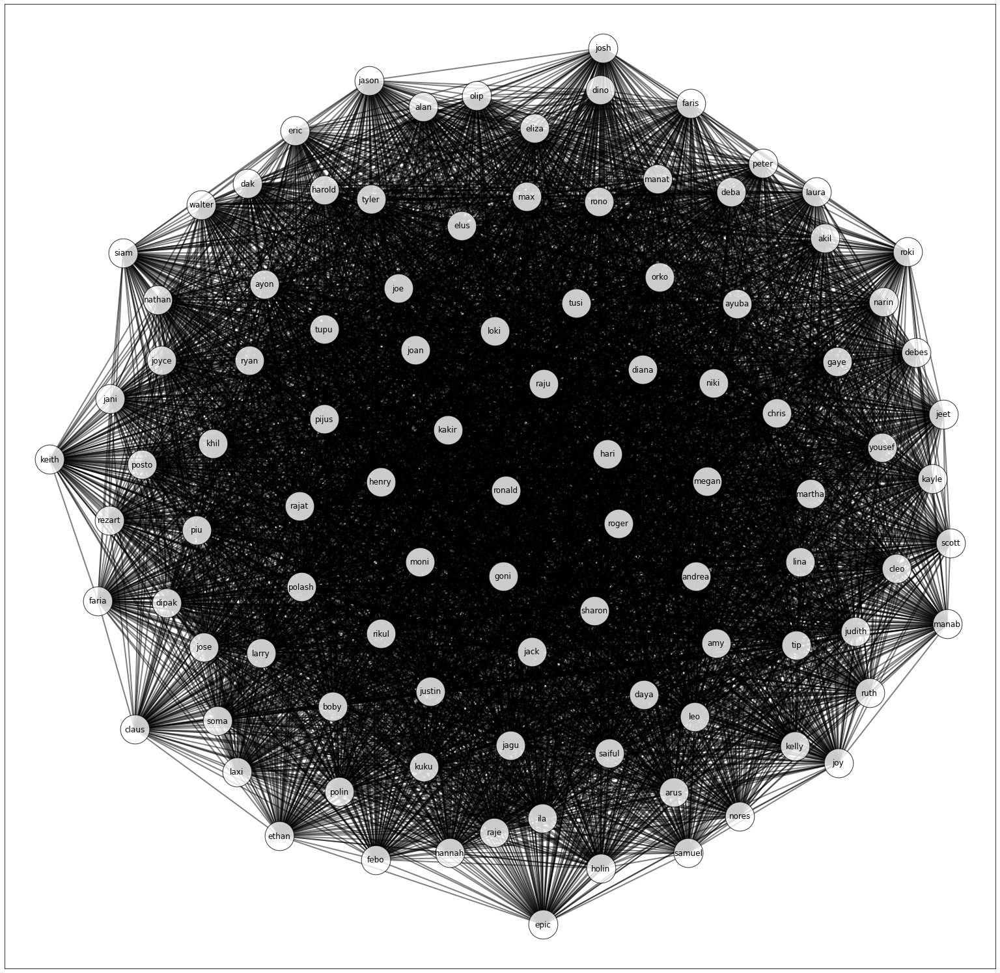

In [2]:
options = {"node_size": 2000, "alpha": 0.8}

fig, ax = plt.subplots(figsize=(60,60))

G = nx.from_numpy_matrix(c)

G = nx.relabel_nodes(G, mapping)

#pos = nx.spring_layout(G)

pos = {'siam': ([-0.83161297,  0.50407745]), 'ayon': ([-0.53680229,  0.43458075]), 'alan': ([-0.20529513,  0.8312662 ]), 
       'joe': ([-0.25761174,  0.42468698]), 'eliza': ([0.02719944, 0.78353093]), 'diana': ([0.25304329, 0.24256294]), 
       'lina': ([ 0.58135904, -0.18784663]), 'ayuba': ([0.4500152, 0.3906661]), 'deba': ([0.43720864, 0.64067396]),
       'kayle': ([ 0.85748105, -0.00172306]), 'raju': ([0.04561252, 0.21139816]), 'rezart': ([-0.86107209, -0.0943577 ]), 
       'yousef': ([0.75229355, 0.06885527]), 'polash': ([-0.45999655, -0.24356175]), 'rono': ([0.16133699, 0.6193264 ]), 
       'saiful': ([ 0.18283673, -0.61686877]), 'rajat': ([-0.46414214, -0.06272753]), 'max': ([0.01016856, 0.63007355]), 
       'peter': ([0.50429058, 0.7049124 ]), 'chris': ([0.53303782, 0.14519309]), 'ryan': ([-0.56781181,  0.26319718]), 
       'jason': ([-0.31872783,  0.89035868]), 'ronald': ([-0.03282218, -0.02698878]), 'eric': ([-0.47298613,  0.77858953]), 
       'larry': ([-0.54362093, -0.39209805]), 'amy': ([ 0.40585628, -0.36998134]), 'justin': ([-0.19025149, -0.47714616]), 
       'sharon': ([ 0.15195508, -0.2972677 ]), 'scott': ([ 0.89535153, -0.14510394]), 'laura': ([0.61515549, 0.64051987]), 
       'samuel': ([ 0.34770584, -0.8396216 ]), 'ruth': ([ 0.72680692, -0.48109003]), 'jack': ([ 0.0209999 , -0.38876149]), 
       'tyler': ([-0.31442416,  0.62431499]), 'jose': ([-0.66294794, -0.37858666]), 'joyce': ([-0.75232624,  0.26326182]), 
       'henry': ([-0.29439904, -0.00819456]), 'nathan': ([-0.75973514,  0.39929965]), 'kelly': ([ 0.57104432, -0.60050261]),
       'ethan': ([-0.50559522, -0.80144733]), 'joan': ([-0.2218134 ,  0.28660208]), 'walter': ([-0.66861968,  0.61192414]),
       'megan': ([ 0.38771174, -0.0070614 ]), 'judith': ([ 0.69699455, -0.34371093]), 'harold': ([-0.4123925 ,  0.64599938]),
       'keith': ([-0.9851934 ,  0.04172157]), 'andrea': ([ 0.36392425, -0.22036923]), 'roger': ([ 0.20198344, -0.10204603]),
       'hannah': ([-0.15039222, -0.83923899]), 'martha': ([ 0.60273146, -0.035691  ]), 'leo': ([ 0.36104985, -0.53404475]),
       'joy': ([ 0.66115767, -0.6380076 ]), 'orko': ([0.28825625, 0.45082491]), 'tip': ([ 0.57381479, -0.37439878]), 
       'hari': ([0.17963092, 0.05407089]), 'cleo': ([ 0.78300736, -0.20316418]), 'elus': ([-0.12462333,  0.56536768]), 
       'piu': ([-0.67856248, -0.11590145]), 'manat': ([0.28340269, 0.66996359]), 'raje': ([-0.05698275, -0.79375129]), 
       'claus': ([-0.80795999, -0.56274857]), 'faris': ([0.35291279, 0.83951411]), 'pijus': ([-0.41238439,  0.13209387]),
       'nores': ([ 0.45570537, -0.75697251]), 'posto': ([-0.79229332,  0.02985354]), 'debes': ([0.82383847, 0.281508  ]), 
       'faria': ([-0.88479303, -0.27515587]), 'ila': ([ 0.04269503, -0.76213009]), 'narin': ([0.75592329, 0.39413634]), 
       'khil': ([-0.6441181,  0.0779036]), 'dak': ([-0.57201256,  0.65945504]), 'febo': ([-0.30494467, -0.85445934]), 
       'jagu': ([-0.02334159, -0.59875416]), 'olip': ([-0.09392892,  0.8560944 ]), 'daya': ([ 0.25565375, -0.48499932]),
       'dino': ([0.16430303, 0.86915769]), 'goni': ([-0.03854032, -0.21990704]), 'kuku': ([-0.20400358, -0.64657869]), 
       'roki': ([0.80563829, 0.50632931]), 'boby': ([-0.39508643, -0.51191935]), 'dipak': ([-0.74169899, -0.27950757]), 
       'gaye': ([0.65860971, 0.26020043]), 'kakir': ([-0.15428437,  0.10850052]), 'rikul': ([-0.29327725, -0.34879595]), 
       'josh': ([0.1703234 , 0.96345809]), 'arus': ([ 0.317287  , -0.70420622]), 'niki': ([0.40034253, 0.21270576]), 
       'loki': ([-0.05631702,  0.32979163]), 'soma': ([-0.6347905 , -0.54409337]), 'jeet': ([0.88070194, 0.14302359]),
       'akil': ([0.63271509, 0.53697908]), 'holin': ([ 0.16544349, -0.87449623]), 'laxi': ([-0.59466775, -0.65833656]),
       'tusi': ([0.11380361, 0.39213   ]), 'jani': ([-0.85879406,  0.17733148]), 'epic': ([ 0.04430473, -1.        ]), 
       'polin': ([-0.38014555, -0.70259233]), 'moni': ([-0.21245947, -0.18755332]), 'manab': ([ 0.88845117, -0.32676839]), 
       'tupu': ([-0.41247373,  0.33324956])}



plt.subplot(221)
weights = nx.get_edge_attributes(G, "weight")
nx.draw_networkx_nodes(G, pos, node_color='white', edgecolors='black', **options)
nx.draw_networkx_edges(G, pos, width=2, alpha=0.5)
nx.draw_networkx_labels(G, pos)

plt.show()

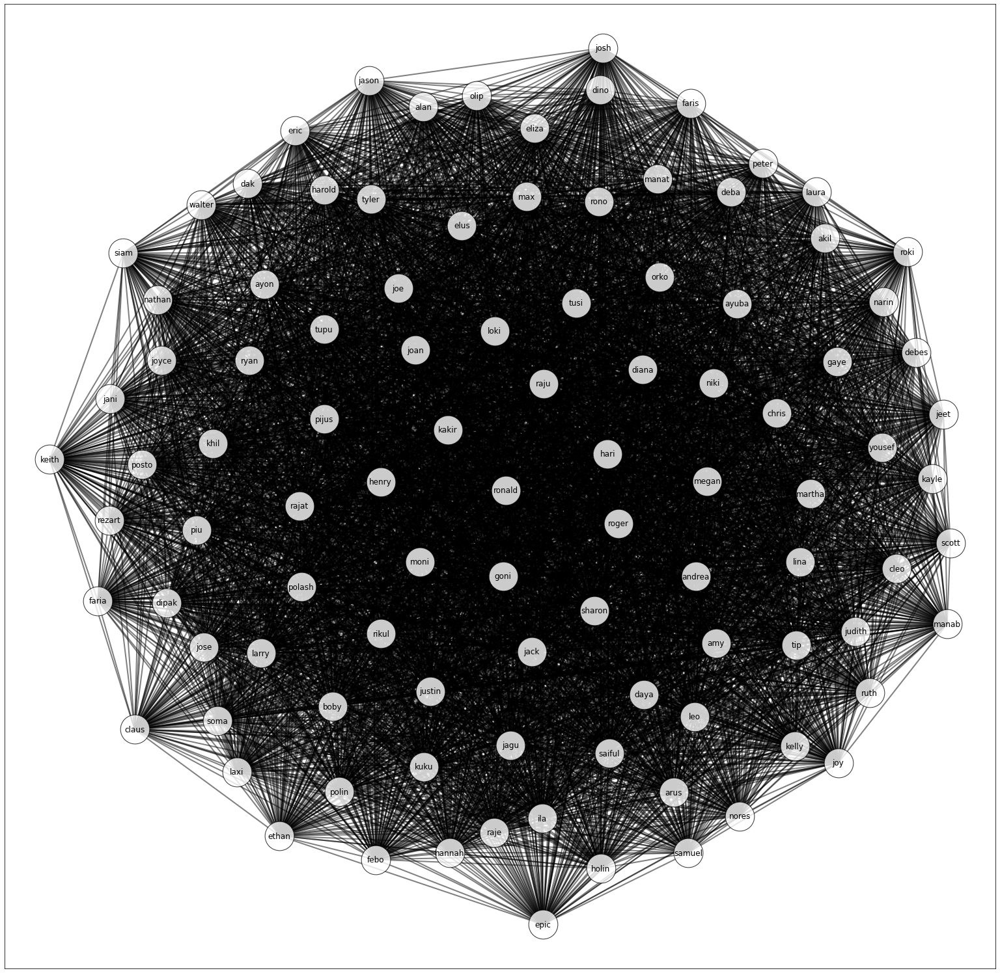

In [3]:
options = {"node_size": 2000, "alpha": 0.8}

fig, ax = plt.subplots(figsize=(60,60))

G1 = nx.from_numpy_matrix(d)

G1 = nx.relabel_nodes(G1, mapping)

plt.subplot(221)
weights2 = nx.get_edge_attributes(G1, "weight")
nx.draw_networkx_nodes(G1, pos, node_color='white', edgecolors='black', **options)
nx.draw_networkx_edges(G1, pos, width=2, alpha=0.5)
nx.draw_networkx_labels(G1, pos)

plt.show()

In [4]:
#print(Smaj, "\n\n", Syear, "\n\n", c, "\n\n", d)
#thrf
np.set_printoptions(threshold=np.inf)

print(list(Syear))


[array([1.  , 0.91, 0.85, 0.91, 0.55, 0.53, 0.75, 0.9 , 0.97, 0.56, 0.  ,
       0.73, 0.53, 0.92, 0.93, 0.57, 0.94, 0.65, 0.52, 0.86, 0.  , 0.55,
       0.91, 0.94, 0.87, 0.92, 0.5 , 0.56, 0.76, 0.5 , 0.  , 0.55, 0.59,
       0.52, 0.92, 0.71, 0.9 , 0.81, 0.76, 0.54, 0.  , 0.81, 0.83, 0.82,
       0.94, 0.61, 0.94, 0.67, 0.94, 0.88, 0.  , 0.94, 0.63, 0.68, 0.97,
       0.92, 0.95, 0.85, 0.97, 0.74, 0.  , 0.63, 0.63, 0.55, 0.92, 0.87,
       0.64, 0.58, 0.66, 0.87, 0.  , 0.68, 0.94, 0.87, 0.8 , 0.86, 0.88,
       0.74, 0.54, 0.89, 0.  , 0.58, 0.85, 0.9 , 0.56, 0.53, 0.67, 0.84,
       0.59, 0.73, 0.  , 0.91, 0.72, 0.81, 0.73, 0.99, 0.78, 0.93, 0.59,
       0.88]), array([0.91, 1.  , 0.76, 0.92, 0.85, 0.64, 0.75, 0.54, 0.92, 0.85, 0.82,
       0.69, 0.65, 0.52, 0.95, 0.98, 0.81, 0.96, 0.93, 0.72, 0.77, 0.74,
       0.7 , 0.78, 0.67, 0.64, 0.76, 0.97, 0.55, 0.55, 0.71, 0.97, 0.58,
       0.51, 0.92, 0.91, 0.52, 0.65, 0.66, 0.82, 0.75, 0.56, 0.74, 0.94,
       0.85, 0.94, 1.  , 0.68, 0.63

In [5]:
overlap =[]

#for name in mcd.CSS4_COLORS:
for name in mcd.XKCD_COLORS:
    if 'white' not in name:
        overlap.append(name)

In [6]:
#print(pos)


In [9]:
def evalquery(weight):
    
    for i in range(0,dim):
        for j in range(0,dim):

            sm = Smaj[i,j]
            sy = Syear[i,j]
            
            if sm < thr1 and sy <thr2:
                e[i,j] = 0
            else:
                if weight==0:
                    tempval = sm*sy
                else:
                    tempval = (sm*weight)+(sy*(1-weight))
                    
                e[i,j] = int(tempval*100)/100
                #"{:.2f}".format((sm*weight)+(sy*(1-weight)))
                #e[i,j] = "{:.3f}".format((sm+(1-weight[0])-sm*(1-weight[0]))*(sy+(1-weight[1])-sy*(1-weight[1])))
                #e[i,j] = "{:.2f}".format((sm*weight[0])+(sy*weight[1])-(sm*weight[0]*sy*weight[1]))

    #print(e)

    #Conjunction maxterm
    for i in range(0,dim):
        for j in range(0,dim):
            if weight == 0:
                if e[i,j]<thr1*thr2:
                    u[i,j] = 0
                else:
                    u[i,j] = e[i,j]
            else:
                if e[i,j]<thrf:
                    u[i,j] = 0
                else:
                    u[i,j] = e[i,j]


    print(u)
    #print(feedback)

    G3 = nx.from_numpy_matrix(u)

        #mapping = {0: 'siam', 1: 'ayon', 2: 'alan', 3: 'joe', 4: 'eliza'}
    G3 = nx.relabel_nodes(G3, mapping)

    weightsg = nx.get_edge_attributes(G3, "weight")

    fig, ax1 = plt.subplots(figsize=(20,20))

    clusters = list(clq.find_cliques(G3))
    
    #######################################
    
    from collections import Counter
    
    sublist = []
    
    for edg in clusters:
        edg = sorted(edg)
        ed_sublist = list(combinations(edg,2))
        for edgsub in ed_sublist:
            sublist.append(edgsub)
        
    subcount = Counter(sublist)
    
    ######################################
    
    #print(clusters)

    options = {"node_size": 1400, "alpha": 0.8}

    nx.draw_networkx_labels(G3, pos)

    for i in range(0,len(clusters)):
        node_list = clusters[i]

        #print("Cluster ", i, ": ", node_list)
        #ncolor = list(mcolor.keys())[i]
        
        ncolor = overlap[i]
        
        #print(overlap[i])
        
        #print(list(mcolor.values())[i]+"Cluster ", i, ": ", node_list) 
        print("Cluster ", i, ": ", node_list) 

        #nx.draw_networkx_nodes(G3, pos, nodelist=node_list, node_color=colornames[i], **options)
        nx.draw_networkx_nodes(G3, pos, nodelist=node_list, node_color='white', edgecolors='black', **options)

        if len(node_list)>1:

            node_list = sorted(node_list)
            
            edge_list = list(combinations(node_list,2))
            
            #print(edge_list)
            
            weight_edge = []
            
            for co_edge in edge_list:
                
                tempedge = 3
                
                rep_sub = list(subcount.values())[list(subcount.keys()).index(co_edge)]
                
                if rep_sub > 1:
                    tempedge = (tempedge+1) * rep_sub +2
                    weight_edge.append(tempedge)
                    subcount[co_edge] = rep_sub-1
                else:
                    weight_edge.append(tempedge)
                    
            #nx.draw_networkx_edges(G3, pos, edgelist=edge_list,
                                    #alpha=0.5, edge_color=ncolor)
            nx.draw_networkx_edges(G3, pos, edgelist=edge_list,
                                    alpha=0.5, edge_color='black')
            #nx.draw_networkx_edges(G3, pos, edgelist=edge_list,
                                    #alpha=0.5), edge_color=ncolor)
            #nx.draw_networkx_edges(G3, pos, edgelist=edge_list,
                                    #width=weight_edge, alpha=0.5, edge_color=ncolor)
    
    
    #import networkx.algorithms.community as nx_comm
    #mnn = [{'eliza', 'siam'}, {'siam', 'ayon'}, {'diana', 'ayon'}, {'diana', 'alan', 'joe'}]
    #nx_comm.modularity(G3, mnn)
    #print(clusters)
    
    return clusters

[[1.   0.78 0.72 0.8  0.7  0.72 0.71 0.84 0.87 0.74 0.   0.78 0.61 0.94
  0.84 0.   0.88 0.7  0.57 0.87 0.   0.7  0.94 0.93 0.92 0.79 0.74 0.65
  0.68 0.59 0.   0.62 0.57 0.55 0.86 0.77 0.86 0.76 0.71 0.65 0.   0.75
  0.85 0.74 0.84 0.   0.76 0.65 0.9  0.9  0.   0.87 0.71 0.76 0.76 0.79
  0.97 0.78 0.85 0.82 0.   0.7  0.67 0.63 0.81 0.89 0.81 0.58 0.79 0.86
  0.   0.68 0.96 0.75 0.87 0.   0.74 0.65 0.66 0.77 0.5  0.76 0.86 0.82
  0.71 0.58 0.68 0.73 0.69 0.84 0.   0.9  0.74 0.71 0.78 0.88 0.67 0.77
  0.63 0.87]
 [0.78 1.   0.8  0.75 0.8  0.64 0.71 0.57 0.79 0.9  0.7  0.75 0.76 0.66
  0.78 0.77 0.69 0.88 0.94 0.77 0.86 0.85 0.81 0.89 0.66 0.82 0.73 0.96
  0.61 0.72 0.74 0.93 0.63 0.74 0.85 0.78 0.71 0.6  0.81 0.84 0.78 0.64
  0.83 0.93 0.7  0.93 0.97 0.73 0.79 0.93 0.76 0.7  0.67 0.62 0.71 0.61
  0.87 0.95 0.89 0.84 0.6  0.86 0.75 0.69 0.68 0.75 0.88 0.62 0.66 0.64
  0.83 0.58 0.67 0.81 0.71 0.9  0.74 0.89 0.92 0.73 0.76 0.91 0.8  0.79
  0.76 0.76 0.85 0.67 0.68 0.83 0.7  0.9  0.88 0.82

Cluster  1 :  ['max', 'ruth', 'debes', 'epic', 'tyler', 'rezart', 'jack', 'febo', 'judith', 'ayon', 'jason', 'andrea', 'narin', 'larry', 'jani', 'lina', 'harold', 'kakir', 'joyce', 'kayle', 'tupu', 'kelly', 'diana', 'eliza', 'nathan', 'loki', 'boby', 'orko', 'soma', 'goni', 'daya', 'roger', 'ila', 'laura', 'gaye', 'rajat', 'arus', 'joy', 'amy', 'polin', 'cleo', 'josh', 'moni', 'olip', 'eric', 'ethan', 'rono', 'jagu', 'niki', 'joe', 'walter', 'holin', 'peter', 'khil', 'hannah', 'scott', 'jose', 'laxi', 'raje', 'yousef', 'piu', 'kuku', 'ayuba', 'polash', 'faris', 'elus', 'chris', 'alan', 'faria', 'manat', 'manab', 'deba', 'ronald', 'martha', 'roki', 'sharon', 'jeet', 'henry', 'tip', 'hari', 'nores', 'rikul', 'tusi', 'justin', 'megan', 'posto', 'pijus', 'dino', 'raju']
Cluster  2 :  ['max', 'ruth', 'debes', 'epic', 'tyler', 'rezart', 'jack', 'febo', 'judith', 'ayon', 'jason', 'andrea', 'narin', 'larry', 'jani', 'lina', 'harold', 'kakir', 'joyce', 'kayle', 'tupu', 'kelly', 'diana', 'eliza'

Cluster  12 :  ['max', 'ruth', 'debes', 'epic', 'tyler', 'rezart', 'jack', 'febo', 'judith', 'ayon', 'jason', 'andrea', 'narin', 'larry', 'jani', 'lina', 'harold', 'kakir', 'joyce', 'kayle', 'tupu', 'kelly', 'diana', 'eliza', 'nathan', 'loki', 'boby', 'orko', 'soma', 'goni', 'daya', 'roger', 'ila', 'laura', 'gaye', 'rajat', 'arus', 'joy', 'amy', 'polin', 'cleo', 'josh', 'moni', 'olip', 'eric', 'ethan', 'rono', 'jagu', 'niki', 'joe', 'walter', 'holin', 'peter', 'khil', 'hannah', 'scott', 'jose', 'laxi', 'raje', 'yousef', 'piu', 'kuku', 'ayuba', 'polash', 'faris', 'elus', 'chris', 'alan', 'faria', 'manat', 'manab', 'deba', 'ronald', 'martha', 'roki', 'sharon', 'jeet', 'henry', 'tip', 'hari', 'nores', 'rikul', 'tusi', 'justin', 'megan', 'posto', 'pijus', 'keith', 'dipak']
Cluster  13 :  ['max', 'ruth', 'debes', 'epic', 'tyler', 'rezart', 'jack', 'febo', 'judith', 'ayon', 'jason', 'andrea', 'narin', 'larry', 'jani', 'lina', 'harold', 'kakir', 'joyce', 'kayle', 'tupu', 'kelly', 'diana', 'el

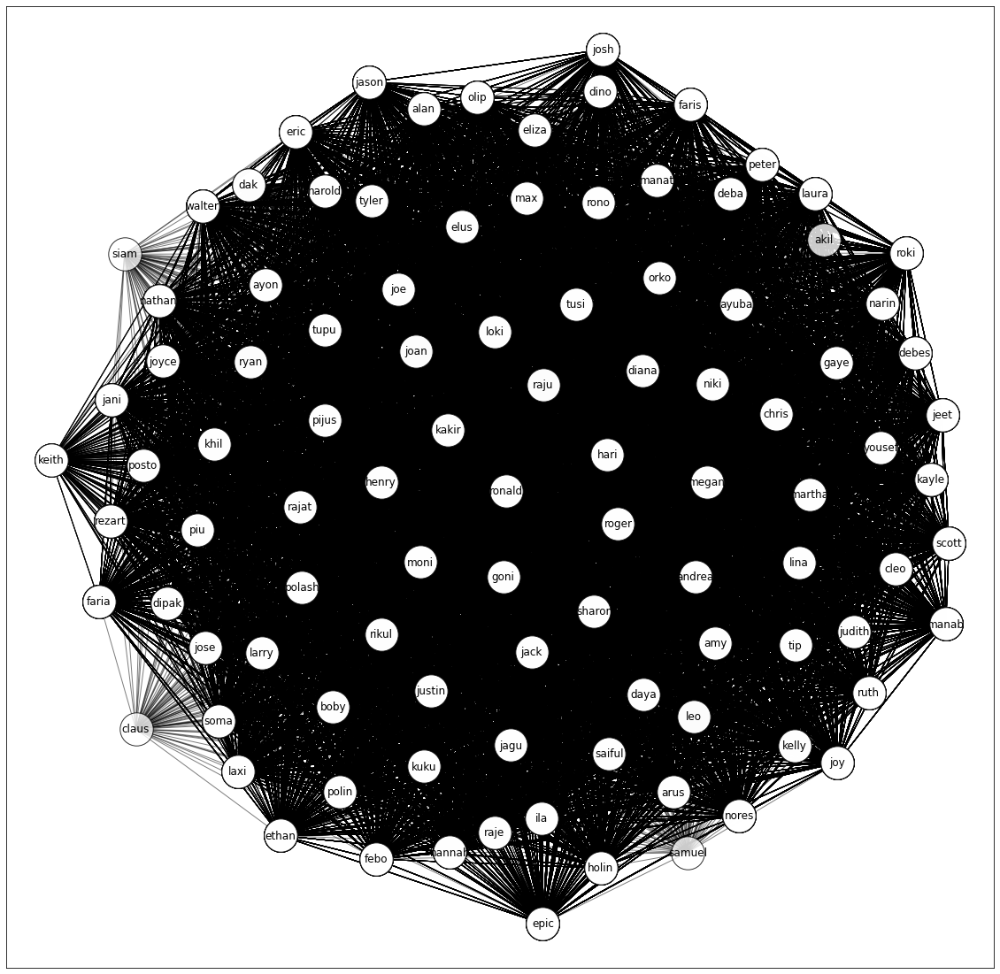

In [10]:
weight = 0.5

clusters = evalquery(weight)

weight_final = weight

nclusters = clusters


In [143]:
def clustersprint(tclusters):

    import math

    pltdim = len(tclusters)

    wdim = math.ceil(pltdim/4)
    
    #print(wdim)

    plt.subplots(figsize=(40,40))

    QW = []

    QW = [0 for xd in range(0,pltdim)]

    for uz in range(0,pltdim):
        kk = uz+1
        
        #print(kk)
        plt.subplot(wdim, 4, kk)

        QW[uz] = nx.complete_graph(tclusters[uz])
        
        #dcolor = list(mcolor.keys())[uz]
        
        dcolor = overlap[uz]
        
        #print(list(QW[uz].nodes()))
        #nx.draw(G1, pos, with_labels=True, node_color = 'silver', node_size=1600)
    
        nx.draw(QW[uz], nodelist=tclusters[uz], node_color = dcolor, edge_color = dcolor, with_labels=True, node_size=1800)
        #plt.title('Cluster '+str(uz))

        plt.title('Cluster '+str(uz)+': '+str(tclusters[uz]))
    
#print(len(G8))

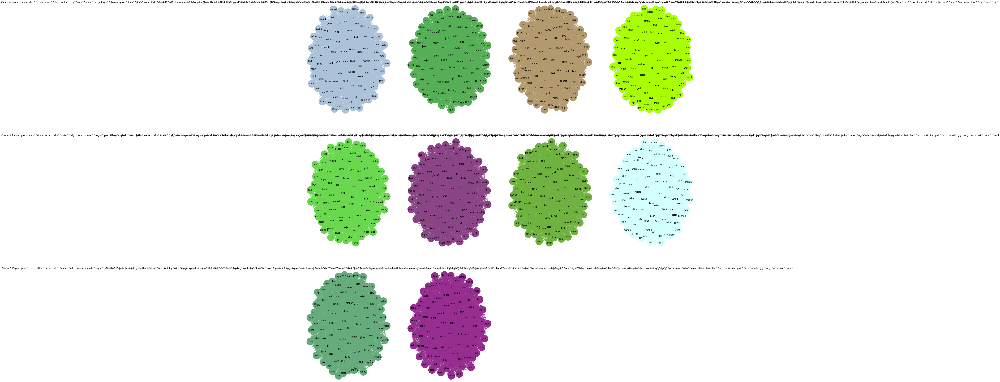

In [144]:
clustersprint(clusters)

In [145]:
def feedbackverify(feedback, ispossible):

    from itertools import combinations 

    #feedback = ['eliza', 'siam']
    #feedback = ['ayon', 'alan', 'joe']

    rel = []

    #th = 0.5

    #print(feedback)
    for feed in feedback:
        rel.append(list(mapping.keys())[list(mapping.values()).index(feed)])

    print(rel)

    r1 = 2

    s1 = []
    s2 = []

    for subset in combinations(rel, r1):
        if Smaj[subset[0],subset[1]] < thr1 and Syear[subset[0],subset[1]] <thr2:
            ispossible = 1

            #stri = "There is no edge between "+ mapping[subset[0]]+" and "+mapping[subset[1]]+".\nTherefore, User feedback is not possible to satisfy."
            stri = "Feedback is not possible to satisfy."
            print(stri)
            break

        s1.append(Smaj[subset[0],subset[1]])
        s2.append(Syear[subset[0],subset[1]])

    import ctypes  # An included library with Python install.

    if(ispossible == 1):
        ctypes.windll.user32.MessageBoxW(0, stri, "Inconsistency")

    print(s1,s2)
    print()
    
    return s1,s2,ispossible

In [146]:
def normalizew(s1,s2,feedback_option):

    import numpy as np
    from scipy.optimize import minimize

    def objective(x):
        return p*x+q*(1-x)
    def constraint(x):
        return p*x+q*(1-x)-thrf

    x0 = [0.5]
    #print(objective(x0))

    b = (0,1)
    bnd = (b,b)
    cons = {'type': 'ineq', 'fun': constraint}
    
    weight_final = 0
    
    if feedback_option == 1:

        min = 1
        max = 0

        l = 0
        u = 0

        for i in range(0,len(s1)):
            p = s1[i]
            q = s2[i]

            if p<thrf or q<thrf:
                #sol = minimize(objective, x0, method='COBYLA', bounds=bnd, constraints=cons)
                sol = minimize(objective, x0, method='SLSQP', constraints=cons)

                r = sol.x

                if 0<=r[0]<thrf and u==0:
                    l = 1
                    if r[0]<min:
                        min = r[0]

                elif thrf<r[0]<=1 and l==0:
                    u = 1
                    if r[0]>max:
                        max = r[0]
                else:
                    min = 0
                    max = 0
                    break     

        #print(min,max)

        test = 0

        if max == 0 and min == 0:
            test = -1
        else:
            if max == 0 and min !=1:
                test = min
            else:
                test = max
            test = round(test,2)

        print()

        if test !=-1:
            for i in range(0,len(s1)):
                p = s1[i]
                q = s2[i]

                if objective(test)<thrf:
                    if objective(test+0.01)<thrf:
                        test = test-0.01
                    else:
                        test = test+0.01

                    test = int(test*100)/100
                print(objective(test))

        print()
        print("Weight: ",test)
        print()
        
        weight_final = test
        #return test
    
    else:
        rf = 0

        for i in range(0,len(s1)):
            p = s1[i]
            q = s2[i]

            #print(p1,q1)

            if p<thrf or q<thrf:
                #print(p,q)
                #sol = minimize(objective, x0, method='COBYLA', bounds=bnd, constraints=cons)
                sol = minimize(objective, x0, method='SLSQP', constraints=cons)

                r = sol.x

                rf = r[0]

                #print(sol1)

                break

        if rf>0 and rf <1:
            if objective(rf+0.01)<0.5:
                #rf = round((rf+0.02),2)
                rf = rf+0.01
            else:
                #rf = round((rf-0.02),2)
                rf = rf-0.01
        else:
            rf = -1
            
        rf = int(rf*100)/100
        print(objective(rf))
        weight_final = rf
    
    return weight_final

In [147]:
def feedback_new(feedback):

    import ctypes

    #feedback = ['ayon', 'eliza', 'alan']#, 'alan']

    #feedback = ['siam', 'diana', 'alan']

    #feedback = ['ayon', 'alan']

    ispossible = 0
    
    weightf = -1

    s1,s2, ispossible = feedbackverify(feedback, ispossible)

    if ispossible == 0:
        weightf = normalizew(s1,s2,1)

        #weightf = [0.5, 0.7]
        if weightf == -1:
            ctypes.windll.user32.MessageBoxW(0, "Not possible", "Inconsistency")
        else:
            weightf = weightf
            #qclusters = evalquery(weightf)
        
    return s1,s2,weightf
    #printclusters(nclusters)

In [148]:
def fetchdata(obj, fcluster):
    
    import ctypes

    frel = []
    
    weightf2 = -1

    ffeedback = nclusters[fcluster]

    print(ffeedback)

    #fobj = list(mapping.keys())[list(mapping.values()).index(obj)]

    for ffeed in ffeedback:
            findx = list(mapping.keys())[list(mapping.values()).index(ffeed)]
            #if findx !=fobj:
            frel.append(findx)

    #print(frel, fobj)
    print(frel)

    d1 = []
    d2 = []
    
    for subset in combinations(frel, 2):
        d1.append(Smaj[subset[0],subset[1]])
        d2.append(Syear[subset[0],subset[1]])

    #for w in frel:
        #d1.append(Smaj[fobj,w])
        #d2.append(Syear[fobj,w])

    print(d1,d2)

    weightf2 = normalizew(d1,d2,2)

    if weightf2 == -1:
        ctypes.windll.user32.MessageBoxW(0, "Not possible", "Inconsistency")
    else:
        print('\nweight:', weightf2)
        print()
        #fclustersf = evalquery(weightf2)
    
    return d1,d2,weightf2

In [149]:
def verify_constraint(simp, wgt):
    return simp[0]*wgt+simp[1]*(1-wgt)

def check_feedback(feedbackm, feedbackn, weight_m):
        is_feedback = 1
        
        for i in range(0,len(feedbackm)):
            for j in range(0,len(feedbackm[i])):
                print('Testing:',feedbackm[i][j],feedbackn[i][j])
                
                temp_var = []
                temp_var.append(feedbackm[i][j])
                temp_var.append(feedbackn[i][j])
                
                print(verify_constraint(temp_var,weight_m))
                    
                if verify_constraint(temp_var,weight_m)<0.5:
                    is_feedback = 0
                    break
        return is_feedback

In [150]:
def Fmeasure(gclst):
    #pclst = [['eliza', 'siam', 'ayon'], ['eliza', 'alan'], ['diana', 'joe', 'alan'], ['diana', 'siam', 'ayon']]
    #gclst = [[1,2,3],[2,3,4],[5,6],[7]]
    
    #print(pclst)
    #print(gclst)
    
    pclst = [['ayon', 'posto', 'chris', 'ethan', 'rezart', 'elus', 'walter', 'kelly', 'jason', 'manab', 'megan', 'joe', 'sharon', 'polash', 'rajat', 'josh', 'henry', 'khil', 'piu', 'roki', 'tip', 'keith', 'gaye', 'pijus', 'orko', 'faria', 'peter', 'alan', 'febo', 'justin', 'diana', 'harold', 'ruth', 'dino', 'manat', 'andrea', 'kayle', 'jani', 'max', 'jose', 'nathan', 'debes', 'soma', 'rikul', 'goni', 'joyce', 'daya', 'judith', 'scott', 'holin', 'laura', 'cleo', 'eric', 'tusi', 'arus', 'raje', 'epic', 'tupu', 'jeet', 'moni', 'tyler', 'lina', 'boby', 'loki', 'ayuba', 'yousef', 'faris', 'martha', 'hannah', 'rono', 'eliza', 'jagu', 'nores', 'narin', 'kakir', 'roger', 'deba', 'laxi', 'hari', 'larry', 'niki', 'ila', 'polin', 'jack', 'ronald', 'joy', 'amy', 'kuku', 'olip', 'saiful', 'dak']
,['ayon', 'posto', 'chris', 'ethan', 'rezart', 'elus', 'walter', 'kelly', 'jason', 'manab', 'megan', 'joe', 'sharon', 'polash', 'rajat', 'josh', 'henry', 'khil', 'piu', 'roki', 'tip', 'keith', 'gaye', 'pijus', 'orko', 'faria', 'peter', 'alan', 'febo', 'justin', 'diana', 'harold', 'ruth', 'dino', 'manat', 'andrea', 'kayle', 'jani', 'max', 'jose', 'nathan', 'debes', 'soma', 'rikul', 'goni', 'joyce', 'daya', 'judith', 'scott', 'holin', 'laura', 'cleo', 'eric', 'tusi', 'arus', 'raje', 'epic', 'tupu', 'jeet', 'moni', 'tyler', 'lina', 'boby', 'loki', 'ayuba', 'yousef', 'faris', 'martha', 'hannah', 'rono', 'eliza', 'jagu', 'nores', 'narin', 'kakir', 'roger', 'deba', 'laxi', 'hari', 'larry', 'niki', 'ila', 'polin', 'jack', 'ronald', 'joy', 'amy', 'kuku', 'olip', 'saiful', 'samuel']
,['ayon', 'posto', 'chris', 'ethan', 'rezart', 'elus', 'walter', 'kelly', 'jason', 'manab', 'megan', 'joe', 'sharon', 'polash', 'rajat', 'josh', 'henry', 'khil', 'piu', 'roki', 'tip', 'keith', 'gaye', 'pijus', 'orko', 'faria', 'peter', 'alan', 'febo', 'justin', 'diana', 'harold', 'ruth', 'dino', 'manat', 'andrea', 'kayle', 'jani', 'max', 'jose', 'nathan', 'debes', 'soma', 'rikul', 'goni', 'joyce', 'daya', 'judith', 'scott', 'holin', 'laura', 'cleo', 'eric', 'tusi', 'arus', 'raje', 'epic', 'tupu', 'jeet', 'moni', 'tyler', 'lina', 'boby', 'loki', 'ayuba', 'yousef', 'faris', 'martha', 'hannah', 'rono', 'eliza', 'jagu', 'nores', 'narin', 'kakir', 'roger', 'deba', 'laxi', 'hari', 'larry', 'niki', 'ila', 'polin', 'jack', 'ronald', 'joy', 'amy', 'kuku', 'olip', 'saiful', 'joan']
,['ayon', 'posto', 'chris', 'ethan', 'rezart', 'elus', 'walter', 'kelly', 'jason', 'manab', 'megan', 'joe', 'sharon', 'polash', 'rajat', 'josh', 'henry', 'khil', 'piu', 'roki', 'tip', 'keith', 'gaye', 'pijus', 'orko', 'faria', 'peter', 'alan', 'febo', 'justin', 'diana', 'harold', 'ruth', 'dino', 'manat', 'andrea', 'kayle', 'jani', 'max', 'jose', 'nathan', 'debes', 'soma', 'rikul', 'goni', 'joyce', 'daya', 'judith', 'scott', 'holin', 'laura', 'cleo', 'eric', 'tusi', 'arus', 'raje', 'epic', 'tupu', 'jeet', 'moni', 'tyler', 'lina', 'boby', 'loki', 'ayuba', 'yousef', 'faris', 'martha', 'hannah', 'rono', 'eliza', 'jagu', 'nores', 'narin', 'kakir', 'roger', 'deba', 'laxi', 'hari', 'larry', 'niki', 'ila', 'polin', 'jack', 'ronald', 'joy', 'amy', 'kuku', 'olip', 'saiful', 'raju']
,['ayon', 'posto', 'chris', 'ethan', 'rezart', 'elus', 'walter', 'kelly', 'jason', 'manab', 'megan', 'joe', 'sharon', 'polash', 'rajat', 'josh', 'henry', 'khil', 'piu', 'roki', 'tip', 'keith', 'gaye', 'pijus', 'orko', 'faria', 'peter', 'alan', 'febo', 'justin', 'diana', 'harold', 'ruth', 'dino', 'manat', 'andrea', 'kayle', 'jani', 'max', 'jose', 'nathan', 'debes', 'soma', 'rikul', 'goni', 'joyce', 'daya', 'judith', 'scott', 'holin', 'laura', 'cleo', 'eric', 'tusi', 'arus', 'raje', 'epic', 'tupu', 'jeet', 'moni', 'tyler', 'lina', 'boby', 'loki', 'ayuba', 'yousef', 'faris', 'martha', 'hannah', 'rono', 'eliza', 'jagu', 'nores', 'narin', 'kakir', 'roger', 'deba', 'laxi', 'hari', 'larry', 'niki', 'ila', 'polin', 'jack', 'ronald', 'joy', 'amy', 'kuku', 'olip', 'saiful', 'akil']
,['ayon', 'posto', 'chris', 'ethan', 'rezart', 'elus', 'walter', 'kelly', 'jason', 'manab', 'megan', 'joe', 'sharon', 'polash', 'rajat', 'josh', 'henry', 'khil', 'piu', 'roki', 'tip', 'keith', 'gaye', 'pijus', 'orko', 'faria', 'peter', 'alan', 'febo', 'justin', 'diana', 'harold', 'ruth', 'dino', 'manat', 'andrea', 'kayle', 'jani', 'max', 'jose', 'nathan', 'debes', 'soma', 'rikul', 'goni', 'joyce', 'daya', 'judith', 'scott', 'holin', 'laura', 'cleo', 'eric', 'tusi', 'arus', 'raje', 'epic', 'tupu', 'jeet', 'moni', 'tyler', 'lina', 'boby', 'loki', 'ayuba', 'yousef', 'faris', 'martha', 'hannah', 'rono', 'eliza', 'jagu', 'nores', 'narin', 'kakir', 'roger', 'deba', 'laxi', 'hari', 'larry', 'niki', 'ila', 'polin', 'jack', 'ronald', 'joy', 'amy', 'kuku', 'olip', 'saiful', 'claus']
,['ayon', 'posto', 'chris', 'ethan', 'rezart', 'elus', 'walter', 'kelly', 'jason', 'manab', 'megan', 'joe', 'sharon', 'polash', 'rajat', 'josh', 'henry', 'khil', 'piu', 'roki', 'tip', 'keith', 'gaye', 'pijus', 'orko', 'faria', 'peter', 'alan', 'febo', 'justin', 'diana', 'harold', 'ruth', 'dino', 'manat', 'andrea', 'kayle', 'jani', 'max', 'jose', 'nathan', 'debes', 'soma', 'rikul', 'goni', 'joyce', 'daya', 'judith', 'scott', 'holin', 'laura', 'cleo', 'eric', 'tusi', 'arus', 'raje', 'epic', 'tupu', 'jeet', 'moni', 'tyler', 'lina', 'boby', 'loki', 'ayuba', 'yousef', 'faris', 'martha', 'hannah', 'rono', 'eliza', 'jagu', 'nores', 'narin', 'kakir', 'roger', 'deba', 'laxi', 'hari', 'larry', 'niki', 'ila', 'polin', 'jack', 'ronald', 'joy', 'amy', 'kuku', 'olip', 'saiful', 'dipak']
,['ayon', 'posto', 'chris', 'ethan', 'rezart', 'elus', 'walter', 'kelly', 'jason', 'manab', 'megan', 'joe', 'sharon', 'polash', 'rajat', 'josh', 'henry', 'khil', 'piu', 'roki', 'tip', 'keith', 'gaye', 'pijus', 'orko', 'faria', 'peter', 'alan', 'febo', 'justin', 'diana', 'harold', 'ruth', 'dino', 'manat', 'andrea', 'kayle', 'jani', 'max', 'jose', 'nathan', 'debes', 'soma', 'rikul', 'goni', 'joyce', 'daya', 'judith', 'scott', 'holin', 'laura', 'cleo', 'eric', 'tusi', 'arus', 'raje', 'epic', 'tupu', 'jeet', 'moni', 'tyler', 'lina', 'boby', 'loki', 'ayuba', 'yousef', 'faris', 'martha', 'hannah', 'rono', 'eliza', 'jagu', 'nores', 'narin', 'kakir', 'roger', 'deba', 'laxi', 'hari', 'larry', 'niki', 'ila', 'polin', 'jack', 'ronald', 'joy', 'amy', 'kuku', 'olip', 'saiful', 'ryan']
,['ayon', 'posto', 'chris', 'ethan', 'rezart', 'elus', 'walter', 'kelly', 'jason', 'manab', 'megan', 'joe', 'sharon', 'polash', 'rajat', 'josh', 'henry', 'khil', 'piu', 'roki', 'tip', 'keith', 'gaye', 'pijus', 'orko', 'faria', 'peter', 'alan', 'febo', 'justin', 'diana', 'harold', 'ruth', 'dino', 'manat', 'andrea', 'kayle', 'jani', 'max', 'jose', 'nathan', 'debes', 'soma', 'rikul', 'goni', 'joyce', 'daya', 'judith', 'scott', 'holin', 'laura', 'cleo', 'eric', 'tusi', 'arus', 'raje', 'epic', 'tupu', 'jeet', 'moni', 'tyler', 'lina', 'boby', 'loki', 'ayuba', 'yousef', 'faris', 'martha', 'hannah', 'rono', 'eliza', 'jagu', 'nores', 'narin', 'kakir', 'roger', 'deba', 'laxi', 'hari', 'larry', 'niki', 'ila', 'polin', 'jack', 'ronald', 'joy', 'amy', 'kuku', 'olip', 'saiful', 'leo']
,['ayon', 'posto', 'chris', 'ethan', 'rezart', 'elus', 'walter', 'kelly', 'jason', 'manab', 'megan', 'joe', 'sharon', 'polash', 'rajat', 'josh', 'henry', 'khil', 'piu', 'roki', 'tip', 'keith', 'gaye', 'pijus', 'orko', 'faria', 'peter', 'alan', 'febo', 'justin', 'diana', 'harold', 'ruth', 'dino', 'manat', 'andrea', 'kayle', 'jani', 'max', 'jose', 'nathan', 'debes', 'soma', 'rikul', 'goni', 'joyce', 'daya', 'judith', 'scott', 'holin', 'laura', 'cleo', 'eric', 'tusi', 'arus', 'raje', 'epic', 'tupu', 'jeet', 'moni', 'tyler', 'lina', 'boby', 'loki', 'ayuba', 'yousef', 'faris', 'martha', 'hannah', 'rono', 'eliza', 'jagu', 'nores', 'narin', 'kakir', 'roger', 'deba', 'laxi', 'hari', 'larry', 'niki', 'ila', 'polin', 'jack', 'ronald', 'joy', 'amy', 'kuku', 'olip', 'siam']]

    pset = set()
    gset = set()

    for pc in pclst:
        pc = sorted(pc)
        if len(pc)>1:
            P_list=set(list(combinations(pc,2)))
            pset.update(P_list)
        
    for qc in gclst:
        qc = sorted(qc)
        if len(qc)>1:
            Q_list=set(list(combinations(qc,2)))
            gset.update(Q_list)

    print(pset)
    print(gset)
    
    #print(pset.intersection(gset))

    a11 = len(pset.intersection(gset))
    
    #print(ac)

    a10 = len(gset.difference(pset))

    a01 = len(pset.difference(gset))
    
    lam = (dim*(dim-1))/2
    
    a00 = lam-a11-a10-a01
    
    accuracy = (a11+a00)/lam
    
    cldis = -np.log(accuracy)
    
    cldis = int(cldis*100)/100
    
    #print("accuracy: ",cldis)

    #beta = 1

    #precision = ac/(ac+cc)
    #recall = ac/(ac+bc)
    
    #F = (2*ac)/((2*ac)+bc+cc)

    #Fm = 2*((precision*recall)/(precision+recall))

    #Fs = (((beta**2)+1)*(precision*recall))/(((beta**2)*precision)+recall)

    #print("Precision: ",precision)
    #print("Recall: ",recall)

    #print(F, Fm, Fs)
    
    return cldis

[[1.   0.86 0.8  ... 0.87 0.6  0.87]
 [0.86 1.   0.77 ... 0.58 0.7  0.87]
 [0.8  0.77 1.   ... 0.71 0.71 0.63]
 ...
 [0.87 0.58 0.71 ... 1.   0.76 0.58]
 [0.6  0.7  0.71 ... 0.76 1.   0.68]
 [0.87 0.87 0.63 ... 0.58 0.68 1.  ]]
Cluster  0 :  ['ayon', 'posto', 'chris', 'ethan', 'rezart', 'elus', 'walter', 'kelly', 'jason', 'manab', 'megan', 'joe', 'sharon', 'polash', 'rajat', 'josh', 'henry', 'khil', 'piu', 'roki', 'tip', 'keith', 'gaye', 'pijus', 'orko', 'faria', 'peter', 'alan', 'febo', 'justin', 'diana', 'harold', 'ruth', 'dino', 'manat', 'andrea', 'kayle', 'jani', 'max', 'jose', 'nathan', 'debes', 'soma', 'rikul', 'goni', 'joyce', 'daya', 'judith', 'scott', 'holin', 'laura', 'cleo', 'eric', 'tusi', 'arus', 'raje', 'epic', 'tupu', 'jeet', 'moni', 'tyler', 'lina', 'boby', 'loki', 'ayuba', 'yousef', 'faris', 'martha', 'hannah', 'rono', 'eliza', 'jagu', 'nores', 'narin', 'kakir', 'roger', 'deba', 'laxi', 'hari', 'larry', 'niki', 'ila', 'polin', 'jack', 'ronald', 'joy', 'amy', 'kuku', 'o

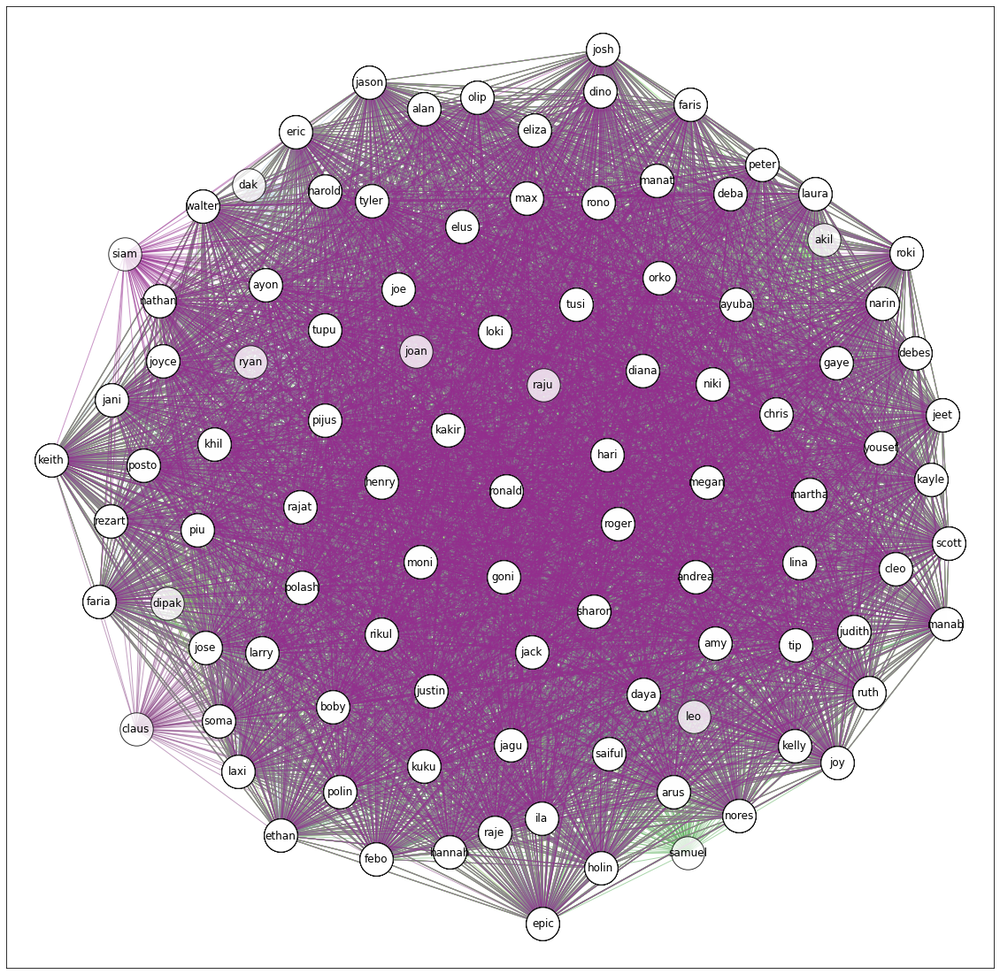

In [151]:
feedbackf = []
feedbackb = []
clusterdistances = []
feedbacknumber = []

fnum = 0

fclustersf = evalquery(weight_final)
clusterdist = Fmeasure(fclustersf)

clusterdistances.append(clusterdist)
feedbacknumber.append(fnum)

print(clusterdistances)

[[1.   0.86 0.8  ... 0.87 0.6  0.87]
 [0.86 1.   0.77 ... 0.58 0.7  0.87]
 [0.8  0.77 1.   ... 0.71 0.71 0.63]
 ...
 [0.87 0.58 0.71 ... 1.   0.76 0.58]
 [0.6  0.7  0.71 ... 0.76 1.   0.68]
 [0.87 0.87 0.63 ... 0.58 0.68 1.  ]]
Cluster  0 :  ['ayon', 'posto', 'chris', 'ethan', 'rezart', 'elus', 'walter', 'kelly', 'jason', 'manab', 'megan', 'joe', 'sharon', 'polash', 'rajat', 'josh', 'henry', 'khil', 'piu', 'roki', 'tip', 'keith', 'gaye', 'pijus', 'orko', 'faria', 'peter', 'alan', 'febo', 'justin', 'diana', 'harold', 'ruth', 'dino', 'manat', 'andrea', 'kayle', 'jani', 'max', 'jose', 'nathan', 'debes', 'soma', 'rikul', 'goni', 'joyce', 'daya', 'judith', 'scott', 'holin', 'laura', 'cleo', 'eric', 'tusi', 'arus', 'raje', 'epic', 'tupu', 'jeet', 'moni', 'tyler', 'lina', 'boby', 'loki', 'ayuba', 'yousef', 'faris', 'martha', 'hannah', 'rono', 'eliza', 'jagu', 'nores', 'narin', 'kakir', 'roger', 'deba', 'laxi', 'hari', 'larry', 'niki', 'ila', 'polin', 'jack', 'ronald', 'joy', 'amy', 'kuku', 'o

person name: keith
Cluster number: 9
['ayon', 'posto', 'chris', 'ethan', 'rezart', 'elus', 'walter', 'kelly', 'jason', 'manab', 'megan', 'joe', 'sharon', 'polash', 'rajat', 'josh', 'henry', 'khil', 'piu', 'roki', 'tip', 'keith', 'gaye', 'pijus', 'orko', 'faria', 'peter', 'alan', 'febo', 'justin', 'diana', 'harold', 'ruth', 'dino', 'manat', 'andrea', 'kayle', 'jani', 'max', 'jose', 'nathan', 'debes', 'soma', 'rikul', 'goni', 'joyce', 'daya', 'judith', 'scott', 'holin', 'laura', 'cleo', 'eric', 'tusi', 'arus', 'raje', 'epic', 'tupu', 'jeet', 'moni', 'tyler', 'lina', 'boby', 'loki', 'ayuba', 'yousef', 'faris', 'martha', 'hannah', 'rono', 'eliza', 'jagu', 'nores', 'narin', 'kakir', 'roger', 'deba', 'laxi', 'hari', 'larry', 'niki', 'ila', 'polin', 'jack', 'ronald', 'joy', 'amy', 'kuku', 'olip', 'siam']
[1, 64, 19, 39, 11, 56, 41, 38, 21, 98, 42, 3, 27, 13, 16, 84, 36, 69, 57, 78, 53, 45, 81, 62, 52, 66, 18, 2, 71, 26, 5, 44, 31, 75, 58, 46, 9, 94, 17, 34, 37, 65, 88, 83, 76, 35, 74, 43, 28,

Cluster  1 :  ['ayon', 'posto', 'chris', 'ethan', 'rezart', 'elus', 'walter', 'kelly', 'jason', 'manab', 'megan', 'joe', 'sharon', 'polash', 'rajat', 'josh', 'henry', 'khil', 'piu', 'roki', 'tip', 'gaye', 'pijus', 'justin', 'orko', 'faria', 'peter', 'alan', 'febo', 'diana', 'harold', 'ruth', 'manat', 'andrea', 'kayle', 'jani', 'max', 'jose', 'debes', 'nathan', 'soma', 'rikul', 'goni', 'joyce', 'daya', 'judith', 'scott', 'holin', 'laura', 'cleo', 'eric', 'tusi', 'arus', 'raje', 'epic', 'tupu', 'jeet', 'tyler', 'lina', 'boby', 'loki', 'ayuba', 'yousef', 'faris', 'martha', 'moni', 'hannah', 'rono', 'eliza', 'jagu', 'nores', 'narin', 'kakir', 'roger', 'deba', 'laxi', 'hari', 'larry', 'niki', 'ila', 'jack', 'amy', 'polin', 'ronald', 'joy', 'kuku', 'olip', 'saiful', 'dino', 'samuel']
Cluster  2 :  ['ayon', 'posto', 'chris', 'ethan', 'rezart', 'elus', 'walter', 'kelly', 'jason', 'manab', 'megan', 'joe', 'sharon', 'polash', 'rajat', 'josh', 'henry', 'khil', 'piu', 'roki', 'tip', 'gaye', 'pijus

Cluster  12 :  ['ayon', 'posto', 'chris', 'ethan', 'rezart', 'elus', 'walter', 'kelly', 'jason', 'manab', 'megan', 'joe', 'sharon', 'polash', 'rajat', 'josh', 'henry', 'khil', 'piu', 'roki', 'tip', 'gaye', 'pijus', 'justin', 'orko', 'faria', 'peter', 'alan', 'febo', 'diana', 'harold', 'ruth', 'manat', 'andrea', 'kayle', 'jani', 'max', 'jose', 'debes', 'nathan', 'soma', 'rikul', 'goni', 'joyce', 'daya', 'judith', 'scott', 'holin', 'laura', 'cleo', 'eric', 'tusi', 'arus', 'raje', 'epic', 'tupu', 'jeet', 'tyler', 'lina', 'boby', 'loki', 'ayuba', 'yousef', 'faris', 'martha', 'moni', 'hannah', 'rono', 'eliza', 'jagu', 'nores', 'narin', 'kakir', 'roger', 'deba', 'laxi', 'hari', 'larry', 'niki', 'ila', 'jack', 'amy', 'polin', 'ronald', 'joy', 'kuku', 'olip', 'saiful', 'keith', 'raju']
Cluster  13 :  ['ayon', 'posto', 'chris', 'ethan', 'rezart', 'elus', 'walter', 'kelly', 'jason', 'manab', 'megan', 'joe', 'sharon', 'polash', 'rajat', 'josh', 'henry', 'khil', 'piu', 'roki', 'tip', 'gaye', 'piju

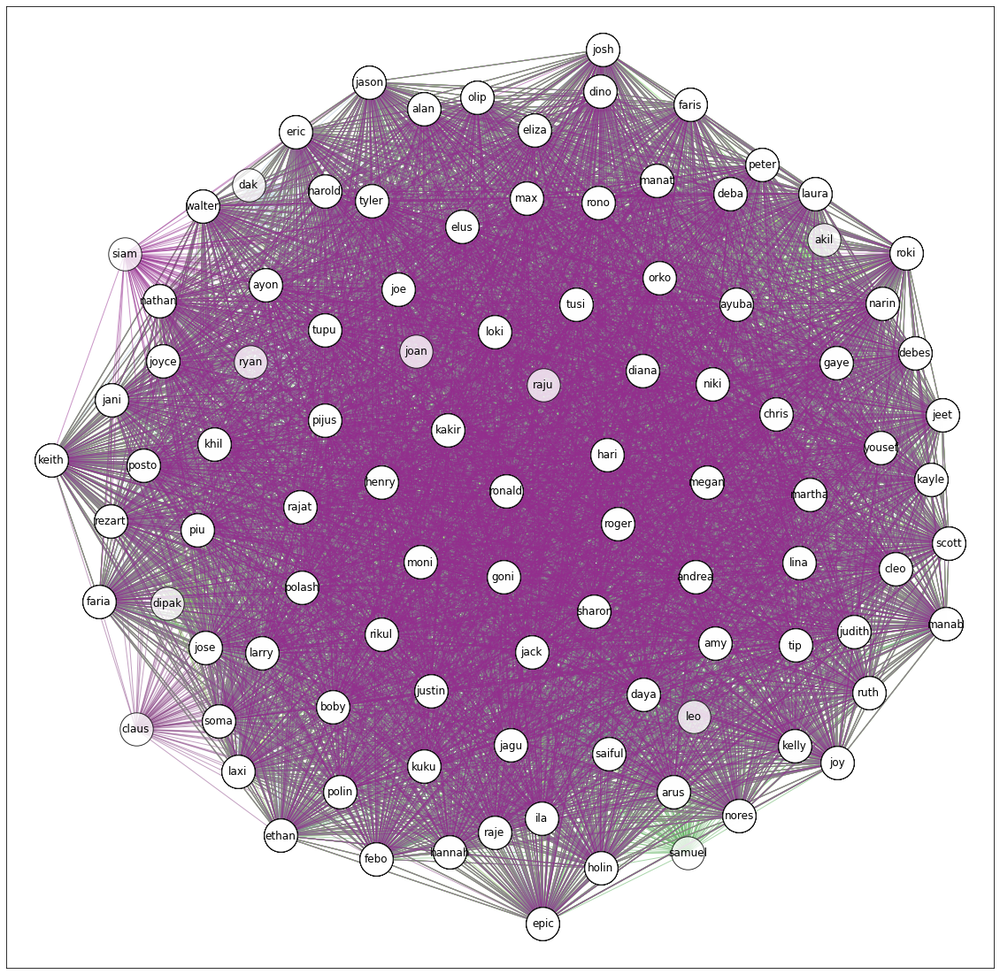

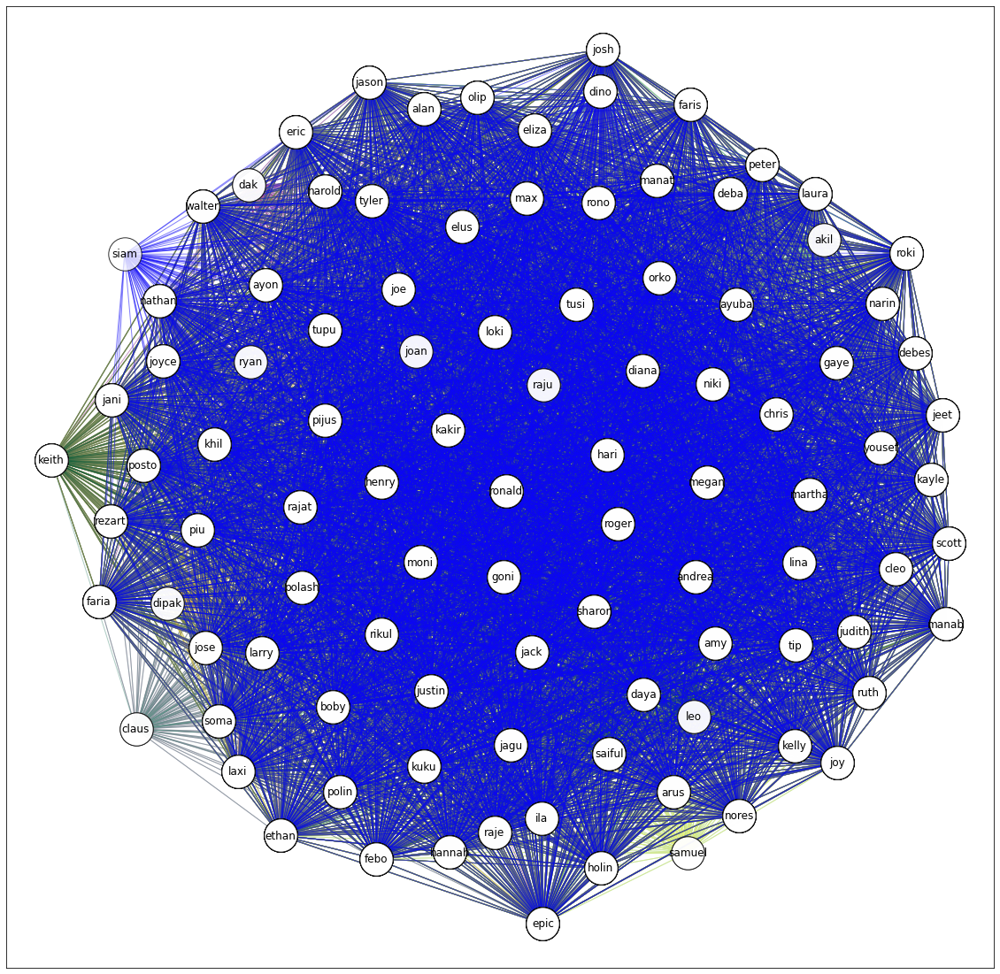

In [152]:
import ctypes

fclustersf = evalquery(weight_final)

#prec,recl,fmeasure = Fmeasure(fclustersf)
print(clusterdistances)

print("Cluster Distance: ",clusterdist)

print("1. Feedback (1)\n2. Feedback (2)")

#choice = int(input())
choice = 2

feedback = []

possibility = 1
    
if choice == 1:
        
    for sw in range(0,2):
        feedback.append(input('person name: '))
            
    s1,s2,weight_temp = feedback_new(feedback)
        
    if weight_temp!=-1:
        if len(feedbackf)>0:
            print('Feedback print: ',feedbackf)
            if check_feedback(feedbackf,feedbackb,weight_temp)==0:
                possibility = 0
                ctypes.windll.user32.MessageBoxW(0, "Feedback is not possible to fulfill.", "Inconsistency")
                #print('feedback is not possible')

        if possibility == 1:
            weight_final = weight_temp
            fclustersf = evalquery(weight_final)
            nclusters = fclustersf
            
            fnum +=1
            
            #prec,recl,fmeasure = Fmeasure(nclusters)
            clusterdist = Fmeasure(nclusters)
            
            clusterdistances.append(clusterdist)
            
            feedbacknumber.append(fnum)
            
            print(clusterdist)
        
            feedbackf.append(s1)
            feedbackb.append(s2)
        
elif choice == 2:
    #print(nclusters)
    obj = input('person name: ')
    fcluster= int(input('Cluster number: '))

    d1,d2,weight_temp = fetchdata(obj, fcluster)
        
    if weight_temp!=-1:
        if len(feedbackf)>0:
            print('Feedback print: ',feedbackf)
            if check_feedback(feedbackf,feedbackb,weight_temp)==0:
                possibility = 0
                ctypes.windll.user32.MessageBoxW(0, "Feedback is not possible to fulfill.", "Inconsistency")
                #print('feedback is not possible')

        if possibility == 1:
            weight_final = weight_temp
            fclustersf = evalquery(weight_final)
            nclusters = fclustersf

        #feedbackf.append(d1)
        #feedbackb.append(d2)
    
    #print(feedback)

print(feedbackf)
print(feedbackb)

[0.0]
[0]
0.19


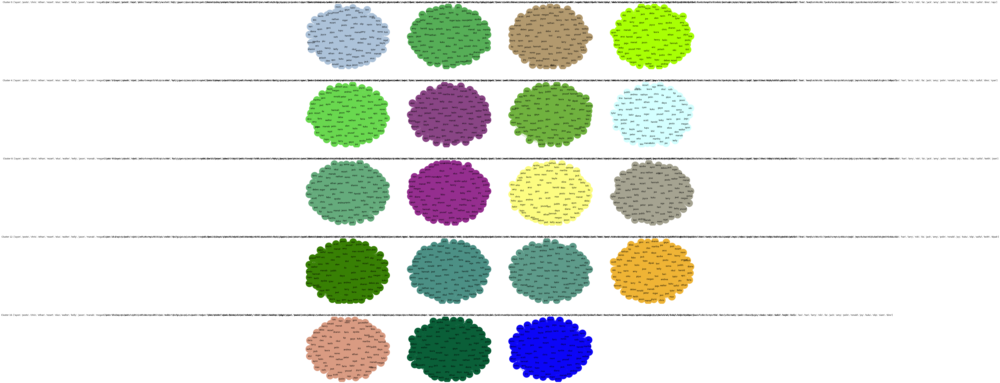

In [153]:
clustersprint(nclusters)

print(clusterdistances)
print(feedbacknumber)

print(weight_final)

#print(nclusters)

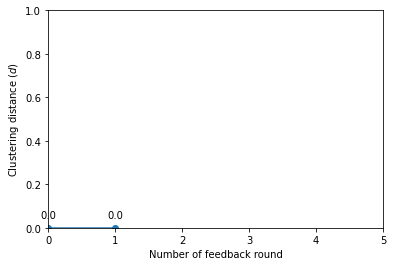

In [123]:
import matplotlib.pyplot as plt

plt.plot(feedbacknumber,clusterdistances,'-o')
#plt.axis([0, 5, 0, 1])
plt.xlabel('Number of feedback round')
plt.ylabel('Clustering distance ($\mathit{d}$)')

for x,y in zip(feedbacknumber,clusterdistances):

    #label = "{:.2f}".format(y)
    label = y

    plt.annotate(label, # this is the text
                 (x,y), # this is the point to label
                 textcoords="offset points", # how to position the text
                 xytext=(0,10), # distance from text to points (x,y)
                 ha='center')
plt.xlim(0,5)
plt.ylim(0,1)

plt.show()

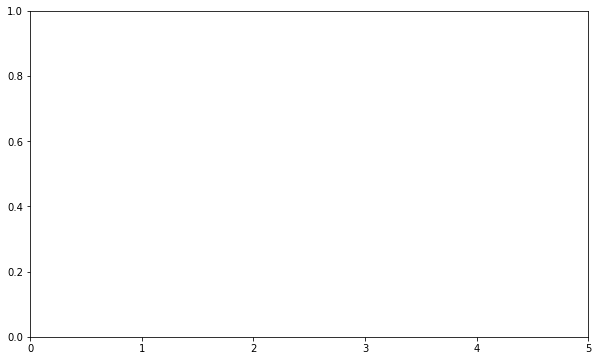

In [22]:
fig, ax8 = plt.subplots(figsize=(10, 6))
plt.axis([0, 5, 0, 1])
# Define x and y axes
ax8.plot(feedbacknumber, 
        clusterdistances,
        marker = 'o',
        color = 'cyan')

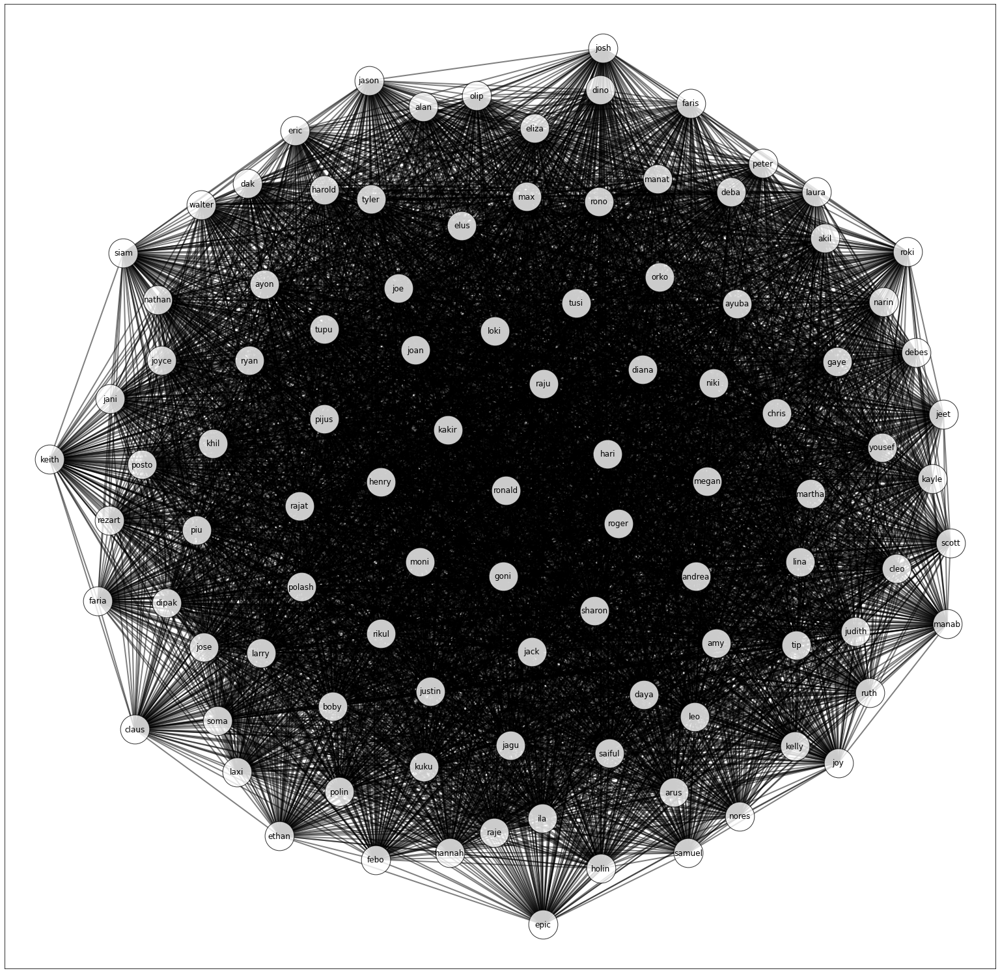

In [125]:
school = np.empty((dim, dim), dtype=float)

for i in range(0,dim):
    for j in range(i,dim):
            school[i,j] = 1

options = {"node_size": 2000, "alpha": 0.8}

fig, ax = plt.subplots(figsize=(60,60))

G = nx.from_numpy_matrix(school)

#mapping = {0: 'siam', 1: 'ayon', 2: 'alan', 3: 'joe', 4: 'eliza', 5: 'diana', 6: 'lina', 7: 'ayuba', 8: 'deba', 9: 'kayle'}

#mapping = {0: 'siam', 1: 'ayon', 2: 'alan', 3: 'joe', 4: 'eliza', 5: 'diana', 6: 'lina', 7: 'ayuba',
          #8: 'deba', 9: 'kayle', 10: 'raju', 11: 'rezart', 12: 'yousef', 13: 'polash', 14: 'rono', 15: 'saiful',
          #16: 'rajat', 17: 'max', 18: 'peter', 19: 'chris'}#, 4: 'eliza', 5: 'diana', 6: 'lina', 7: 'ayuba'}

G = nx.relabel_nodes(G, mapping)

#fpos = {'siam': ([1.        , 0.32865437]), 'ayon': ([-0.67850764, -0.0710287 ]), 
        #'alan': ([-0.24670983, -0.93539293]), 'joe': ([ 0.63752717, -0.39128019]), 
        #'eliza': ([0.07969461, 0.36363017]), 'diana': ([-0.7920043 ,  0.70541728])}

#pos = nx.spring_layout(G)
#pos = fpos

plt.subplot(221)
weights = nx.get_edge_attributes(G, "weight")
nx.draw_networkx_nodes(G, pos, node_color='white', edgecolors='black', **options)
nx.draw_networkx_edges(G, pos, width=2, alpha=0.5)
nx.draw_networkx_labels(G, pos)
#nx.draw(G, pos, with_labels=True, node_color = 'silver', node_size=1600)
#nx.draw_networkx_edge_labels(G, pos, edge_labels=weights)
#plt.title('high_school')

plt.show()

In [24]:
nx.draw(G3)

NameError: name 'G3' is not defined

[[1.     0.6006 0.51   ... 0.5766 0.4012 0.7656]
 [0.6006 1.     0.6384 ... 0.4032 0.5244 0.693 ]
 [0.51   0.6384 1.     ... 0.6204 0.6534 0.4453]
 ...
 [0.5766 0.4032 0.6204 ... 1.     0.5928 0.4235]
 [0.4012 0.5244 0.6534 ... 0.5928 1.     0.6014]
 [0.7656 0.693  0.4453 ... 0.4235 0.6014 1.    ]]
[[-0.          0.50982612  0.67334455 ...  0.55060649  0.91329522
   0.26709544]
 [ 0.50982612 -0.          0.44879023 ...  0.90832256  0.64550053
   0.36672528]
 [ 0.67334455  0.44879023 -0.         ...  0.47739085  0.42556578
   0.80900707]
 ...
 [ 0.55060649  0.90832256  0.47739085 ... -0.          0.52289821
   0.85920176]
 [ 0.91329522  0.64550053  0.42556578 ...  0.52289821 -0.
   0.50849501]
 [ 0.26709544  0.36672528  0.80900707 ...  0.85920176  0.50849501
  -0.        ]]
[0.50982612 0.67334455 0.46537436 ... 0.52289821 0.85920176 0.50849501]


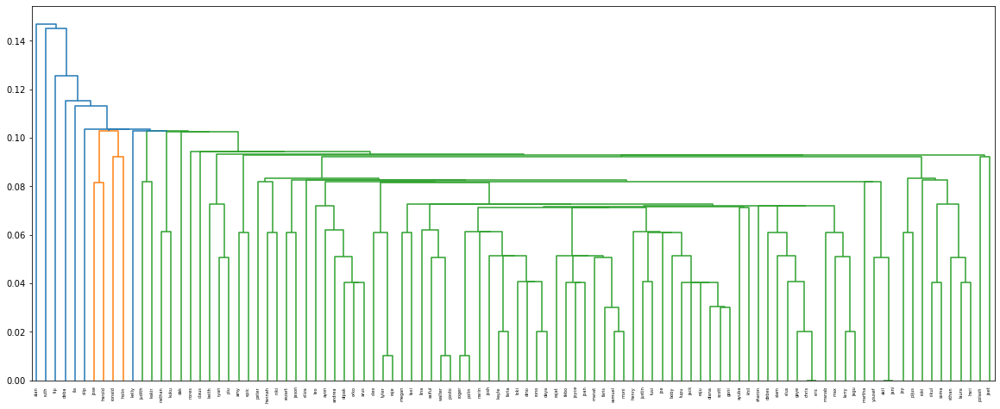

In [126]:
import numpy as np
from scipy.cluster.hierarchy import dendrogram, linkage, single
from scipy.spatial.distance import pdist, squareform

#S = np.array([[1     , 0.83   , 0.54   , 0.9    , 0.62   , 0.68   , 0.77   , 0.36   , 0.48   , 0.41],
#[0.83   , 1      ,0.98    , 0.72   , 0.59   , 0.26   , 0.35   , 0.42   , 0.39   , 0.2],
#[0.54   , 0.98   , 1      , 0.55   , 0.61   , 0.94   , 0.7    , 0.67   , 0.63   , 0.41],
#[0.9    , 0.72   , 0.55   , 1      , 0.76   , 0.18   , 0.48   , 0.22   , 0.15   , 0.42],
#[0.62   , 0.59   , 0.61   , 0.76   , 1      , 0.27   , 0.19   , 0.43   , 0.33   , 0.1],
#[0.68   , 0.26   , 0.94   , 0.18   , 0.27   , 1      , 0.8    , 0.43   , 0.37   , 0.48],
#[0.77   , 0.35   , 0.7    , 0.48   , 0.19   , 0.8    , 1      , 0.3    , 0.16   , 0.29],
#[0.36   , 0.42   , 0.67   , 0.22   , 0.43   , 0.43   , 0.3    , 1      , 0.98   , 0.35], 
#[0.48   , 0.39   , 0.63   , 0.15   , 0.33   , 0.37   , 0.16   , 0.98   , 1      , 0.69],
#[0.41   , 0.2    , 0.41   , 0.42   , 0.1    , 0.48   , 0.29   , 0.35   , 0.69   , 1]])

#S = np.array([[1.,   0.96, 0.01,   0.01,   0.4,  0.01],
 #[0.96, 1.,   0.01,   0.01,   0.01,   0.62],
 #[0.01,   0.01,   1.,   0.64, 0.01,   0.58],
 #[0.01,   0.01,   0.64, 1.,   0.01,   0.61],
 #[0.4,  0.01,   0.01,   0.01,   1.,   0.01  ],
 #[0.01,   0.62, 0.58, 0.61, 0.01,   1.  ]])

S = Smaj*Syear

for i in range(0,dim):
    for j in range(0,dim):
        if S[i,j]==0:
            S[i,j]=0.01

print(S)

dist = -np.log(S)

print(dist)

#nlabels = ['siam', 'ayon',  'alan',  'joe',  'eliza',  'diana',  'lina',  'ayuba',
          #'deba', 'kayle',  'raju',  'rezart',  'yousef',  'polash', 'rono',  'saiful',
          #'rajat', 'max',  'peter',  'chris',
          #'ryan', 'jason', 'ronald', 'eric', 'larry',
          #'amy', 'justin', 'sharon', 'scott', 'laura',
          #'samuel',  'ruth',  'jack',  'tyler',  'jose',
          #'joyce',  'henry',  'nathan',  'kelly',
          #'ethan','joan', 'walter', 'megan', 'judith',
          #'harold', 'keith', 'andrea', 'roger', 'hannah',
          #'martha', 'leo', 'joy', 'orko', 'tip',
          #'hari', 'cleo', 'elus', 'piu', 'manat',
          #'raje', 'claus', 'faris', 'pijus', 'nores',
          #'posto', 'debes', 'faria', 'ila', 'narin',
          #'khil', 'dak', 'febo', 'jagu', 'olip',
          #'daya', 'dino', 'goni', 'kuku', 'roki',
          #'boby', 'dipak', 'gaye', 'kakir', 'rikul',
          #'josh', 'arus', 'niki', 'loki', 'soma',
          #'jeet', 'akil', 'holin', 'laxi', 'tusi',
          #'jani', 'epic', 'polin', 'moni', 'manab',
          #'tupu']

nlabels = ['siam',  'ayon',  'alan',  'joe',  'eliza',  'diana',  'lina',  'ayuba',
          'deba',  'kayle',  'raju',  'rezart',  'yousef',  'polash',  'rono',  'saiful',
          'rajat',  'max',  'peter',  'chris',
          'ryan', 'jason', 'ronald', 'eric', 'larry',
          'amy', 'justin', 'sharon', 'scott', 'laura',
          'samuel',  'ruth',  'jack',  'tyler',  'jose',
          'joyce',  'henry',  'nathan',  'kelly',
          'ethan', 'joan', 'walter', 'megan', 'judith',
          'harold', 'keith', 'andrea', 'roger', 'hannah',
          'martha', 'leo', 'joy', 'orko', 'tip',
          'hari', 'cleo', 'elus', 'piu', 'manat',
          'raje', 'claus', 'faris', 'pijus', 'nores',
          'posto', 'debes', 'faria', 'ila', 'narin',
          'khil', 'dak', 'febo', 'jagu', 'olip',
          'daya', 'dino', 'goni', 'kuku', 'roki',
          'boby', 'dipak', 'gaye', 'kakir', 'rikul',
          'josh', 'arus', 'niki', 'loki', 'soma',
          'jeet', 'akil', 'holin', 'laxi', 'tusi',
          'jani', 'epic', 'polin', 'moni', 'manab',
          'tupu']

#nlabels = ['siam','ayon','alan','joe','eliza','diana']
#mapping = {'a': 'siam', 'b': 'ayon', 'c': 'alan', 'd': 'joe','e': 'eliza', 'f': 'diana'}

#print(distances)

#for k in range(distances.shape[1]):
#    for l in range(distances.shape[0]):
#        if k==l:
#            distances[k][l] = 0

#print(dist)

distances = squareform(dist)

print(distances)


fig, ax7 = plt.subplots(figsize=(20,8))

dendrogram = dendrogram(linkage(distances, method='single'), labels = nlabels)

In [127]:
from sklearn.cluster import AgglomerativeClustering
#fig, ax8 = plt.subplots(figsize=(8,8))

#nodes_net = ['a','b','c','d','e','f','g','h','i','j']

cluster = AgglomerativeClustering(affinity='precomputed', linkage='single', n_clusters=16)
cluster.fit_predict(dist)

print(cluster.labels_)

print(max(cluster.labels_))

clsf = []

for w in range(0,max(cluster.labels_)+1):
    jet = 0
    clstemp = []
    for q in cluster.labels_:
        if w == q:
            #print(q)
            #print(nlabels[jet])
            clstemp.append(nlabels[jet])
        jet += 1
    clsf.append(clstemp)

print(clsf)

[ 0  0 15  0  0  0  0  0  9  0  0  0  0  0  0  0  0  0  0  0  3  0  1  0
  0  0  0  0  0  0  0 11  0  0 10  0  0  2  8  0  0  0  0  4 10  3  0  0
  0  0  0  0  0  7  0  0  0  3  0  0 14  0  0 13  0  0  0  6  0  0 12  0
  0  5  0  0  0  2  0  0  0  0  4  0  0  0  0  0  0  0  0  1  0  0  0  0
  0  0  0  0]
15
[['siam', 'ayon', 'joe', 'eliza', 'diana', 'lina', 'ayuba', 'kayle', 'raju', 'rezart', 'yousef', 'polash', 'rono', 'saiful', 'rajat', 'max', 'peter', 'chris', 'jason', 'eric', 'larry', 'amy', 'justin', 'sharon', 'scott', 'laura', 'samuel', 'jack', 'tyler', 'joyce', 'henry', 'ethan', 'joan', 'walter', 'megan', 'andrea', 'roger', 'hannah', 'martha', 'leo', 'joy', 'orko', 'hari', 'cleo', 'elus', 'manat', 'raje', 'faris', 'pijus', 'posto', 'debes', 'faria', 'narin', 'khil', 'febo', 'jagu', 'daya', 'dino', 'goni', 'roki', 'boby', 'dipak', 'gaye', 'rikul', 'josh', 'arus', 'niki', 'loki', 'soma', 'jeet', 'akil', 'laxi', 'tusi', 'jani', 'epic', 'polin', 'moni', 'manab', 'tupu'], ['ronald', 

In [128]:
Y = np.empty((dim, dim), dtype=float)

for i in range(0,dim):
    for j in range(0,dim):
        if weight == 0:
            if S[i,j]<thr1*thr2:
                Y[i,j] = 0
            else:
                Y[i,j] = S[i,j]
        else:
            if S[i,j]<thrf:
                Y[i,j] = 0
            else:
                Y[i,j] = S[i,j]

G9 = nx.from_numpy_matrix(Y)

G9 = nx.relabel_nodes(G9, mapping)

edpt = [tuple(sorted(edh)) for edh in G9.edges]

print(edpt)


#list(subcount.values())[list(subcount.keys()).index(co_edge)]

[('siam', 'siam'), ('ayon', 'siam'), ('alan', 'siam'), ('joe', 'siam'), ('lina', 'siam'), ('ayuba', 'siam'), ('deba', 'siam'), ('kayle', 'siam'), ('rezart', 'siam'), ('polash', 'siam'), ('rono', 'siam'), ('rajat', 'siam'), ('chris', 'siam'), ('ronald', 'siam'), ('eric', 'siam'), ('larry', 'siam'), ('amy', 'siam'), ('jose', 'siam'), ('joyce', 'siam'), ('henry', 'siam'), ('nathan', 'siam'), ('kelly', 'siam'), ('siam', 'walter'), ('megan', 'siam'), ('judith', 'siam'), ('harold', 'siam'), ('andrea', 'siam'), ('hannah', 'siam'), ('martha', 'siam'), ('joy', 'siam'), ('orko', 'siam'), ('siam', 'tip'), ('hari', 'siam'), ('cleo', 'siam'), ('elus', 'siam'), ('piu', 'siam'), ('manat', 'siam'), ('raje', 'siam'), ('posto', 'siam'), ('debes', 'siam'), ('faria', 'siam'), ('narin', 'siam'), ('khil', 'siam'), ('jagu', 'siam'), ('olip', 'siam'), ('daya', 'siam'), ('goni', 'siam'), ('boby', 'siam'), ('gaye', 'siam'), ('kakir', 'siam'), ('rikul', 'siam'), ('loki', 'siam'), ('jeet', 'siam'), ('holin', 'sia

Cluster  0 :  ['siam', 'ayon', 'joe', 'eliza', 'diana', 'lina', 'ayuba', 'kayle', 'raju', 'rezart', 'yousef', 'polash', 'rono', 'saiful', 'rajat', 'max', 'peter', 'chris', 'jason', 'eric', 'larry', 'amy', 'justin', 'sharon', 'scott', 'laura', 'samuel', 'jack', 'tyler', 'joyce', 'henry', 'ethan', 'joan', 'walter', 'megan', 'andrea', 'roger', 'hannah', 'martha', 'leo', 'joy', 'orko', 'hari', 'cleo', 'elus', 'manat', 'raje', 'faris', 'pijus', 'posto', 'debes', 'faria', 'narin', 'khil', 'febo', 'jagu', 'daya', 'dino', 'goni', 'roki', 'boby', 'dipak', 'gaye', 'rikul', 'josh', 'arus', 'niki', 'loki', 'soma', 'jeet', 'akil', 'laxi', 'tusi', 'jani', 'epic', 'polin', 'moni', 'manab', 'tupu']
[('eliza', 'megan'), ('manat', 'roger'), ('scott', 'tusi'), ('larry', 'roki'), ('orko', 'tusi'), ('amy', 'eliza'), ('joan', 'joy'), ('amy', 'peter'), ('pijus', 'rajat'), ('goni', 'polash'), ('leo', 'manab'), ('dino', 'elus'), ('leo', 'roger'), ('siam', 'walter'), ('raje', 'scott'), ('goni', 'laura'), ('joe'

Cluster  2 :  ['nathan', 'kuku']
[('kuku', 'nathan')]
Cluster  3 :  ['ryan', 'keith', 'piu']
[('keith', 'piu'), ('keith', 'ryan'), ('piu', 'ryan')]
Cluster  4 :  ['judith', 'kakir']
[('judith', 'kakir')]
Cluster  5 :  ['olip']
Cluster  6 :  ['ila']
Cluster  7 :  ['tip']
Cluster  8 :  ['kelly']
Cluster  9 :  ['deba']
Cluster  10 :  ['jose', 'harold']
[('harold', 'jose')]
Cluster  11 :  ['ruth']
Cluster  12 :  ['dak']
Cluster  13 :  ['nores']
Cluster  14 :  ['claus']
Cluster  15 :  ['alan']


{'siam': Text(-0.831612971808831, 0.5040774507966438, 'siam'),
 'ayon': Text(-0.5368022946729597, 0.43458074974468647, 'ayon'),
 'alan': Text(-0.20529513181447862, 0.8312662006486533, 'alan'),
 'joe': Text(-0.25761173961871753, 0.42468697740751293, 'joe'),
 'eliza': Text(0.027199442243652443, 0.7835309340563418, 'eliza'),
 'diana': Text(0.25304329010665755, 0.2425629449087671, 'diana'),
 'lina': Text(0.5813590395013992, -0.18784662792119877, 'lina'),
 'ayuba': Text(0.45001520365092956, 0.3906661016345936, 'ayuba'),
 'deba': Text(0.43720864180196084, 0.6406739583323436, 'deba'),
 'kayle': Text(0.8574810503121135, -0.001723063278861472, 'kayle'),
 'raju': Text(0.045612520756223844, 0.21139815849967633, 'raju'),
 'rezart': Text(-0.8610720940970282, -0.09435769920756074, 'rezart'),
 'yousef': Text(0.7522935476533646, 0.06885527389667748, 'yousef'),
 'polash': Text(-0.4599965532970484, -0.24356175052417808, 'polash'),
 'rono': Text(0.16133699224991463, 0.6193263986952708, 'rono'),
 'saiful'

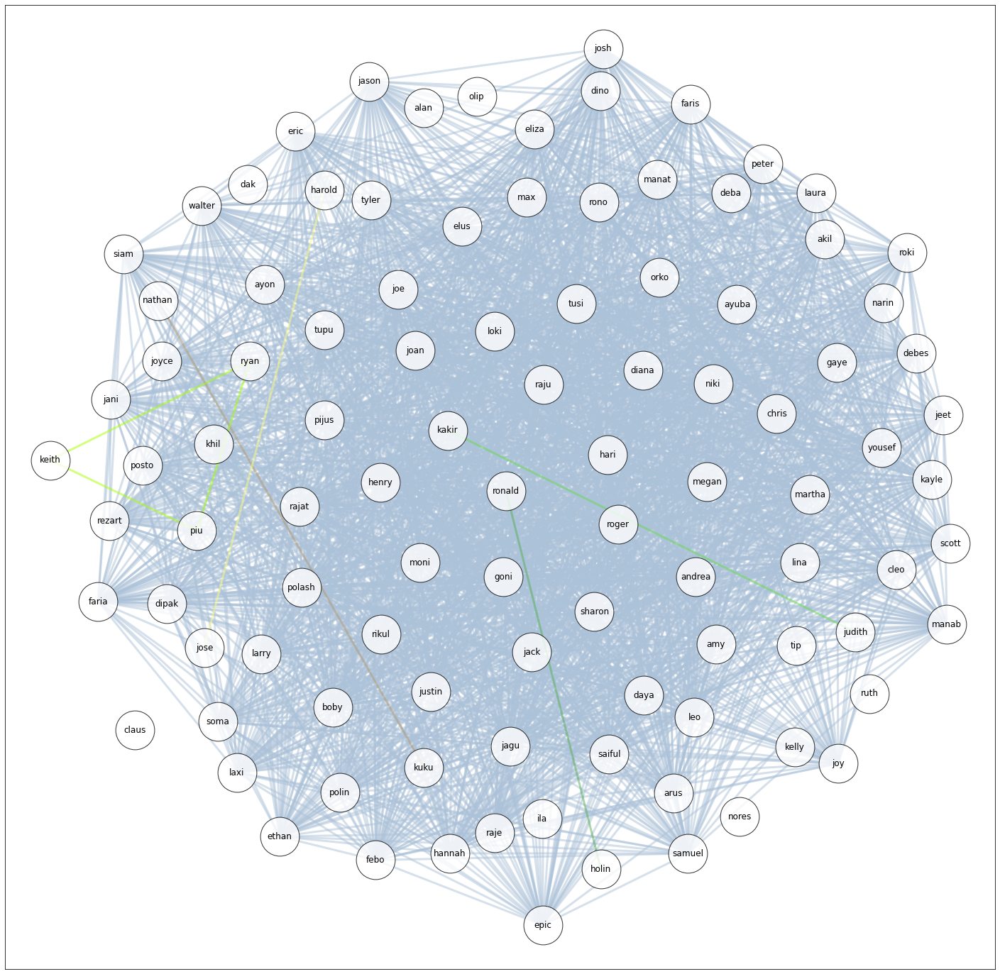

In [129]:
from collections import Counter

sublist = []
    
for edg in clsf:
    edg = sorted(edg)
    ed_sublist = list(combinations(edg,2))
    for edgsub in ed_sublist:
        sublist.append(edgsub)
        
subcount = Counter(sublist)

fig, ax1 = plt.subplots(figsize=(25,25))
    
######################################
    
#print(clusters)

options = {"node_size": 3000, "alpha": 0.8}

#pos = nx.spring_layout(G)

#nx.draw_networkx_labels(G,pos, font_size=18)

for i in range(0,len(clsf)):
    node_list = clsf[i]
    
    #print(node_list)
    
    ncolor = overlap[i]
        
    #print("Cluster ", i, ": ", node_list)
    #ncolor = list(mcolor.keys())[i]
        
    #print(list(mcolor.values())[i]+"Cluster ", i, ": ", node_list) 
    print("Cluster ", i, ": ", node_list)

    #nx.draw_networkx_nodes(G3, pos, nodelist=node_list, node_color=colornames[i], **options)
    nx.draw_networkx_nodes(G,pos, nodelist=node_list, node_color='white',edgecolors='black', **options)

    if len(node_list)>1:
        
        #gt = 1
        #t_list = []
        #n_list=[]
    
        #for mt in range(0,len(node_list)-1):
            #t_list.append(node_list[mt])
            #t_list.append(node_list[mt+1])
        
            #n_list.append(tuple(sorted(t_list)))
        
            #t_list = []
        
        #print(n_list)
        
        #edge_list = n_list

        
        node_list = sorted(node_list)
            
        edge_list = list(combinations(node_list,2))
        
        #print(edge_list)
        
        edge_list = list(set(edge_list) & set(edpt))
            
        print(edge_list)
            
        weight_edge = []
            
        for co_edge in edge_list:
                
            tempedge = 3
                
            rep_sub = list(subcount.values())[list(subcount.keys()).index(co_edge)]
                
            if rep_sub > 1:
                tempedge = (tempedge+1) * rep_sub +2
                weight_edge.append(tempedge)
                subcount[co_edge] = rep_sub-1
            else:
                weight_edge.append(tempedge)
                           
        nx.draw_networkx_edges(G,pos, edgelist=edge_list,
                               width=3, alpha=0.5, edge_color=ncolor)
nx.draw_networkx_labels(G, pos)

[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


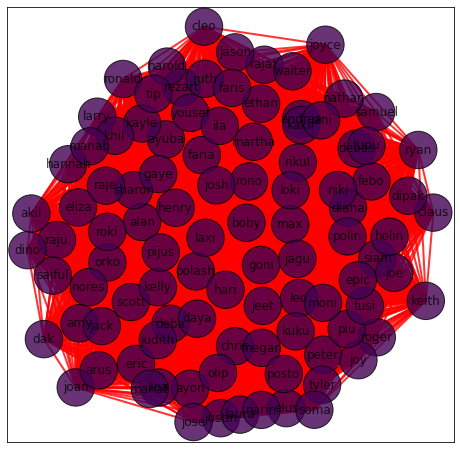

In [120]:
from sklearn.cluster import DBSCAN
from math import pi
import matplotlib.pyplot as plt

fig, ax3 = plt.subplots(figsize=(8,8))


#db = DBSCAN(eps=0.3, min_samples = 2, metric='precomputed')
db = DBSCAN(metric='precomputed')
db.fit(dist)

#get labels
labels = db.labels_

print(labels)

nx.draw_networkx(G, pos, node_color = labels, with_labels=True, node_size=1400, alpha=0.8, edgecolors='black', width=2,
                 ax=ax3, edge_color='red')

In [121]:
clsf = []

for w in range(min(labels),max(labels)+1):
    jet = 0
    clstemp = []
    for q in labels:
        if w == q:
            #print(q)
            #print(nlabels[jet])
            clstemp.append(nlabels[jet])
        jet += 1
    clsf.append(clstemp)

print(clsf)

[['siam', 'ayon', 'alan', 'joe', 'eliza', 'diana', 'lina', 'ayuba', 'deba', 'kayle', 'raju', 'rezart', 'yousef', 'polash', 'rono', 'saiful', 'rajat', 'max', 'peter', 'chris', 'ryan', 'jason', 'ronald', 'eric', 'larry', 'amy', 'justin', 'sharon', 'scott', 'laura', 'samuel', 'ruth', 'jack', 'tyler', 'jose', 'joyce', 'henry', 'nathan', 'kelly', 'ethan', 'joan', 'walter', 'megan', 'judith', 'harold', 'keith', 'andrea', 'roger', 'hannah', 'martha', 'leo', 'joy', 'orko', 'tip', 'hari', 'cleo', 'elus', 'piu', 'manat', 'raje', 'claus', 'faris', 'pijus', 'nores', 'posto', 'debes', 'faria', 'ila', 'narin', 'khil', 'dak', 'febo', 'jagu', 'olip', 'daya', 'dino', 'goni', 'kuku', 'roki', 'boby', 'dipak', 'gaye', 'kakir', 'rikul', 'josh', 'arus', 'niki', 'loki', 'soma', 'jeet', 'akil', 'holin', 'laxi', 'tusi', 'jani', 'epic', 'polin', 'moni', 'manab', 'tupu']]


Cluster  0 :  ['siam', 'ayon', 'alan', 'joe', 'eliza', 'diana', 'lina', 'ayuba', 'deba', 'kayle', 'raju', 'rezart', 'yousef', 'polash', 'rono', 'saiful', 'rajat', 'max', 'peter', 'chris', 'ryan', 'jason', 'ronald', 'eric', 'larry', 'amy', 'justin', 'sharon', 'scott', 'laura', 'samuel', 'ruth', 'jack', 'tyler', 'jose', 'joyce', 'henry', 'nathan', 'kelly', 'ethan', 'joan', 'walter', 'megan', 'judith', 'harold', 'keith', 'andrea', 'roger', 'hannah', 'martha', 'leo', 'joy', 'orko', 'tip', 'hari', 'cleo', 'elus', 'piu', 'manat', 'raje', 'claus', 'faris', 'pijus', 'nores', 'posto', 'debes', 'faria', 'ila', 'narin', 'khil', 'dak', 'febo', 'jagu', 'olip', 'daya', 'dino', 'goni', 'kuku', 'roki', 'boby', 'dipak', 'gaye', 'kakir', 'rikul', 'josh', 'arus', 'niki', 'loki', 'soma', 'jeet', 'akil', 'holin', 'laxi', 'tusi', 'jani', 'epic', 'polin', 'moni', 'manab', 'tupu']
[('alan', 'diana'), ('akil', 'olip'), ('peter', 'ruth'), ('joe', 'moni'), ('diana', 'kayle'), ('andrea', 'rezart'), ('claus', 'wal

{'siam': Text(0.7245630998931291, -0.10507568865478069, 'siam'),
 'ayon': Text(-0.19657050286359823, -0.7046538655389807, 'ayon'),
 'alan': Text(-0.43262154664221886, 0.06367780012004096, 'alan'),
 'joe': Text(0.8076091188890718, -0.17036221033114637, 'joe'),
 'eliza': Text(-0.7473854597568277, 0.13073358680535632, 'eliza'),
 'diana': Text(0.5807879597745549, 0.12921553129608326, 'diana'),
 'lina': Text(-0.3491966066631686, -0.6991086395884879, 'lina'),
 'ayuba': Text(-0.31514460332124566, 0.4446371323079074, 'ayuba'),
 'deba': Text(-0.29250984127480867, -0.40534991164966505, 'deba'),
 'kayle': Text(-0.4324282749913776, 0.5179731881353915, 'kayle'),
 'raju': Text(-0.8510477964970322, -0.01901407276205852, 'raju'),
 'rezart': Text(-0.2384420791540851, 0.6843393916724955, 'rezart'),
 'yousef': Text(-0.1957026140935612, 0.5665158947214225, 'yousef'),
 'polash': Text(-0.16798109165578515, -0.1638596263731885, 'polash'),
 'rono': Text(0.09332247893038097, 0.2505741328582143, 'rono'),
 'saif

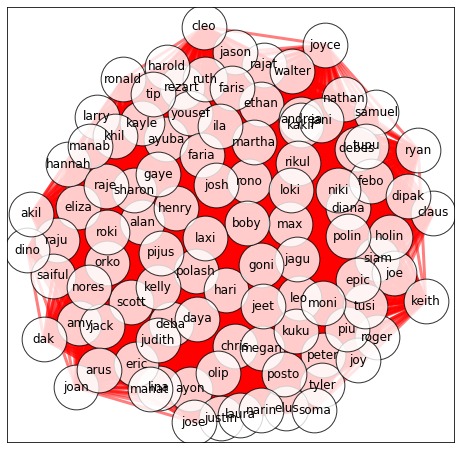

In [122]:
from collections import Counter

sublist = []
    
for edg in clsf:
    edg = sorted(edg)
    ed_sublist = list(combinations(edg,2))
    for edgsub in ed_sublist:
        sublist.append(edgsub)
        
subcount = Counter(sublist)

fig, ax1 = plt.subplots(figsize=(8,8))
    
######################################
    
#print(clusters)

#options = {"node_size": 800, "alpha": 0.8}

#pos = nx.spring_layout(G)

#nx.draw_networkx_labels(G,pos, font_size=18)

for i in range(0,len(clsf)):
    node_list = clsf[i]
    
    #print(node_list)
        
    #print("Cluster ", i, ": ", node_list)
    ncolor = list(mcolor.keys())[i]
        
    print(list(mcolor.values())[i]+"Cluster ", i, ": ", node_list) 

    #nx.draw_networkx_nodes(G3, pos, nodelist=node_list, node_color=colornames[i], **options)
    nx.draw_networkx_nodes(G,pos, nodelist=node_list, node_color='white',edgecolors='black', **options)

    if len(node_list)>1:
        
        #gt = 1
        #t_list = []
        #n_list=[]
    
        #for mt in range(0,len(node_list)-1):
            #t_list.append(node_list[mt])
            #t_list.append(node_list[mt+1])
        
            #n_list.append(tuple(sorted(t_list)))
        
            #t_list = []
        
        #print(n_list)
        
        #edge_list = n_list

        
        node_list = sorted(node_list)
            
        edge_list = list(combinations(node_list,2))
        
        #print(edge_list)
        
        edge_list = list(set(edge_list) & set(edpt))
            
        print(edge_list)
            
        weight_edge = []
            
        for co_edge in edge_list:
                
            tempedge = 3
                
            rep_sub = list(subcount.values())[list(subcount.keys()).index(co_edge)]
                
            if rep_sub > 1:
                tempedge = (tempedge+1) * rep_sub +2
                weight_edge.append(tempedge)
                subcount[co_edge] = rep_sub-1
            else:
                weight_edge.append(tempedge)
                           
        nx.draw_networkx_edges(G,pos, edgelist=edge_list,
                               width=3, alpha=0.5, edge_color=ncolor)
nx.draw_networkx_labels(G, pos)

In [130]:
from sklearn_extra.cluster import KMedoids

kmedoids = KMedoids(n_clusters=16, random_state=0).fit(dist)
kmedoids.labels_

clsf = []

for w in range(0,max(kmedoids.labels_)+1):
    jet = 0
    clstemp = []
    for q in kmedoids.labels_:
        if w == q:
            #print(q)
            #print(nlabels[jet])
            clstemp.append(nlabels[jet])
        jet += 1
    clsf.append(clstemp)

print(clsf)

[['scott', 'manat', 'raje', 'febo', 'olip', 'tusi'], ['eliza', 'lina', 'jose', 'henry', 'kelly', 'judith', 'khil', 'dino', 'goni', 'arus'], ['sharon', 'andrea', 'hannah', 'pijus', 'daya', 'kuku'], ['amy', 'laura', 'joyce', 'orko', 'rikul', 'epic'], ['joe', 'diana', 'polash', 'peter', 'jack', 'walter', 'debes', 'jagu', 'roki', 'boby', 'gaye', 'manab'], ['ayon', 'ronald', 'justin', 'nathan', 'megan', 'elus', 'tupu'], ['rajat', 'josh', 'jani', 'moni'], ['chris', 'faria', 'loki', 'jeet'], ['saiful', 'larry', 'joy', 'narin', 'holin'], ['deba', 'rono', 'martha'], ['siam', 'raju', 'ryan', 'samuel', 'joan', 'leo', 'claus', 'dak', 'dipak', 'akil'], ['rezart', 'max', 'jason', 'faris', 'nores', 'posto', 'kakir', 'niki', 'laxi'], ['alan', 'kayle', 'soma', 'polin'], ['ayuba', 'eric', 'harold', 'tip', 'cleo', 'ila'], ['tyler', 'ethan', 'keith', 'roger', 'hari'], ['yousef', 'ruth', 'piu']]


Cluster  0 :  ['scott', 'manat', 'raje', 'febo', 'olip', 'tusi']
[('febo', 'scott'), ('febo', 'olip'), ('febo', 'manat'), ('raje', 'tusi'), ('febo', 'raje'), ('raje', 'scott'), ('scott', 'tusi'), ('manat', 'olip'), ('olip', 'scott'), ('manat', 'raje'), ('olip', 'raje')]
Cluster  1 :  ['eliza', 'lina', 'jose', 'henry', 'kelly', 'judith', 'khil', 'dino', 'goni', 'arus']
[('judith', 'kelly'), ('henry', 'kelly'), ('dino', 'henry'), ('kelly', 'lina'), ('goni', 'kelly'), ('dino', 'eliza'), ('eliza', 'henry'), ('goni', 'jose'), ('henry', 'jose'), ('dino', 'judith'), ('eliza', 'judith'), ('arus', 'khil'), ('jose', 'lina'), ('arus', 'dino'), ('dino', 'khil'), ('eliza', 'khil'), ('arus', 'goni'), ('goni', 'lina'), ('kelly', 'khil'), ('eliza', 'goni'), ('jose', 'judith'), ('dino', 'kelly'), ('goni', 'henry'), ('eliza', 'kelly'), ('dino', 'jose'), ('eliza', 'jose'), ('goni', 'judith'), ('henry', 'judith'), ('jose', 'khil'), ('judith', 'khil'), ('goni', 'khil'), ('jose', 'kelly'), ('dino', 'lina'),

{'siam': Text(-0.831612971808831, 0.5040774507966438, 'siam'),
 'ayon': Text(-0.5368022946729597, 0.43458074974468647, 'ayon'),
 'alan': Text(-0.20529513181447862, 0.8312662006486533, 'alan'),
 'joe': Text(-0.25761173961871753, 0.42468697740751293, 'joe'),
 'eliza': Text(0.027199442243652443, 0.7835309340563418, 'eliza'),
 'diana': Text(0.25304329010665755, 0.2425629449087671, 'diana'),
 'lina': Text(0.5813590395013992, -0.18784662792119877, 'lina'),
 'ayuba': Text(0.45001520365092956, 0.3906661016345936, 'ayuba'),
 'deba': Text(0.43720864180196084, 0.6406739583323436, 'deba'),
 'kayle': Text(0.8574810503121135, -0.001723063278861472, 'kayle'),
 'raju': Text(0.045612520756223844, 0.21139815849967633, 'raju'),
 'rezart': Text(-0.8610720940970282, -0.09435769920756074, 'rezart'),
 'yousef': Text(0.7522935476533646, 0.06885527389667748, 'yousef'),
 'polash': Text(-0.4599965532970484, -0.24356175052417808, 'polash'),
 'rono': Text(0.16133699224991463, 0.6193263986952708, 'rono'),
 'saiful'

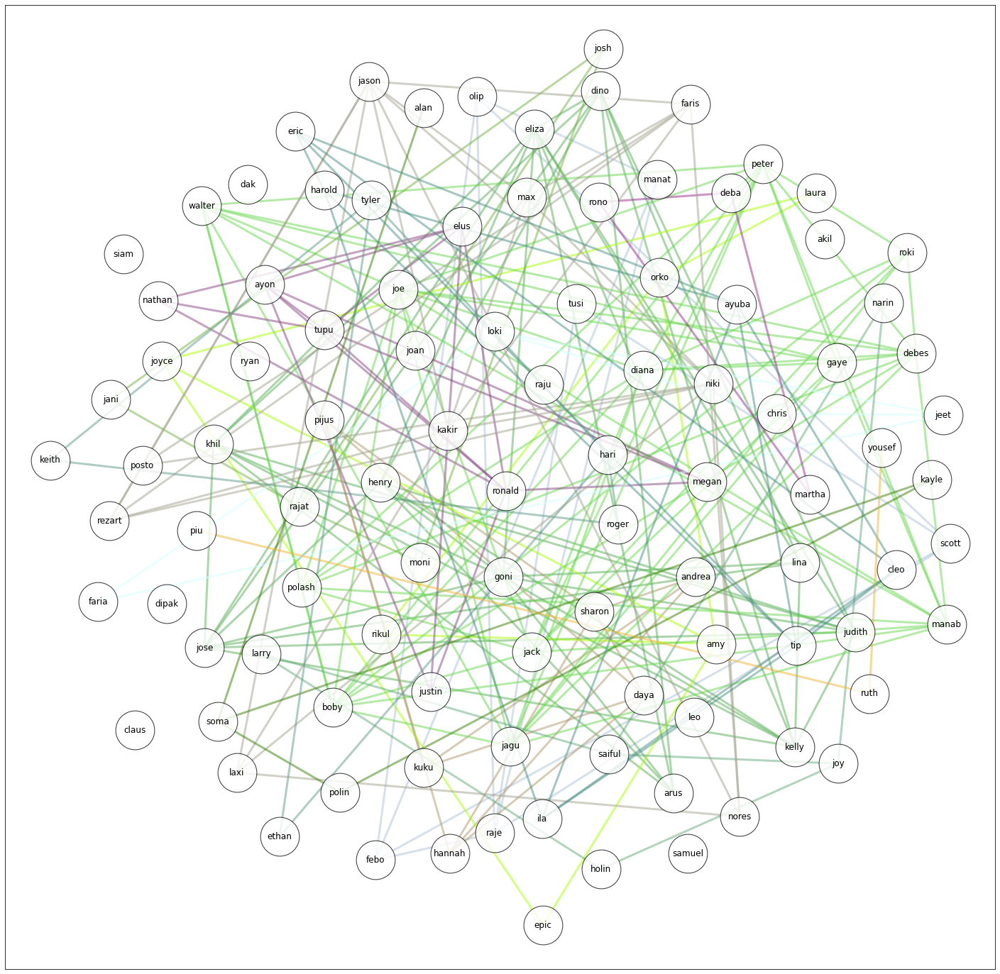

In [131]:
sublist = []
    
for edg in clsf:
    edg = sorted(edg)
    ed_sublist = list(combinations(edg,2))
    for edgsub in ed_sublist:
        sublist.append(edgsub)
        
subcount = Counter(sublist)

fig, ax1 = plt.subplots(figsize=(25,25))
    
######################################
    
#print(clusters)

options = {"node_size": 3000, "alpha": 0.8}

#pos = nx.spring_layout(G)

#nx.draw_networkx_labels(G,pos, font_size=18)

for i in range(0,len(clsf)):
    node_list = clsf[i]
    
    #print(node_list)
        
    ncolor = overlap[i]
        
    #print("Cluster ", i, ": ", node_list)
    #ncolor = list(mcolor.keys())[i]
        
    #print(list(mcolor.values())[i]+"Cluster ", i, ": ", node_list) 
    print("Cluster ", i, ": ", node_list)

    #nx.draw_networkx_nodes(G3, pos, nodelist=node_list, node_color=colornames[i], **options)
    nx.draw_networkx_nodes(G,pos, nodelist=node_list, node_color='white',edgecolors='black', **options)

    if len(node_list)>1:
        
        #gt = 1
        #t_list = []
        #n_list=[]
    
        #for mt in range(0,len(node_list)-1):
            #t_list.append(node_list[mt])
            #t_list.append(node_list[mt+1])
        
            #n_list.append(tuple(sorted(t_list)))
        
            #t_list = []
        
        #print(n_list)
        
        #edge_list = n_list

        
        node_list = sorted(node_list)
            
        edge_list = list(combinations(node_list,2))
        
        #print(edge_list)
        
        edge_list = list(set(edge_list) & set(edpt))
            
        print(edge_list)
            
        weight_edge = []
            
        for co_edge in edge_list:
                
            tempedge = 3
                
            rep_sub = list(subcount.values())[list(subcount.keys()).index(co_edge)]
                
            if rep_sub > 1:
                tempedge = (tempedge+1) * rep_sub +2
                weight_edge.append(tempedge)
                subcount[co_edge] = rep_sub-1
            else:
                weight_edge.append(tempedge)
                           
        nx.draw_networkx_edges(G,pos, edgelist=edge_list,
                               width=3, alpha=0.5, edge_color=ncolor)
nx.draw_networkx_labels(G, pos)